# Analysis in one notebook

Present all analysis used in the manuscript here. Including plots, DE anlysis, volcano plot, trajectory analysis, Adding unspliced counts.  

## Load library and define param

In [52]:
import scvelo as scv
import scanpy as sc
import numpy as np
import pandas as pd
import pyranges as pr
import subprocess

from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

scv.set_figure_params(dpi_save=300, vector_friendly=False)

In [53]:
# Load self maintained functions
# reload to make sure changes are reloaded
import de_enr
import plot_func
import venn
import run_string
from importlib import reload  
reload(de_enr)
reload(plot_func)
reload(venn)
reload(run_string)
from de_enr import *
from plot_func import *
from venn import *
from run_string import *

In [4]:
dotsize = 20
fontsize = 12
alpha = 1
work_dir = '../results/'
fig_dir = work_dir + 'plots/'
h5ad_dir = work_dir + 'h5ad/'
csv_dir = work_dir + 'csv/'
data_dir = '../data/'
submission_dir = '../submission/'

In [5]:
# This file will be changed, once previous notebook made
adata = scv.read(h5ad_dir + 'adata.ct.h5ad')

## Re-define cell type and clusters

Merge cell type and cluster annotation to minimize unnecessary information in figures

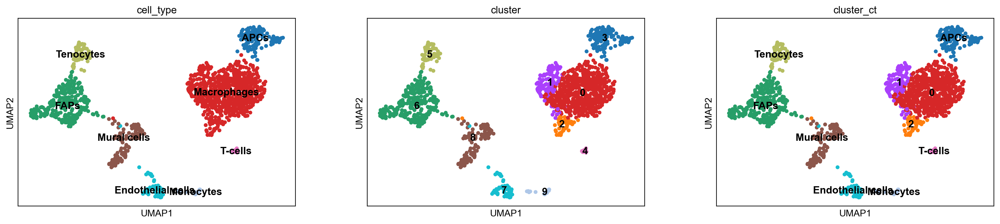

In [10]:
sc.pl.umap(adata, color=['cell_type', 'cluster', 'cluster_ct'], legend_loc='on data')

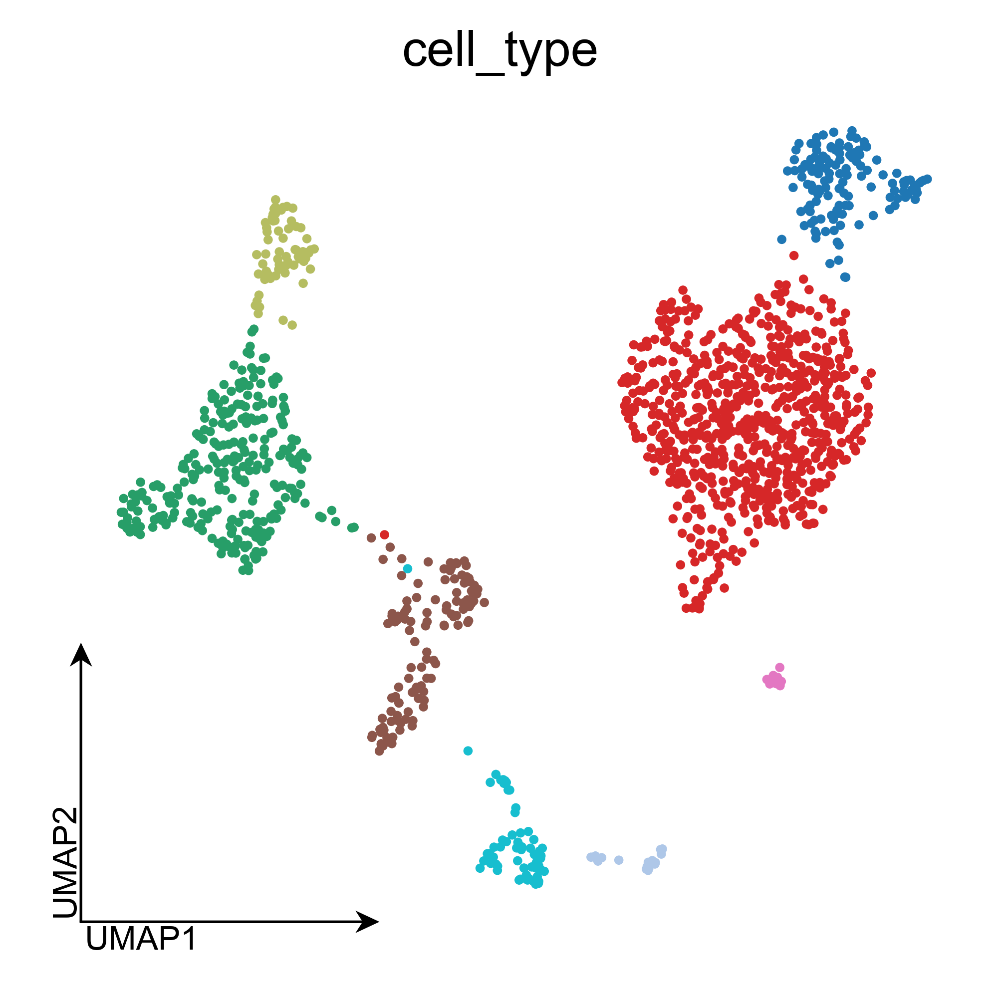

In [6]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata, 'cell_type', size=dotsize, alpha=alpha, fontsize=fontsize, fig_dir=fig_dir, legend_loc='upper_right')

In [8]:
adata_m2 = adata[adata.obs['cell_type'] == 'Macrophages']

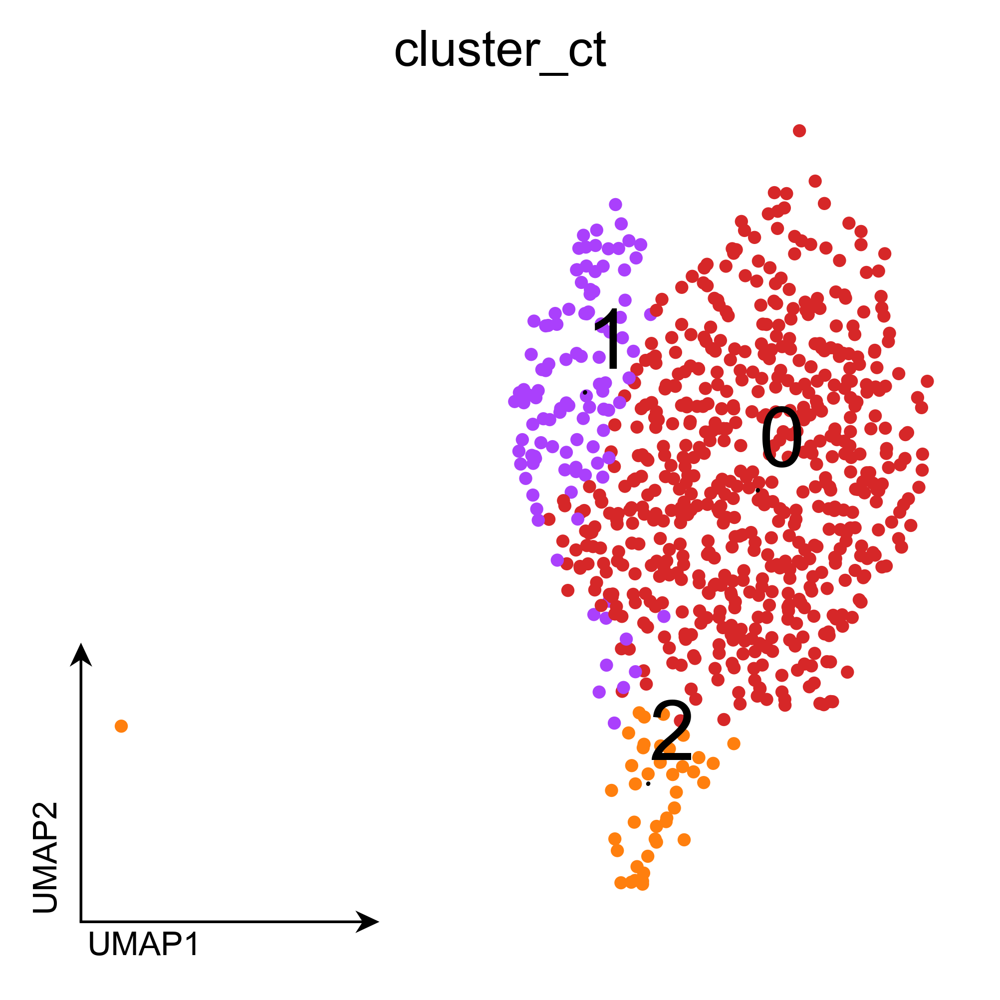

In [9]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata_m2, 'cluster_ct', size=40, fontsize=20, fig_dir=fig_dir)

In [10]:
adata.uns['cluster_colors']

array(['#d62728', '#aa40fc', '#ff7f0e', '#1f77b4', '#e377c2', '#b5bd61',
       '#279e68', '#17becf', '#8c564b', '#aec7e8'], dtype=object)

In [11]:
adata.uns['tdtomato_colors']

array(['#64BF73', '#E52320'], dtype=object)

In [12]:
adata.uns['tdtomato_colors'] = ['#64BF73', '#D81B60']

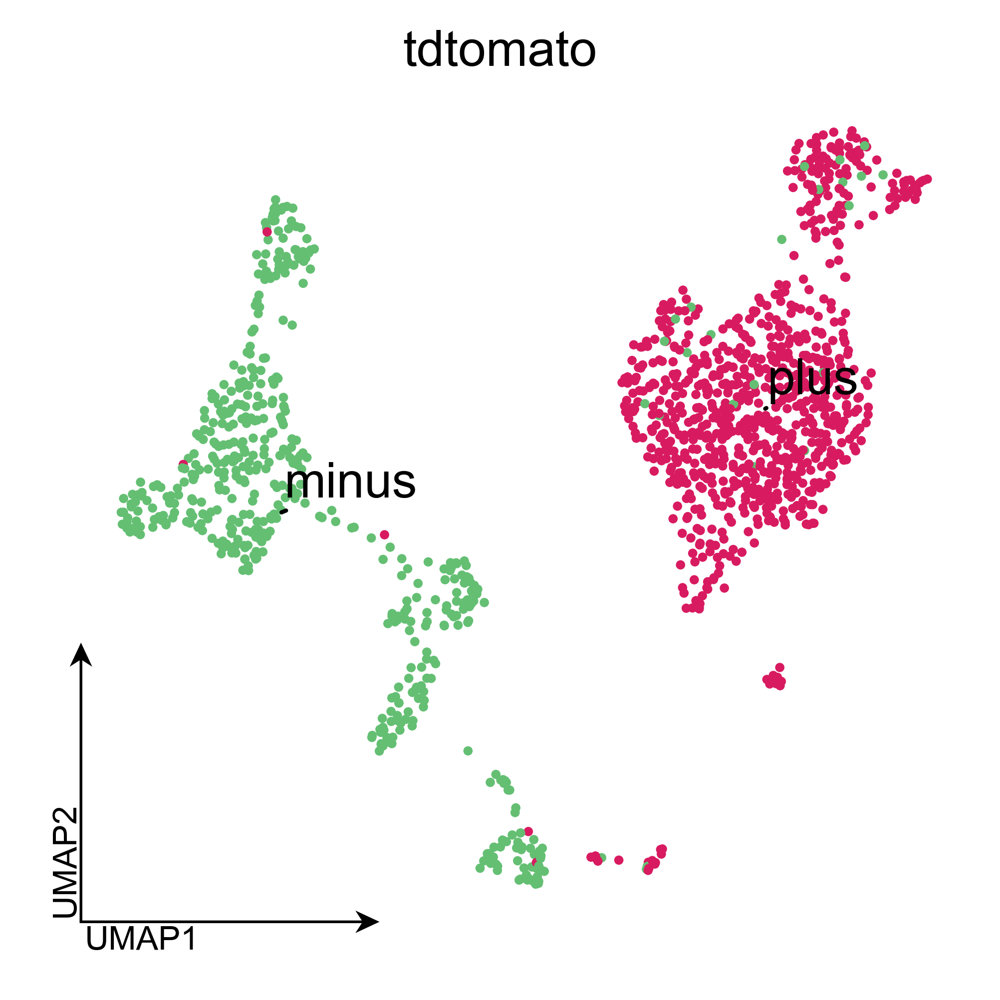

In [13]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata, 'tdtomato', size=dotsize, alpha=alpha, fontsize=fontsize, fig_dir=fig_dir)

Sort cells so that healthy are plotted on top with darker color

In [14]:
adata_sorted = adata[np.argsort(adata.obs['ischemia'], axis=1)]

In [15]:
adata_sorted.uns['ischemia_colors']

array(['#D56B12', '#B4B4B4'], dtype=object)

In [16]:
adata_sorted.uns['ischemia_colors'][1] = '#4d4d4d'#'#666666'

In [17]:
sizes = [10 if ischemia=='D21' else 20 for ischemia in adata_sorted.obs['ischemia']]

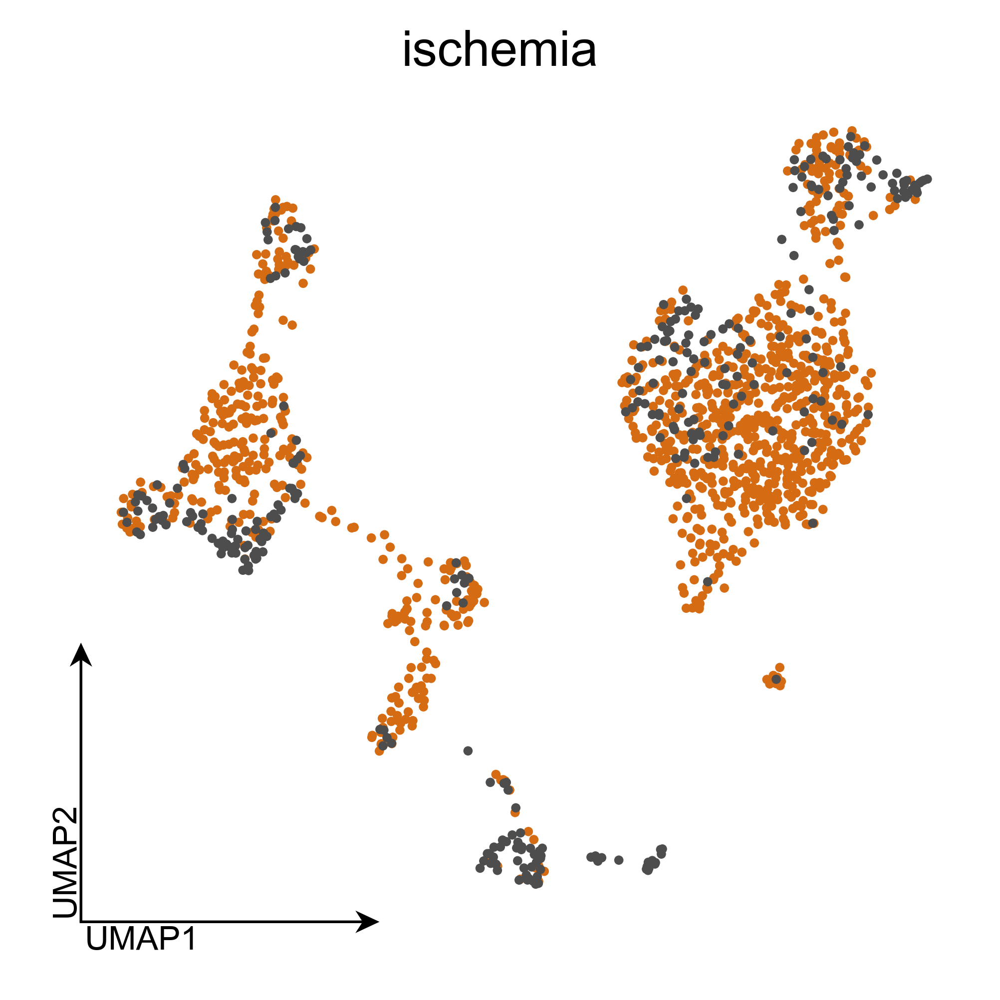

In [18]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata_sorted, 'ischemia', size=dotsize, alpha=alpha, fontsize=fontsize, legend_loc='upper_right', fig_dir=fig_dir)

Show D21 only since that's what's discussed in the paper? Problem is that since D21 is similar to cell type plots, this is somehow duplicated information. And poorly visualized. Plus there is too few healthy cells

In [83]:
adata_d21 = adata[adata.obs['ischemia'] == 'D21']
adata_healthy = adata[adata.obs['ischemia'] != 'D21']

In [20]:
#with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
#    plot_umap(adata_d21, 'cluster_ct', alpha=alpha, fontsize=fontsize, size=dotsize)

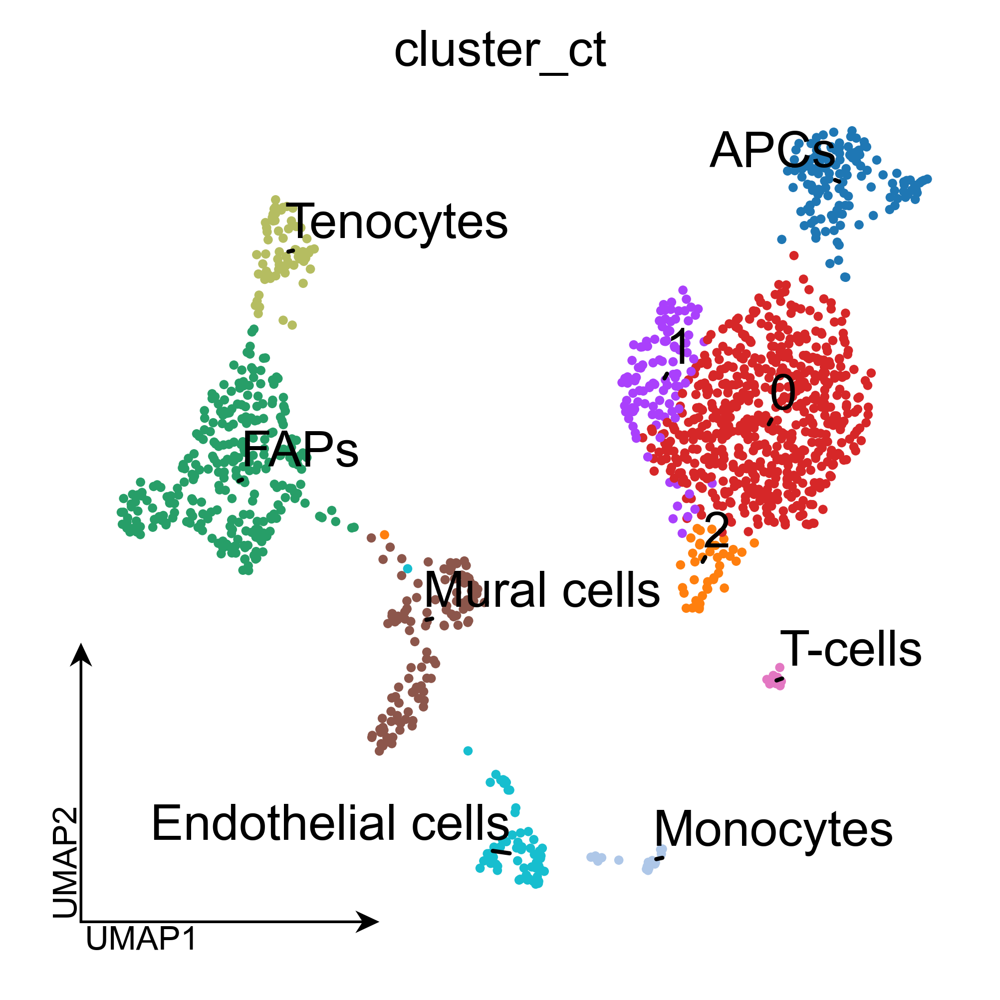

In [21]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata, 'cluster_ct', size=dotsize, fig_dir=fig_dir)

### Save & read

In [22]:
adata.write(h5ad_dir + 'adata.h5ad')

In [81]:
adata = sc.read(h5ad_dir + 'adata.h5ad', cache=True)

## Cell proportions

In [84]:
healthy_plot_pivot = adata_healthy.obs.groupby('tdtomato')['cluster_ct'].value_counts(normalize=True).mul(100).rename('percent').\
                             reset_index().pivot(columns='cluster_ct', index='tdtomato').fillna(0)
d21_plot_pivot = adata_d21.obs.groupby('tdtomato')['cluster_ct'].value_counts(normalize=True).mul(100).rename('percent').\
                           reset_index().pivot(columns='cluster_ct', index='tdtomato').fillna(0)

In [85]:
adata_healthy.obs['cluster_ct'].cat.categories

Index(['APCs', '0', '1', '2', 'Monocytes', 'T-cells', 'Tenocytes', 'FAPs',
       'Mural cells', 'Endothelial cells'],
      dtype='object')

In [86]:
healthy_plot_pivot

percent                                                      \
cluster_ct       APCs          0          1         2 Monocytes   T-cells   
tdtomato                                                                    
minus        5.084746   2.824859   3.389831  0.000000  2.259887  0.000000   
plus        29.729730  34.459459  22.972973  0.675676  9.459459  0.675676   

                                                                
cluster_ct  Tenocytes       FAPs Mural cells Endothelial cells  
tdtomato                                                        
minus       10.734463  43.502825    7.344633         24.858757  
plus         0.675676   0.675676    0.000000          0.675676

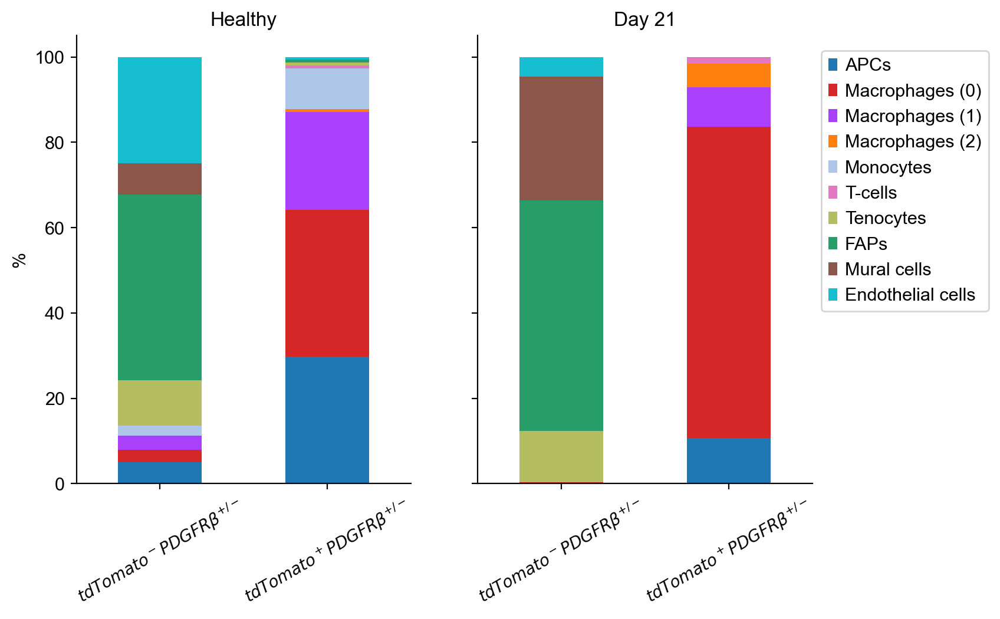

In [27]:
fig, axes = plt.subplots(1, 2, figsize=(8, 5), sharex=True, sharey=True)
healthy_plot_pivot.plot(kind='bar', stacked=True, color=adata_healthy.uns['cluster_ct_colors'], 
                        legend=False, ax=axes[0], title='Healthy')
d21_plot_pivot.plot(kind='bar', stacked=True, color=adata_d21.uns['cluster_ct_colors'], 
                    legend=False, ax=axes[1], title='Day 21')
axes[0].spines['top'].set_visible(False)
axes[0].spines['right'].set_visible(False)
axes[0].set_ylabel('%')
axes[0].set_xlabel('')
axes[0].set_xticklabels([r'$tdTomato^-PDGFR\beta^{+/-}$', r'$tdTomato^+PDGFR\beta^{+/-}$'], rotation=30, size=10)


axes[1].spines['top'].set_visible(False)
axes[1].spines['right'].set_visible(False)
axes[1].set_xlabel('')
axes[1].set_xticklabels([r'$tdTomato^-PDGFR\beta^{+/-}$', r'$tdTomato^+PDGFR\beta^{+/-}$'], rotation=30, size=10)

#handles0, labels0 = axes[0].get_legend_handles_labels()
handles, labels = axes[0].get_legend_handles_labels()
labels = adata_healthy.obs['cluster_ct'].cat.categories
labels = labels.str.replace('(\d+)', 'Macrophages (\\1)')
fig.legend(handles, labels,  title='', bbox_to_anchor=(0.96,0.9), loc='upper left')
fig.savefig(fig_dir + 'cell_proportions.pdf', bbox_inches='tight')


## Marker genes

In [28]:
marker_genes_dict = {
    'APCs': ['Itgax', 'H2-DMb1', 'H2-DMb2'], 
    'Macrophages': ['Adgre1', 'Csf1r', 'Mrc1'],
    'Monocytes': ['Itgal', 'Itgb2'],
    #'0': ['Cx3cr1', 'Adgre1'], 
    #'1': ['Lyve1', 'Cbr2', 'Mgl2'], 
    #'2': ['Ttn', 'Sfi1', 'Pdgfrb'], 
    'T-cells': ['Ccl5', 'Nkg7'], 
    'Tenocytes': ['Scx', 'Tnmd', 'Fmod'], 
    'FAPs': ['Pdgfra', 'Lum', 'Col3a1'],
    'Mural cells': ['Notch3', 'Rgs5', 'Pdgfrb'],
    'Endothelial cells': ['Pecam1', 'Kdr', 'Cdh5']
    }

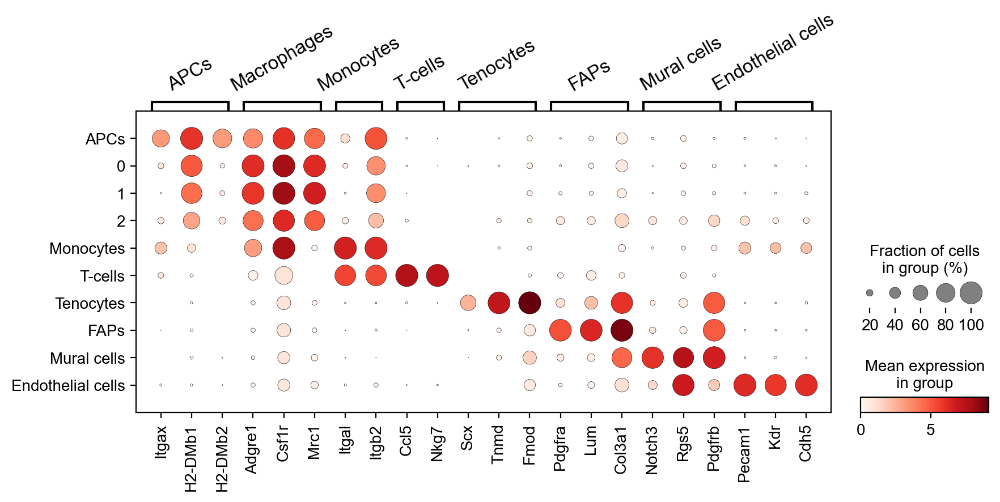

In [29]:
sc.pl.dotplot(adata, marker_genes_dict, groupby='cluster_ct', var_group_rotation=30, cmap='Reds')

In [30]:
marker_genes_dict_empty = {
    '': ['Itgax', 'H2-DMb1', 'H2-DMb2'],
    ' ': ['Adgre1', 'Csf1r', 'Mrc1'],
    '  ': ['Itgal', 'Itgb2'],
    #'0': ['Cx3cr1', 'Adgre1'], 
    #'1': ['Lyve1', 'Cbr2', 'Mgl2'], 
    #'2': ['Ttn', 'Sfi1', 'Pdgfrb'], 
    '   ': ['Ccl5', 'Nkg7'], 
    '    ': ['Scx', 'Tnmd', 'Fmod'], 
    '     ': ['Pdgfra', 'Lum', 'Col3a1'],
    '      ': ['Notch3', 'Rgs5', 'Pdgfrb'],
    '       ': ['Pecam1', 'Kdr', 'Cdh5']
    }

In [31]:
dp = sc.pl.dotplot(adata, marker_genes_dict_empty, groupby='cell_type', figsize=(9,2.5), 
                   return_fig=True)

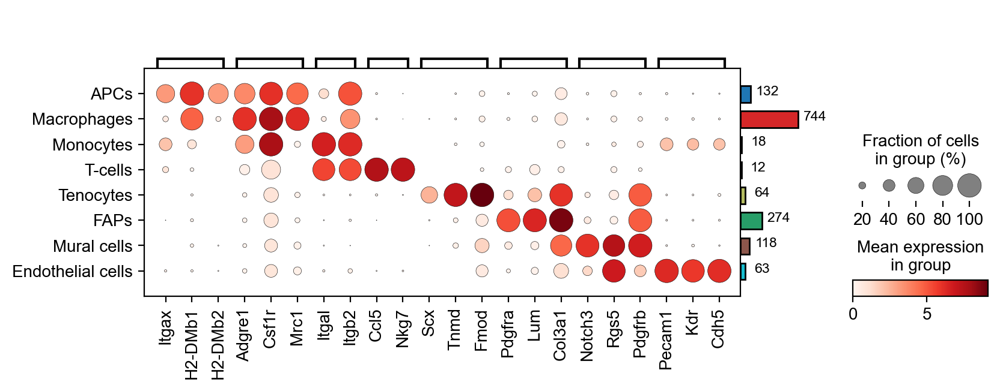

In [32]:
dp.add_totals(color=adata.uns['cell_type_colors']).savefig(fig_dir + 'markers_dotplot.pdf', dpi=300, ext='pdf')

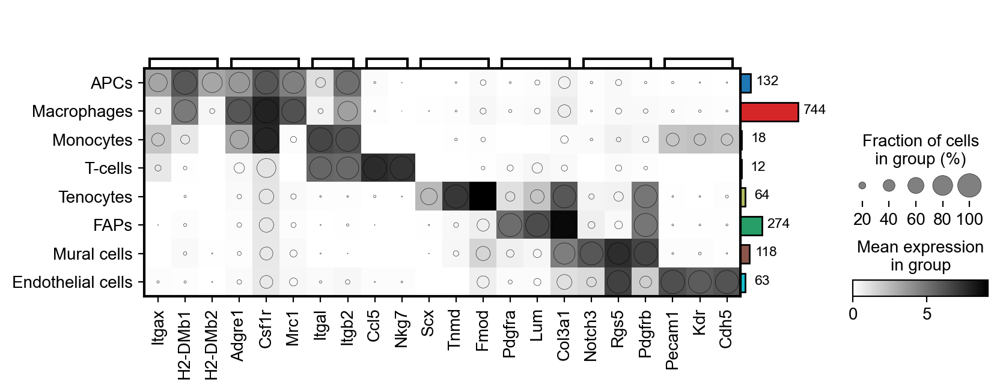

In [33]:
dp.add_totals(color=adata.uns['cell_type_colors']).style(color_on='square', cmap='binary').show()

In [34]:
binary_cm = cm.get_cmap('binary', 512)
new_binary_cm = ListedColormap(binary_cm(np.linspace(0, 0.8, 256)))

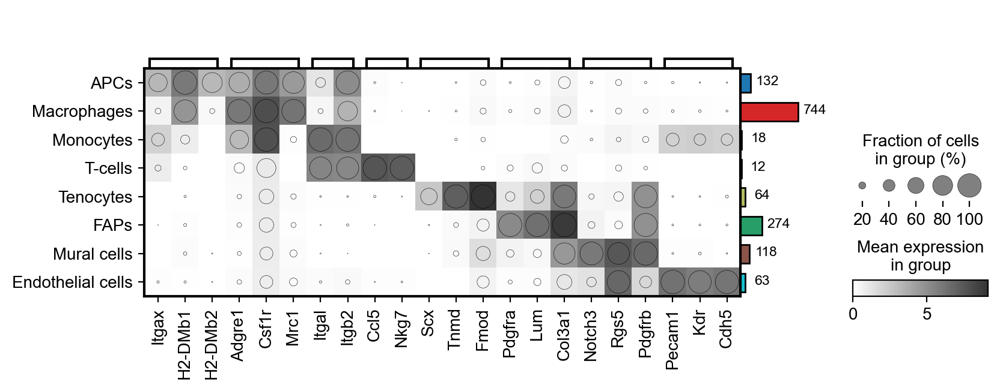

In [35]:
dp.add_totals(color=adata.uns['cell_type_colors']).style(color_on='square', cmap=new_binary_cm).\
savefig(fig_dir + 'markers_dotplot.binary.pdf', dpi=300, ext='pdf')

In [36]:
plt.rcParams["image.cmap"]

'RdBu_r'

In [37]:
marker_genes = [item for sublist in marker_genes_dict.values() for item in sublist]

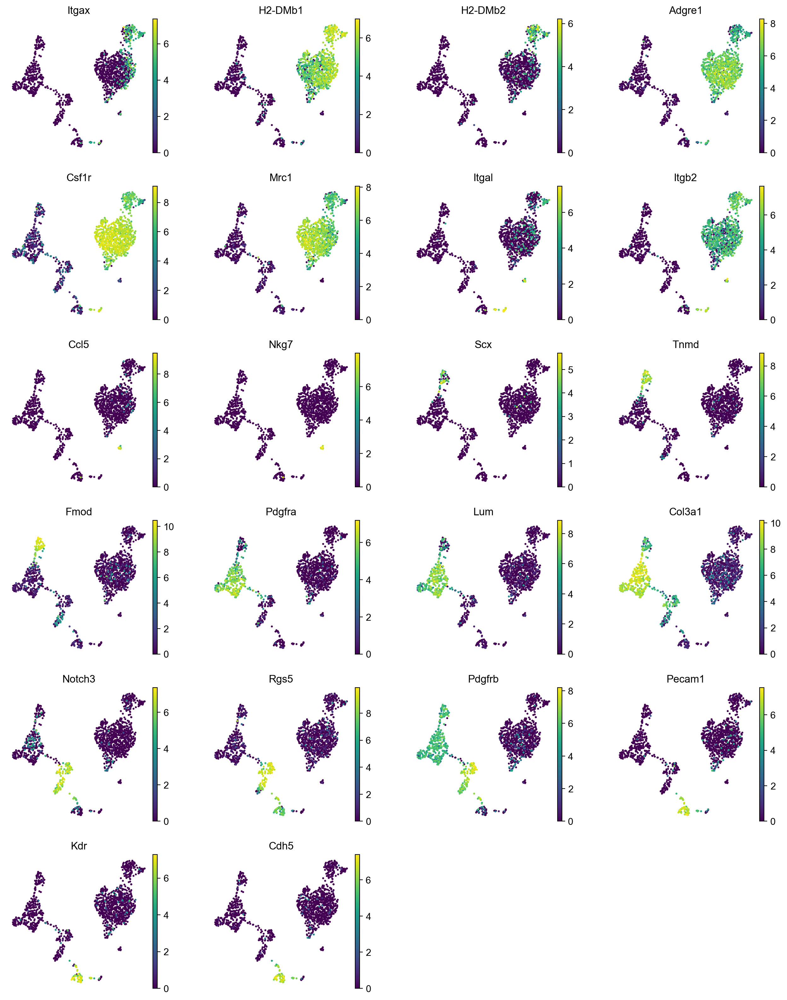

In [38]:
with plt.rc_context({'figure.figsize': (3, 3)}):
    umap_makers = sc.pl.umap(adata, color=marker_genes, alpha=alpha, size=dotsize, color_map='viridis', 
                             frameon=False, ncols=4, return_fig=True)
    umap_makers.savefig(fig_dir + 'umap_markers.pdf', dpi=300, ext='pdf')

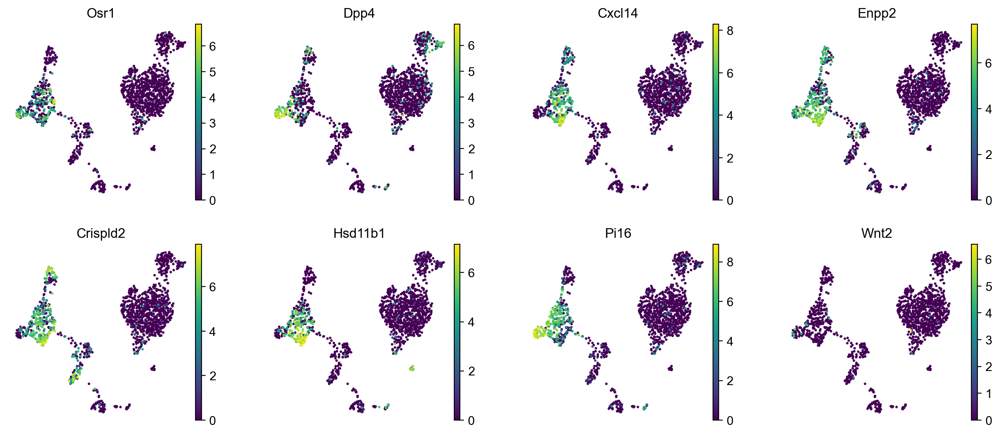

In [39]:
faps_genes = ['Osr1', 'Dpp4', 'Cxcl14', 'Enpp2', 'Crispld2', 'Hsd11b1', 'Pi16', 'Wnt2']
with plt.rc_context({'figure.figsize': (3, 3)}):
    umap_faps = sc.pl.umap(adata, color=faps_genes, alpha=alpha, size=dotsize, color_map='viridis', frameon=False,  ncols=4, return_fig=True)
    umap_faps.savefig(fig_dir + 'umap_faps_genes.pdf', dpi=300, ext='pdf')

## Mergeing unspliced

Loom file obtained by running velocyto masking for repeats. 
`velocyto run-smartseq2 -o mapping/velocyto -e macro_rm -m data/mm10_rmsk.gtf mapping/star/*.sorted.bam
data/gencode.vM25.primary_assembly.annotation.gtf`

In [87]:
ldata = scv.read(data_dir + 'macro_rm.loom')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [88]:
ldata

AnnData object with n_obs × n_vars = 1536 × 55487
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spanning', 'spliced', 'unspliced'

In [89]:
ldata.obs.head()

""
macro_rm:SS2_19_276_A1.sorted.bam
macro_rm:SS2_19_276_A2.sorted.bam
macro_rm:SS2_19_276_A3.sorted.bam
macro_rm:SS2_19_276_A4.sorted.bam
macro_rm:SS2_19_276_A5.sorted.bam


In [90]:
ldata.obs = ldata.obs.set_index(ldata.obs.index.str.replace('macro_rm:', '').str.replace('.sorted.bam', ''))

In [91]:
ldata.obs.head()

""
SS2_19_276_A1
SS2_19_276_A2
SS2_19_276_A3
SS2_19_276_A4
SS2_19_276_A5


In [92]:
adata.obsm['raw'].shape

(1425, 38178)

In [93]:
sub_uns = {k: adata.uns[k] for k in ['cell_type_colors', 'ischemia_colors', 'cluster_colors', 'cluster_ct_colors', 'tdtomato_colors']}

In [94]:
sub_obs = adata.obs[['total_counts', 'n_genes', 'sortdate', 'plate', 'well', 'cell_identity', 
                     'ischemia', 'sex', 'tdtomato', 'pct_counts_mt', 'percent_chrY', 'XIST-counts', 
                     'S_score', 'G2M_score', 'phase', 'doublet_scores', 'cell_type', 'cluster', 
                     'cluster_ct']]

In [95]:
sub_obsm ={k: adata.obsm[k] for k in ['X_pca', 'X_umap']} 

In [96]:
adata_raw = sc.AnnData(X=adata.obsm['raw'], obs=sub_obs, var=adata.raw.var, uns=sub_uns, obsm=sub_obsm, obsp=adata.obsp)

In [97]:
adata_raw.layers['raw'] = adata_raw.X

In [98]:
adata_raw = scv.utils.merge(adata_raw, ldata)

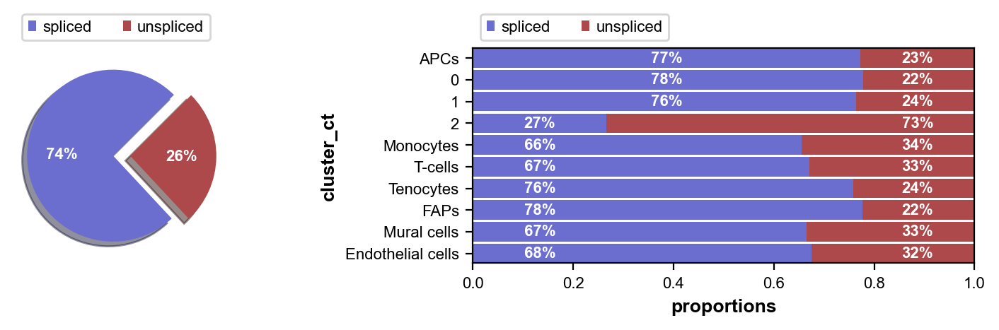

In [99]:
scv.pl.proportions(adata_raw, groupby='cluster_ct')

In [103]:
''' Copied from scv.pl.proportions source code and modified
'''

import warnings
from numpy import ndarray
from scipy.sparse import issparse, spmatrix
from typing import Optional, Union
def sum(a: Union[ndarray, spmatrix], axis: Optional[int] = None) -> ndarray:
    """Sum array elements over a given axis.
    Arguments
    ---------
    a
        Elements to sum.
    axis
        Axis along which to sum elements. If `None`, all elements will be summed.
        Defaults to `None`.
    Returns
    -------
    ndarray
        Sum of array along given axis.
    """

    if a.ndim == 1:
        axis = 0

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        return a.sum(axis=axis).A1 if issparse(a) else a.sum(axis=axis)

In [104]:
layers = None
use_raw=True
if layers is None:
    layers = ["spliced", "unspliced", "ambigious"]
layers_keys = [key for key in layers if key in adata_raw.layers.keys()]
counts_layers = [sum(adata_raw.layers[key], axis=1) for key in layers_keys]

if use_raw:
    ikey, obs = "initial_size_", adata_raw.obs
    counts_layers = [
        obs[ikey + layer_key] if ikey + layer_key in obs.keys() else c
        for layer_key, c in zip(layers_keys, counts_layers)
    ]
counts_total = np.sum(counts_layers, 0)
counts_total += counts_total == 0
counts_layers = np.array([counts / counts_total for counts in counts_layers])


In [117]:
means = np.mean(counts_layers, axis=1)
medians = np.median(counts_layers, axis=1)
means, medians

(array([0.74427431, 0.25572569]), array([0.78448706, 0.21551294]))

[<BarContainer object of 10 artists>, <BarContainer object of 10 artists>, <matplotlib.lines.Line2D object at 0x7f885e761da0>]


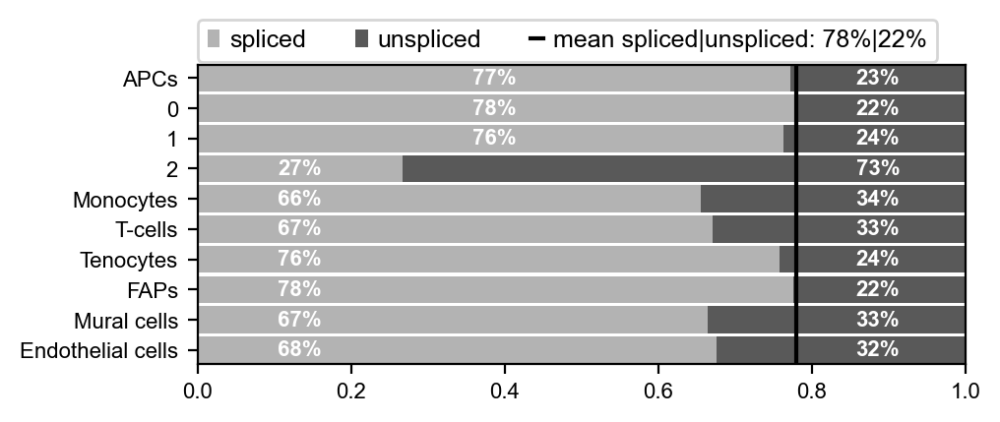

In [125]:
add_labels_bar=True
fontsize=10
gspec = plt.GridSpec(1, 1, plt.figure(None, figsize=(5,2), dpi=100))
#colors = plt.get_cmap("tab20b")(np.linspace(0.10, 0.65, len(layers_keys)))
colors = plt.get_cmap("binary")(np.linspace(0.30, 0.65, len(layers_keys)))
groupby = 'cluster_ct'
if groupby is not None and groupby in adata_raw.obs.keys():
    counts_groups = dict()
    for cluster in adata_raw.obs[groupby].cat.categories:
        counts_groups[cluster] = np.mean(
            counts_layers[:, adata_raw.obs[groupby] == cluster], axis=1
        )

    labels = list(counts_groups.keys())
    data = np.array(list(counts_groups.values()))
    data_cum = data.cumsum(axis=1)

    ax2 = plt.subplot(gspec[0])
    for i, (colname, color) in enumerate(zip(layers_keys, colors)):
        starts, widths = data_cum[:, i] - data[:, i], data[:, i]
        xpos = starts + widths / 2
        curr_xpos = xpos[0]
        for i, (x, w) in enumerate(zip(xpos, widths)):
            if not (x - w / 2 + 0.05 < curr_xpos < x + w / 2 - 0.05):
                curr_xpos = x
            xpos[i] = curr_xpos

        ax2.barh(
            labels, widths, left=starts, height=0.9, label=colname, color=color
        )

        if add_labels_bar:
            r, g, b, _ = color
            text_color = "white" if r * g * b < 0.5 else "darkgrey"
            for y, (x, c) in enumerate(zip(xpos, widths)):
                ax2.text(
                    x,
                    y,
                    f"{(c * 100):.0f}%",
                    ha="center",
                    va="center",
                    color=text_color,
                    fontsize=8,
                    fontweight="bold",
                )

    #ax2.add_artist(first_legend)
    ax2.invert_yaxis()
    ax2.set_xlim(0, np.nansum(data, axis=1).max())
    ax2.margins(0)
    vline = ax2.axvline(int(math.floor(medians[0]*100))/100, linestyle='-', color='k', 
                        label='mean spliced|unspliced: %d%%|%d%%' %(math.floor(medians[0]*100), math.ceil(medians[1]*100)))
    #ax2.legend(handles=[first_legend, vline])
    ax2.legend(
        ncol=len(layers_keys)+1,
        bbox_to_anchor=(0, 1),
        borderaxespad=0,
        loc="lower left",
        fontsize=fontsize,
    )

    handles, labels = ax2.get_legend_handles_labels()
    new_order = [1, 2, 0]
    handles = [handles[i] for i in new_order]
    labels = [labels[i] for i in new_order]
    print(handles)
    ax2.legend(handles=handles, labels=labels, ncol=3, borderaxespad=0, loc='lower left', bbox_to_anchor=(0, 1.01), fontsize=9)  

    #ax2.set_xlabel("proportions", fontweight="bold", fontsize=fontsize * 1.2)
    #ax2.set_ylabel(groupby, fontweight="bold", fontsize=fontsize * 1.2)
    ax2.tick_params(axis="both", which="major", labelsize=8)
    
    fig = ax2.get_figure()
    fig.savefig(fig_dir + 'proportions.pdf', bbox_inches='tight')

In [120]:
counts_s_per_cell_raw = scv.utils.sum_var(adata_raw.layers['spliced'])
counts_u_per_cell_raw = scv.utils.sum_var(adata_raw.layers['unspliced'])
fractions_u_per_cell_raw = counts_u_per_cell_raw / (counts_s_per_cell_raw + counts_u_per_cell_raw)

In [58]:
adata_raw.obs['counts_spliced'] = counts_s_per_cell_raw
adata_raw.obs['counts_unspliced'] = counts_u_per_cell_raw
adata_raw.obs['counts_spliced_unspliced'] = counts_s_per_cell_raw + counts_u_per_cell_raw
adata_raw.obs['fractions_unspliced'] = fractions_u_per_cell_raw

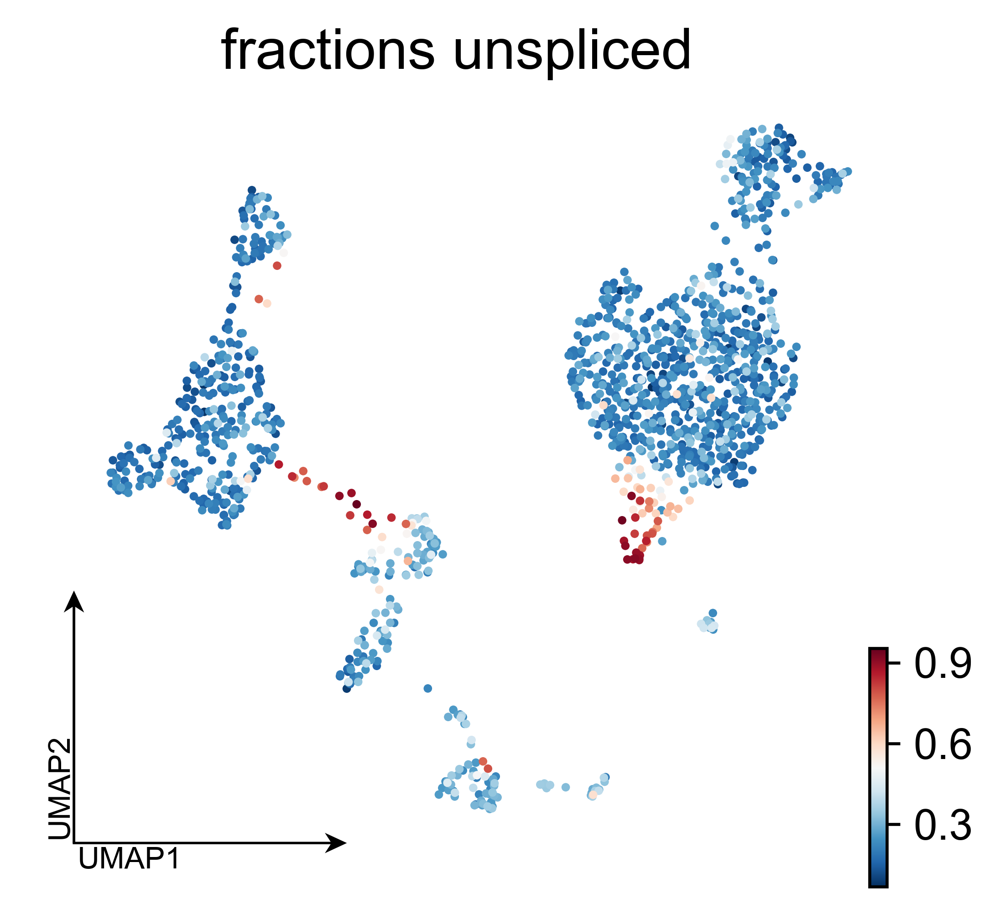

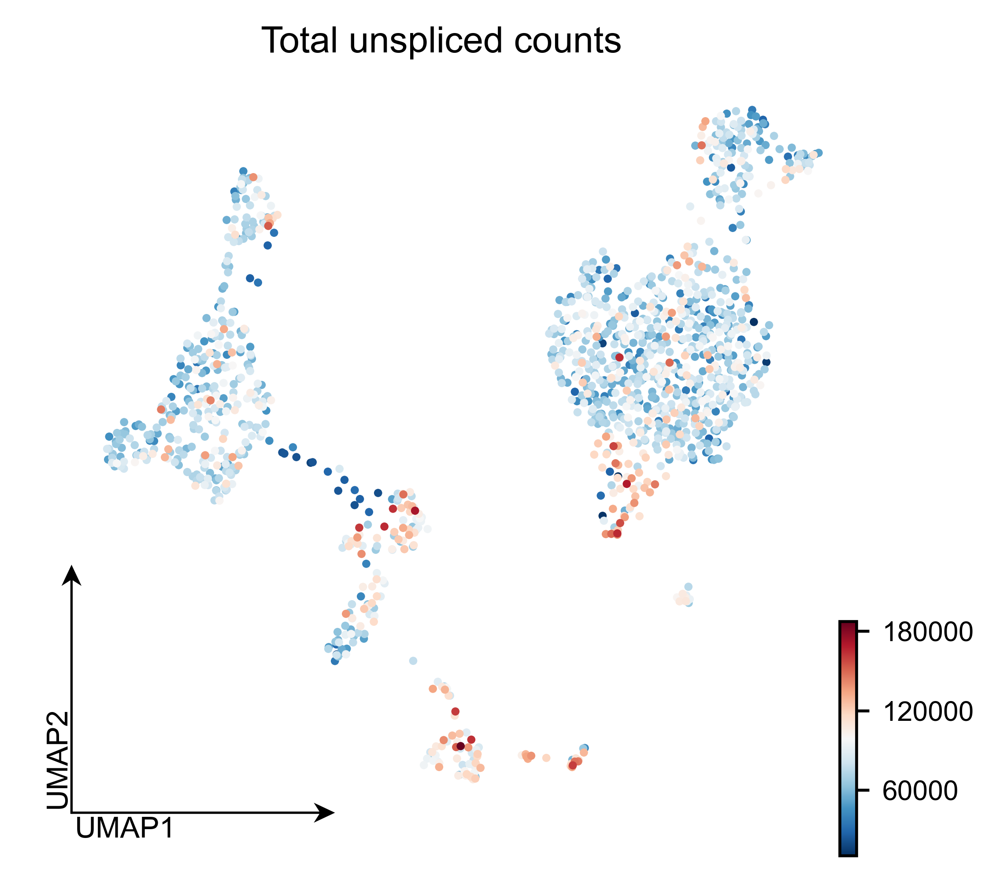

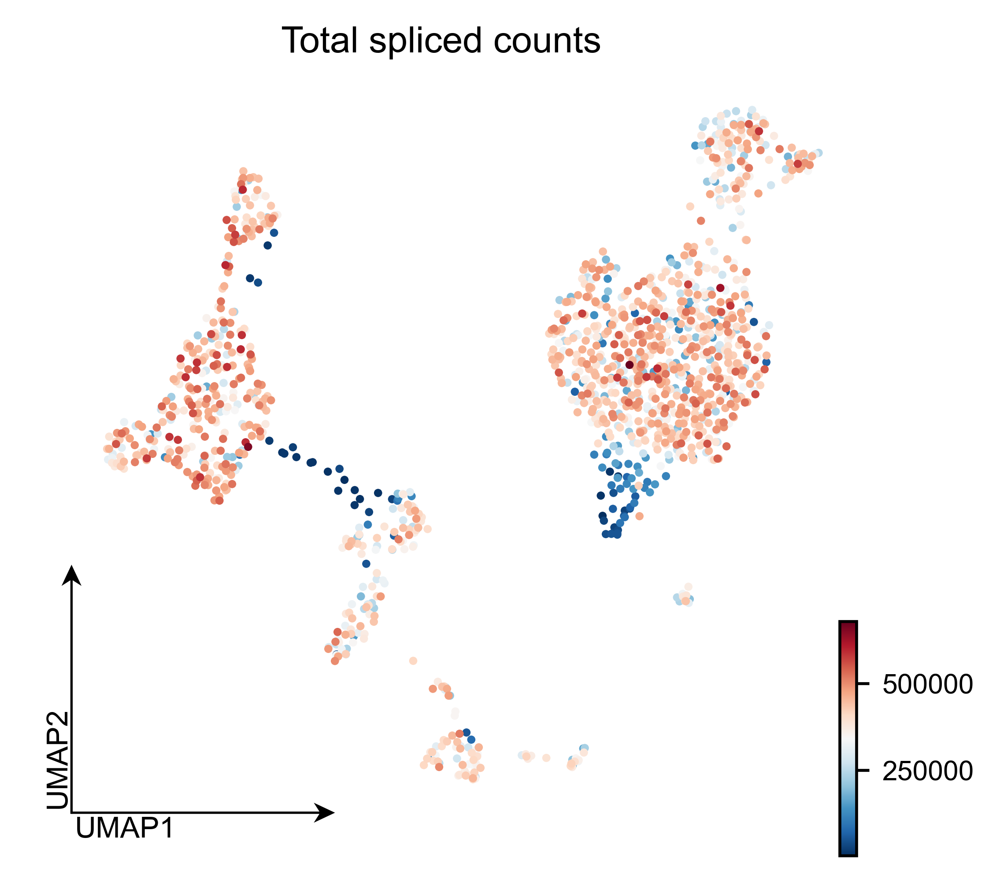

In [59]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap_scv_scatter(adata_raw, 'fractions_unspliced', alpha=1, size=dotsize, fontsize=fontsize+5, fig_dir=fig_dir)
    plot_umap_scv_scatter(adata_raw, 'counts_unspliced', alpha=1, size=dotsize, fontsize=fontsize, title='Total unspliced counts', fig_dir=fig_dir)
    plot_umap_scv_scatter(adata_raw, 'total_counts', alpha=1, size=dotsize, fontsize=fontsize, title='Total spliced counts', fig_dir=fig_dir)

### Save & read

In [61]:
adata_raw.write(h5ad_dir + 'adata.unspliced.raw.h5ad')

In [62]:
adata_raw = sc.read(h5ad_dir + 'adata.unspliced.raw.h5ad', cache=True)

Only considering the two last: ['.raw', '.h5ad'].
Only considering the two last: ['.raw', '.h5ad'].


## D21 only

In [63]:
adata_d21 = adata[adata.obs['ischemia'] == 'D21']

In [64]:
import re
def mouse_genes(genes_str):
    genes = []
    for g in genes_str.split(','):
        gene = g.strip().capitalize()
        if re.search('-', gene):
            gene = '-'.join([a.capitalize() for a in gene.split('-')])
        genes.append(gene)
    return genes

In [65]:
macrophage_genes = mouse_genes('CD74, H2-Ab1, Csf1r, Anxa2, Junb, CD36, Ptprc, Adgre1, Mrc1, CD14,  Itgam, CD86, TLR2, TLR7, Cx3cr1')
mural_cell_genes = mouse_genes('Ebf1, PDGFRB, Adamts2, Sema5a, CACNA1C, Ano1, Myh11,  RGS5, Cspg4, Acta2, Des, Nes')
genes={'Known macrophage associated': macrophage_genes,
       'Known mural cell associated': mural_cell_genes}

### dotplot

In [66]:
dp_d21 = sc.pl.dotplot(adata_d21, genes, groupby='cluster_ct', var_group_rotation=0, 
                       figsize=(10.5, 2.8), return_fig=True)

In [67]:
dp_d21.height

2.8

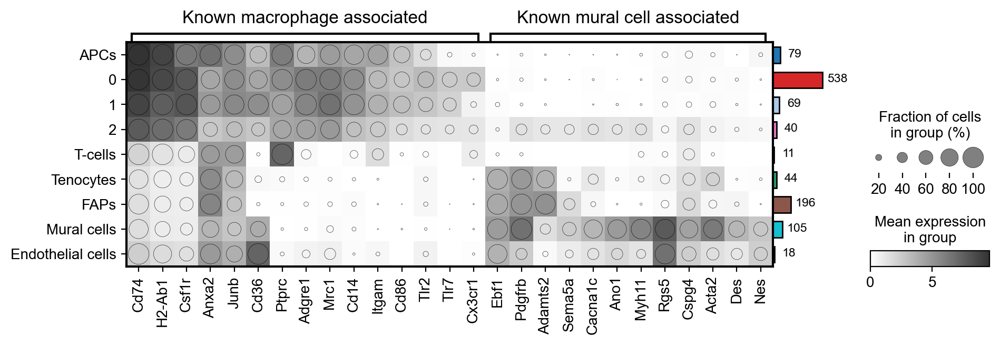

In [68]:
dp_d21.add_totals(color=adata.uns['cell_type_colors']).style(color_on='square', cmap=new_binary_cm).\
savefig(fig_dir + 'd21_dotplot.binary.pdf', dpi=300, ext='pdf')

### PAGA

In [69]:
sc.tl.draw_graph(adata_d21)

Trying to set attribute `.uns` of view, copying.


In [70]:
sc.tl.paga(adata_d21, groups='cluster')

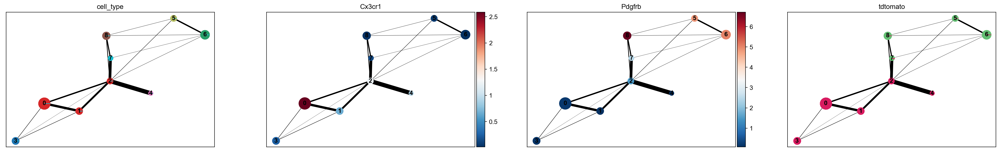

In [71]:
sc.pl.paga(adata_d21, color=['cell_type', 'Cx3cr1', 'Pdgfrb', 'tdtomato'])

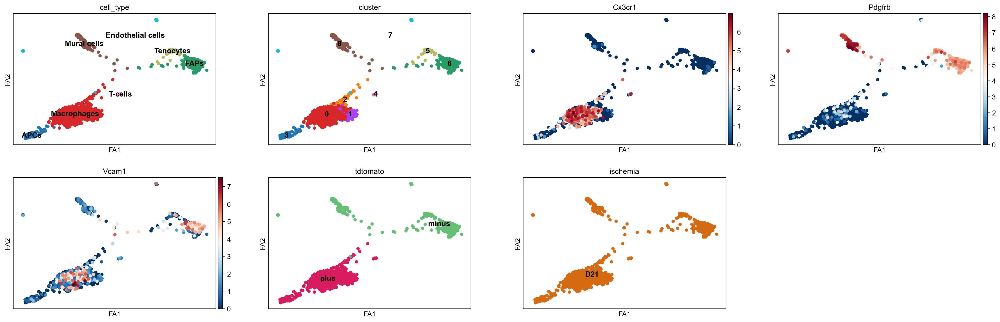

In [72]:
sc.tl.draw_graph(adata_d21, init_pos='paga')
sc.pl.draw_graph(adata_d21, color=['cell_type', 'cluster', 'Cx3cr1', 'Pdgfrb', 'Vcam1', 'tdtomato', 'ischemia'], legend_loc='on data' )

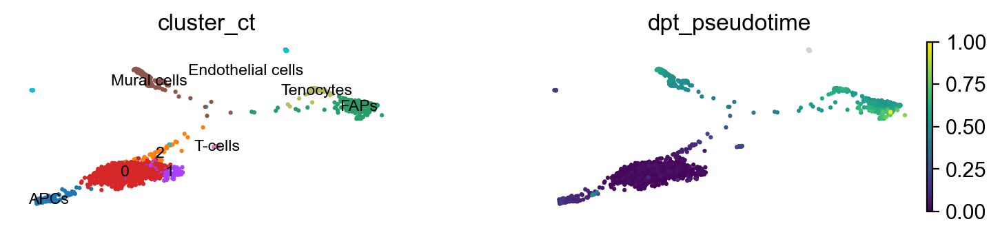

In [73]:
adata_d21.uns['iroot'] = np.flatnonzero(adata_d21.obs['cluster_ct'] == '0')[0]
sc.tl.diffmap(adata_d21)
sc.tl.dpt(adata_d21)
with plt.rc_context({"figure.figsize": (3.5, 1.6), 'figure.frameon':False}):
    sc.pl.draw_graph(adata_d21, color=['cluster_ct', 'dpt_pseudotime'], legend_loc='on data', color_map='viridis',
                 frameon=False, size=20, legend_fontsize='x-small', legend_fontweight='light', layout='fa')



Since endothelial cells are just lying outside of everything, decided to remove them from display

In [74]:
adata_d21.obs['pseudotime'] = adata_d21.obs['dpt_pseudotime']

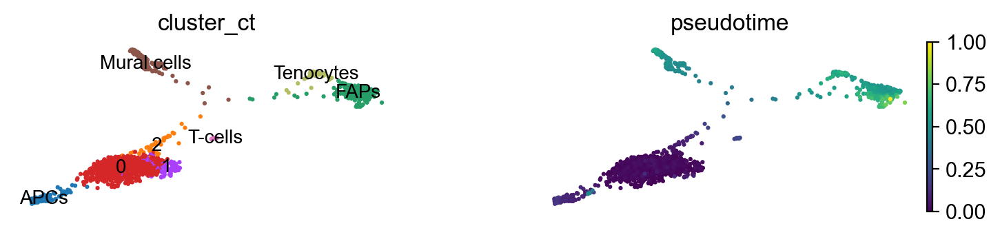

In [75]:
adata_d21_no_ec = adata_d21[adata_d21.obs['cluster_ct'] != 'Endothelial cells']
with plt.rc_context({"figure.figsize": (3.5, 1.6), 'figure.frameon':False}):
    graph_fa = sc.pl.draw_graph(adata_d21_no_ec, color=['cluster_ct', 'pseudotime'], legend_loc='on data', color_map='viridis',
                 frameon=False, size=20, legend_fontsize='small', legend_fontweight='light', layout='fa', return_fig=True)
    graph_fa.savefig(fig_dir + 'draw_graph_fa.pdf', bbox_inches='tight')

In [76]:
viridis_cm = cm.get_cmap('viridis', 512)
new_viridis_cm = ListedColormap(viridis_cm(np.linspace(0, 0.8, 256)))

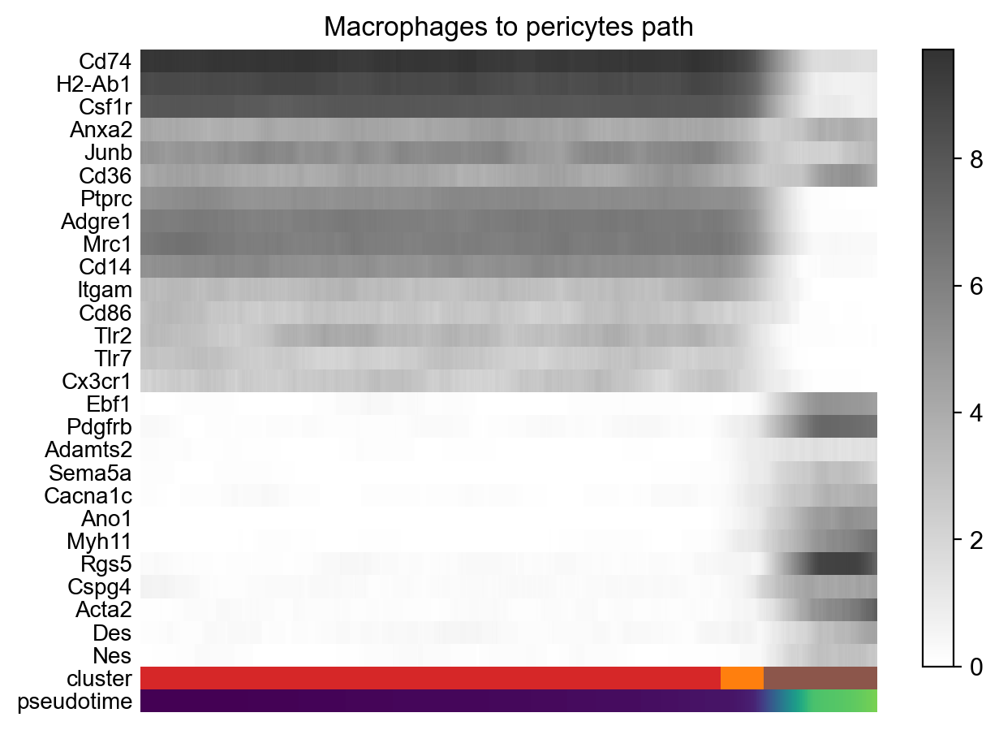

In [77]:
plt.rc_context({"figure.figsize": (7, 3.5), "figure.dpi": 300})
plt.rcParams["figure.figsize"] = [7, 5]
path=[0,2,8]
#gene_names=['Cx3cr1', 'Lyve1', 'Lama1', 'Fbn2', 'Ttn', 'Tln2', 'Pdgfrb']
descr='Macrophages to pericytes'
fig = plt.figure()
axes, data = sc.pl.paga_path(
        adata_d21, path, macrophage_genes + mural_cell_genes,
        use_raw=True,
        show_node_names=False,
        ytick_fontsize=10,
        title_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['pseudotime'],
        show_yticks=True,
        show_colorbar=True,
        show=False,
        color_map=new_binary_cm, #'turbo',#'binary',
        groups_key='cluster',
        color_maps_annotations={'pseudotime': new_viridis_cm},
        title='{} path'.format(descr),
        return_data=True) #save='.pdf'
#data.to_csv('./data/results/paga_path_{}.csv'.format(descr))

In [78]:
linewidth=0.5
n_cells = np.sum(adata_d21.obs['cluster'].isin(map(str,path)))
scale = (axes.get_xlim()[1] - axes.get_xlim()[0])/ float(n_cells)
cluster0_size = adata_d21[adata_d21.obs['cluster'] == '0'].shape[0]
cluster2_size = adata_d21[adata_d21.obs['cluster'] == '2'].shape[0]
axes.axvline(x=(cluster0_size) * scale, linewidth=linewidth, color='w')
axes.axvline(x=(cluster0_size + cluster2_size - 0.5)*scale, linewidth=linewidth, color='w')

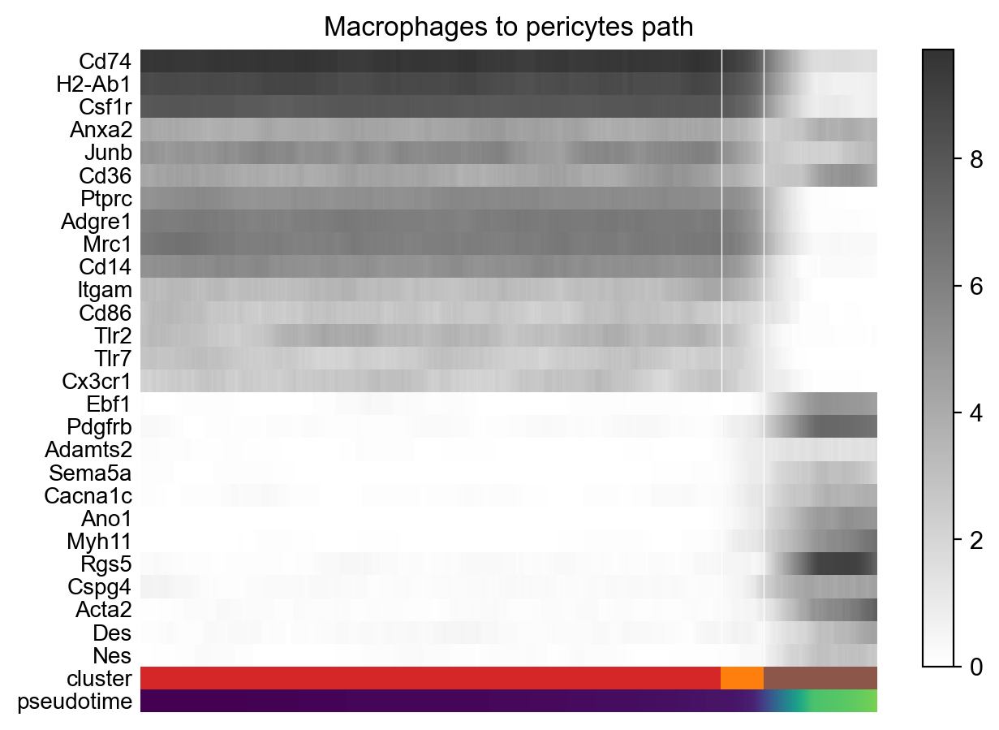

In [79]:
fig

In [80]:
fig.savefig(fig_dir + 'paga_path.binary.pdf')

## Adding unspliced counts on top of FC counts

In [81]:
adata_w_unspliced = adata_raw.copy()
adata_w_unspliced.X = adata_raw.X + adata_raw.layers['unspliced']

In [82]:
sc.pp.normalize_per_cell(adata_w_unspliced)
sc.pp.log1p(adata_w_unspliced)

# Store normalized counts in the raw slot.
# We will subset adata.X for variable genes, but want to keep all genes matrix as well.
adata_w_unspliced.raw = adata_w_unspliced

In [83]:
adata_w_unspliced_d21 = adata_w_unspliced[adata_w_unspliced.obs['ischemia'] == 'D21']
adata_w_unspliced_d21.shape

(1100, 38178)

In [84]:
adata_raw_d21 = adata_raw[adata_raw.obs['ischemia'] == 'D21']

### Dotplot

In [85]:
mat = adata_raw.layers['unspliced']/(adata_raw.layers['raw'] + adata_raw.layers['unspliced'] + 1e-12)
mat_df = pd.DataFrame(mat, columns=adata_raw.var_names)
mat_df['cluster_ct'] = adata_raw.obs['cluster_ct'].values

In [86]:
mat_df_mean = mat_df.groupby('cluster_ct').mean()

In [87]:
def star_plus_by_avg_fraction_u(adata, feature='cluster_ct'):
    ''' Return the star, plus coordinates
    First get an updated fraction_u_per_gene_fc based on
    the same cutoff as in the earlier enrichment analysis
    '''
    unspliced_df = pd.DataFrame({'gene': adata.var_names})
    for cluster in adata.obs[feature].cat.categories:
        counts_s_per_gene_fc = scv.utils.sum_obs(adata[adata.obs[feature]==cluster].X)
        counts_u_per_gene = scv.utils.sum_obs(adata[adata.obs[feature]==cluster].layers['unspliced'])
        fractions_u_per_gene_fc = counts_u_per_gene / (counts_s_per_gene_fc + counts_u_per_gene)
        cluster_size = adata[adata.obs[feature]==cluster].shape[0]
        percent_cells_s = scv.utils.sum_obs(adata[adata.obs[feature]==cluster].layers['spliced']>0)/cluster_size
        percent_cells_s_fc = scv.utils.sum_obs(adata[adata.obs[feature]==cluster].X>0)/cluster_size
        percent_cells_u = scv.utils.sum_obs(adata[adata.obs[feature]==cluster].layers['unspliced']>0)/cluster_size
        avg_fractions_u = mat_df_mean.loc[cluster, :]
        
        avg_fractions_u_upadated = []
        for avg_fraction_u, fraction_u in zip(avg_fractions_u, fractions_u_per_gene_fc):
            if avg_fraction_u >= 0.3:
                avg_fractions_u_upadated.append(fraction_u)
            else:
                avg_fractions_u_upadated.append(0)
        unspliced_df[cluster] = avg_fractions_u_upadated

    unspliced_df.set_index('gene', inplace=True)
    unspliced_df = unspliced_df.transpose()
    
    xs_big, ys_big, xs_medium, ys_medium = [], [], [], []
    for i, gene in enumerate(macrophage_genes + mural_cell_genes):
        for j, p in enumerate(unspliced_df.loc[:, gene]):
            if p >= 0.8:
                xs_big.append(i + 0.5)
                ys_big.append(j + 0.5)
            elif p>=0.4:
                xs_medium.append(i + 0.5)
                ys_medium.append(j + 0.5)
    
    return(unspliced_df, xs_big, ys_big, xs_medium, ys_medium)


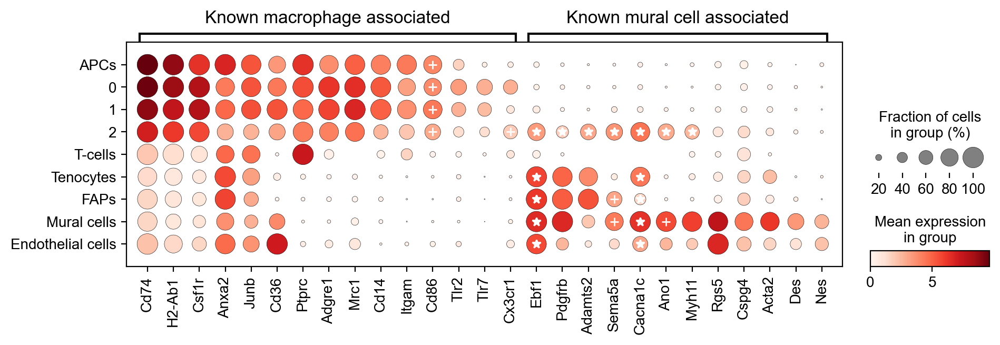

In [88]:
unspliced_df, xs_big, ys_big, xs_medium, ys_medium = star_plus_by_avg_fraction_u(adata_raw_d21)
dp_d21_w_unspliced = sc.pl.dotplot(adata_w_unspliced_d21, genes, groupby='cluster_ct', var_group_rotation=0, 
                                   figsize=(10.5, 2.8), return_fig=True)
dp_d21_w_unspliced.get_axes()['mainplot_ax'].plot(xs_big, ys_big, 'w*', xs_medium, ys_medium, 'w+')

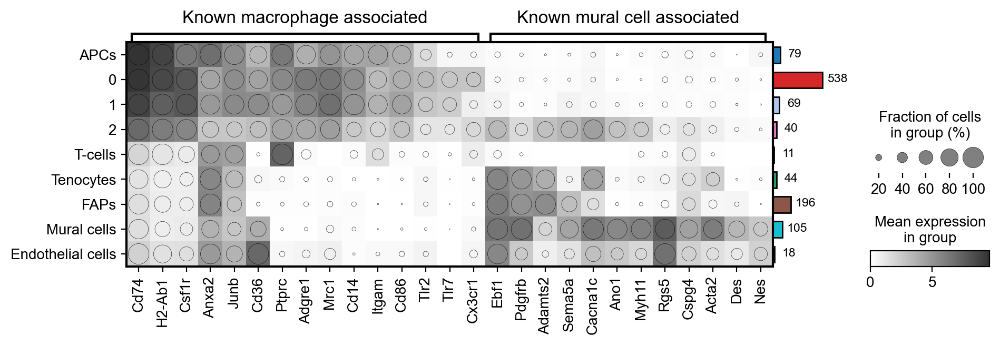

In [89]:
dp_d21_w_unspliced = sc.pl.dotplot(adata_w_unspliced_d21, genes, groupby='cluster_ct', var_group_rotation=0, 
                                   figsize=(10.5, 2.8), return_fig=True)
ax = dp_d21_w_unspliced.add_totals(color=adata.uns['cell_type_colors']).\
    style(color_on='square', cmap=new_binary_cm).get_axes()['mainplot_ax']

In [90]:
col_big = ax.scatter(xs_big, ys_big, c='w', marker='*')
col_medium = ax.scatter(xs_medium, ys_medium, c='w', marker='+')

In [91]:
ax.add_collection(col_big)
ax.add_collection(col_medium)

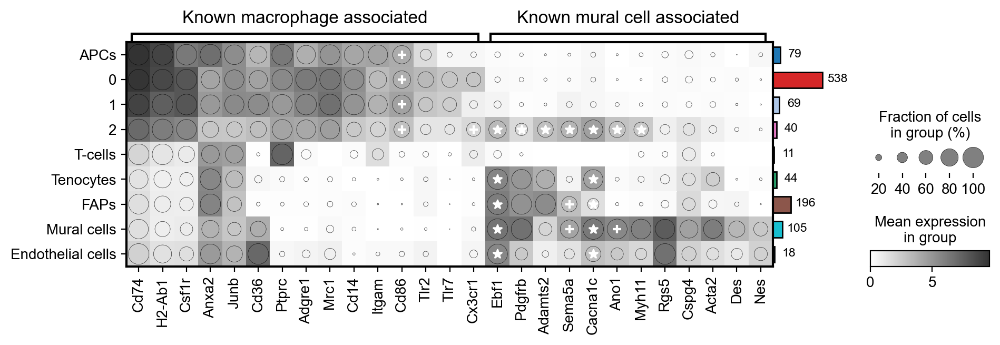

In [92]:
ax.get_figure()

In [93]:
ax.get_figure().savefig(fig_dir + 'd21_dotplot_w_unspliced.binary.pdf', bbox_inches='tight')

### PAGA

In [104]:
adata_w_unspliced_d21.obs['pseudotime'] = adata_d21.obs['dpt_pseudotime']
adata_w_unspliced_d21.obs['dpt_pseudotime'] = adata_d21.obs['dpt_pseudotime']

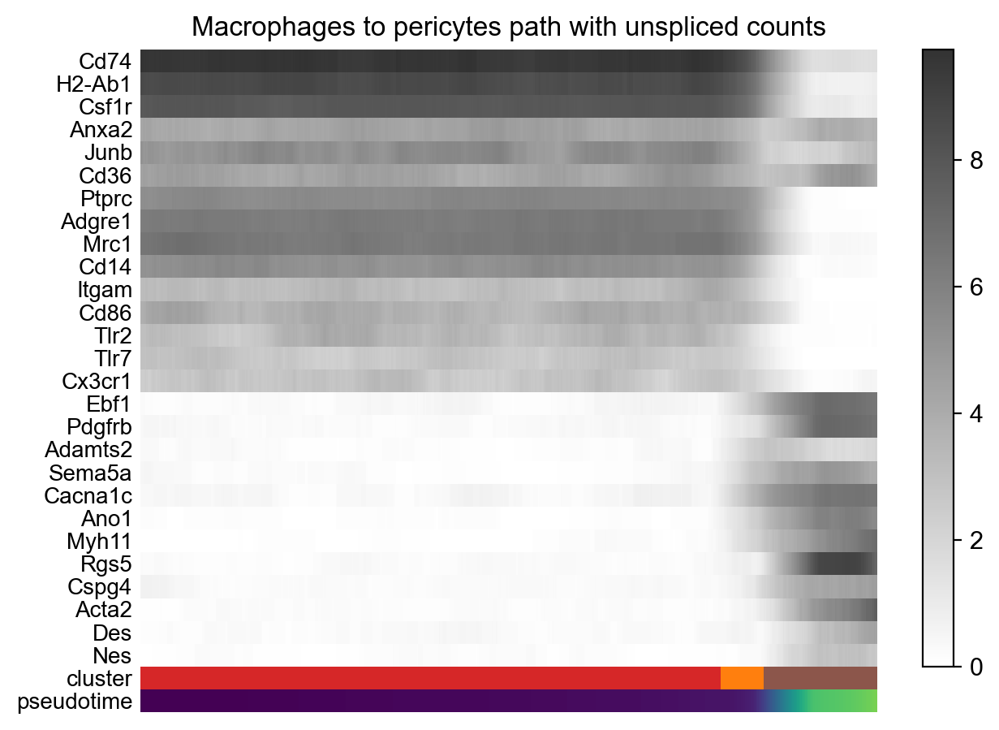

In [105]:
plt.rc_context({"figure.figsize": (7, 3.5), "figure.dpi": 300})
plt.rcParams["figure.figsize"] = [7, 5]
path=[0,2,8]
#gene_names=['Cx3cr1', 'Lyve1', 'Lama1', 'Fbn2', 'Ttn', 'Tln2', 'Pdgfrb']
descr='Macrophages to pericytes'
fig = plt.figure()
axes, data = sc.pl.paga_path(
        adata_w_unspliced_d21, path, macrophage_genes + mural_cell_genes,
        use_raw=True,
        show_node_names=False,
        ytick_fontsize=10,
        title_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['pseudotime'],
        show_yticks=True,
        show_colorbar=True,
        show=False,
        color_map=new_binary_cm, #'binary', #'turbo',
        groups_key='cluster',
        color_maps_annotations={'pseudotime': new_viridis_cm},
        title='{} path with unspliced counts'.format(descr),
        return_data=True) #save='.pdf'
#data.to_csv('./data/results/paga_path_{}.csv'.format(descr))

In [106]:
linewidth=0.5
n_cells = np.sum(adata_w_unspliced_d21.obs['cluster'].isin(map(str,path)))
scale = (axes.get_xlim()[1] - axes.get_xlim()[0])/ float(n_cells)
cluster0_size = adata_w_unspliced_d21[adata_w_unspliced_d21.obs['cluster'] == '0'].shape[0]
cluster2_size = adata_w_unspliced_d21[adata_w_unspliced_d21.obs['cluster'] == '2'].shape[0]
axes.axvline(x=(cluster0_size) * scale, linewidth=linewidth, color='w')
axes.axvline(x=(cluster0_size + cluster2_size - 0.5)*scale, linewidth=linewidth, color='w')

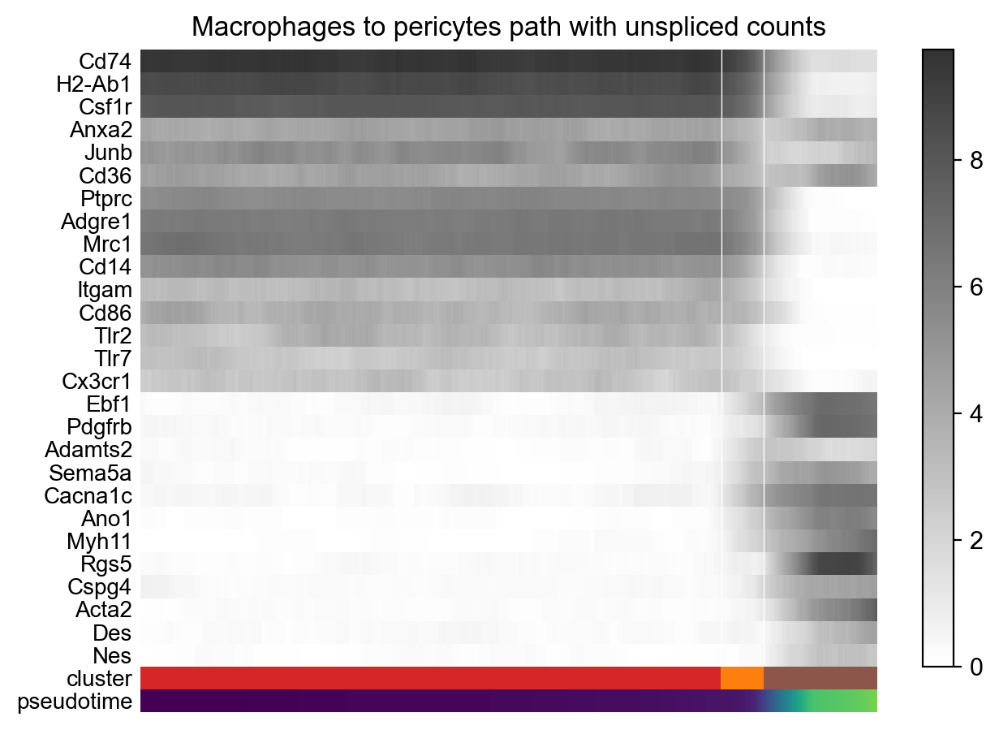

In [107]:
fig

In [108]:
fig.savefig(fig_dir + 'paga_path.w_unspliced.binary.pdf')

## DE analysis

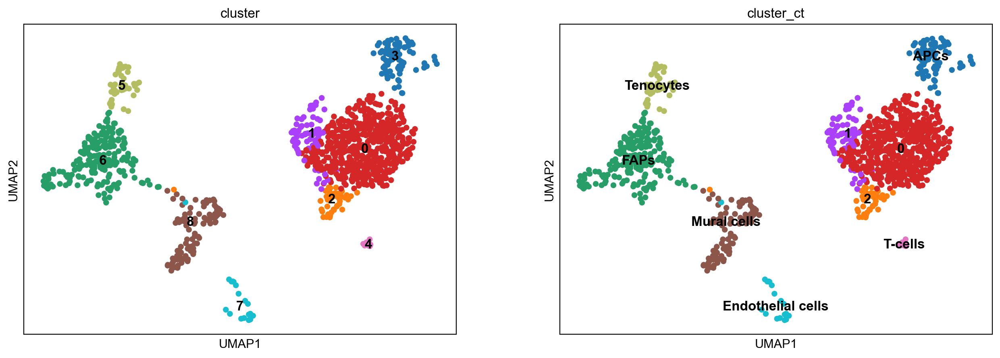

In [109]:
sc.pl.umap(adata_d21, color=['cluster', 'cluster_ct'], legend_loc='on data')

In [110]:
# keep only protein coding genes in sig list
import pyranges as pr
gtf_file = '../data/gencode.vM25.primary_assembly.annotation.gtf'
genes = pr.read_gtf(gtf_file, as_df = True)
proteins = genes[(genes.gene_type == 'protein_coding') & (genes.Feature == 'gene')]

### 0vs2

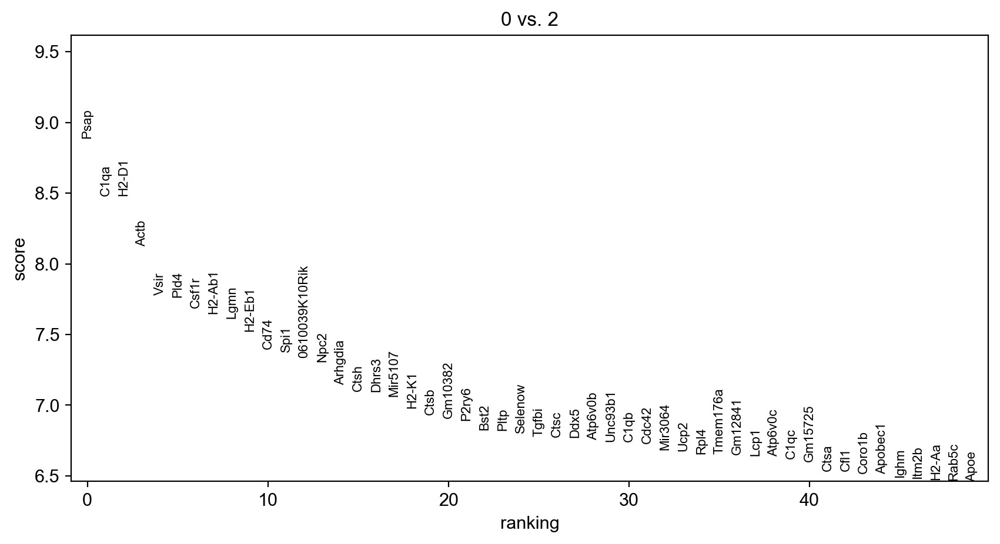

1236 sig_genes, with 1068 up and 168 down


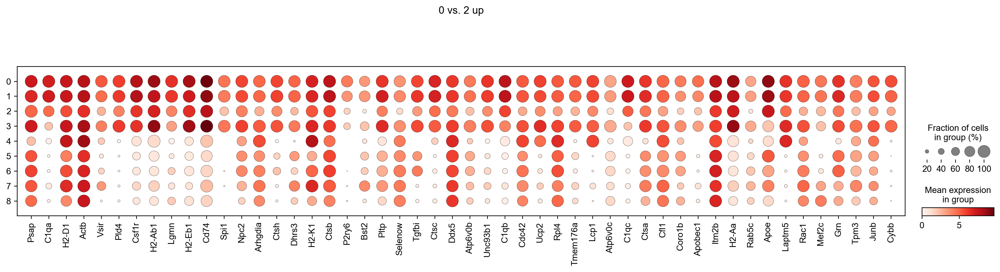

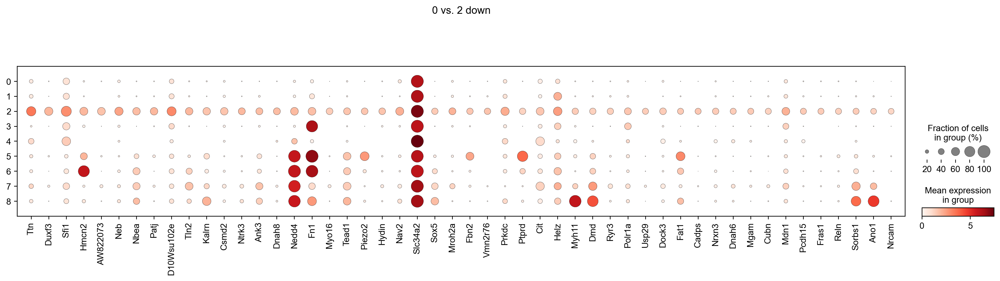

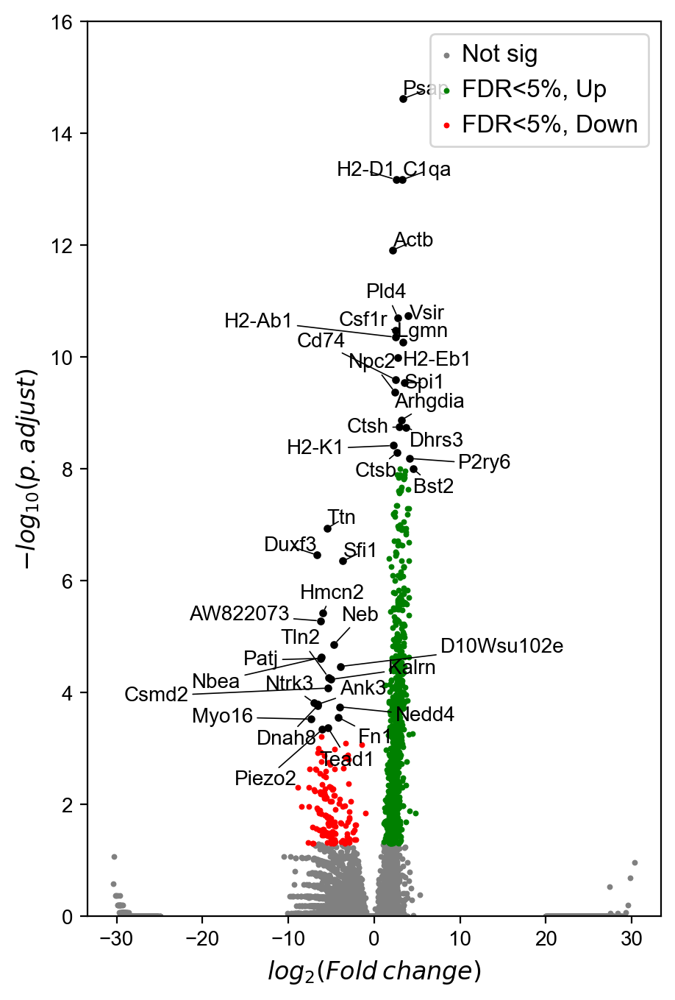

In [111]:
sig_genes_0_vs_2 = rank_and_string(adata_d21, '0', '2', 'cluster', proteins, extra_tag='', save_volcano=False, use_raw=True, 
                    work_dir=csv_dir, method='wilcoxon', n_genes=50, cutoff=0.05)

### 0vs8

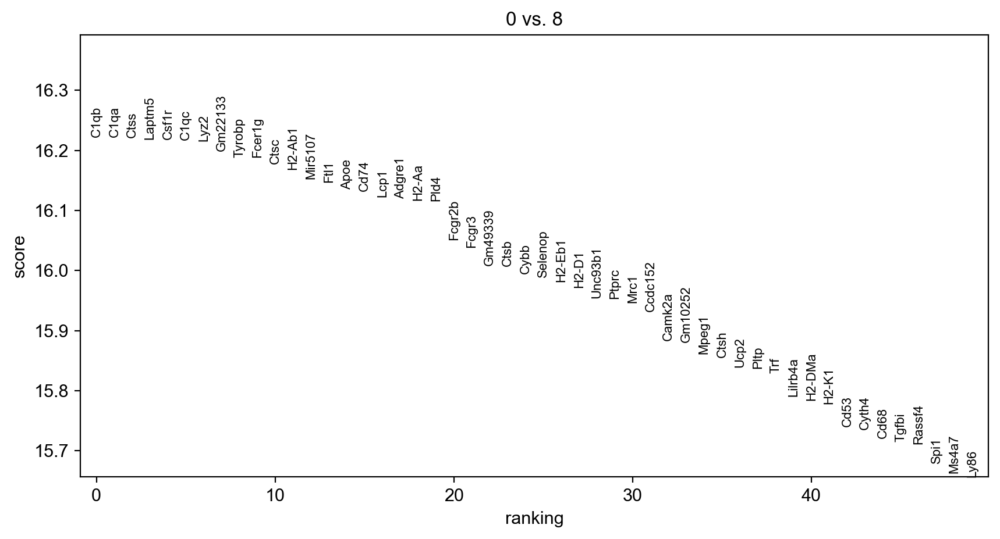

3477 sig_genes, with 1871 up and 1606 down


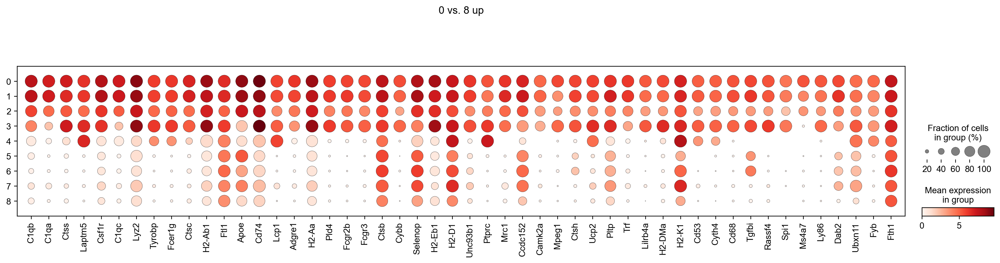

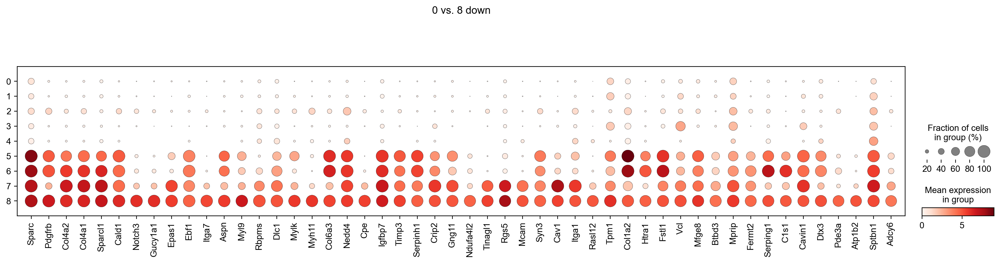

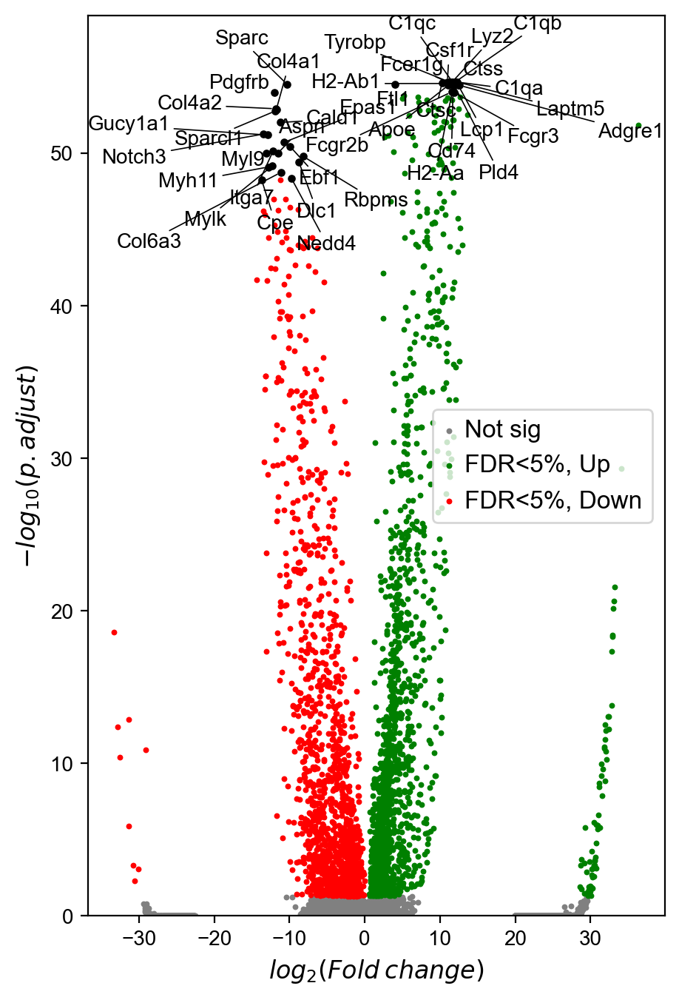

In [112]:
sig_genes_0_vs_8 = rank_and_string(adata_d21, '0', '8', 'cluster', proteins, extra_tag='', save_volcano=False, use_raw=True, 
                    work_dir=csv_dir, method='wilcoxon', n_genes=50, cutoff=0.05)

### 0vs1

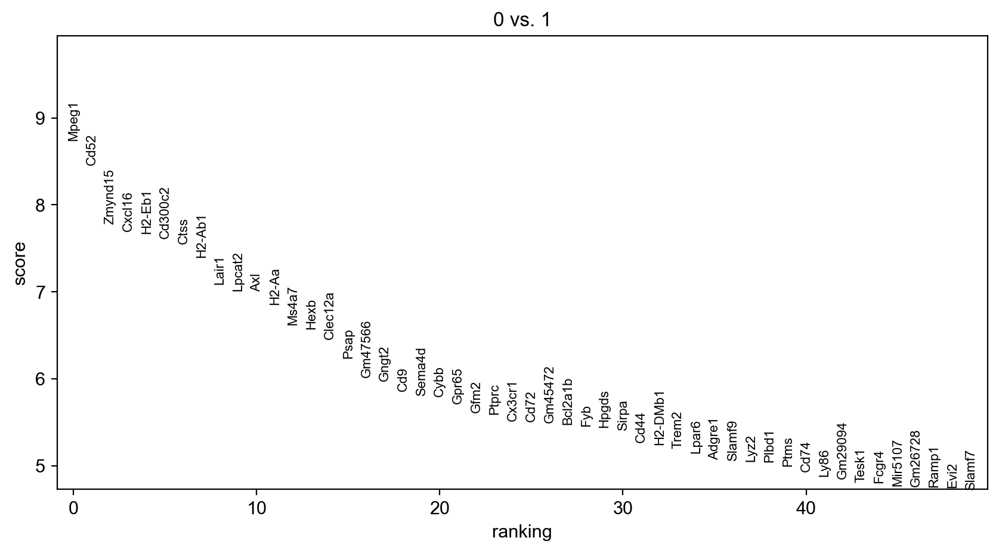

245 sig_genes, with 92 up and 153 down


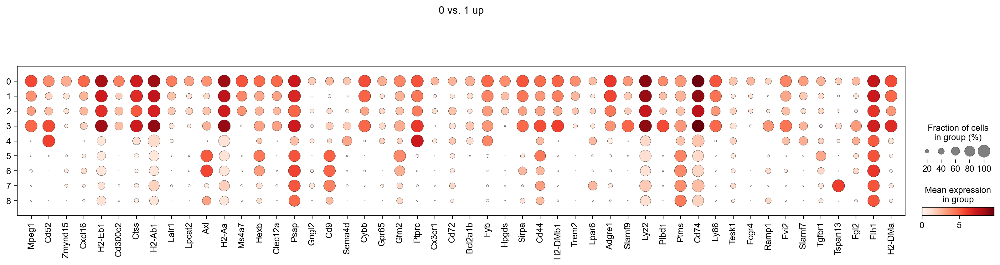

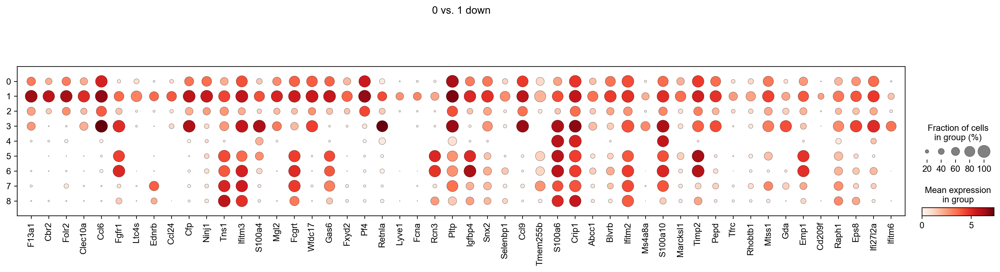

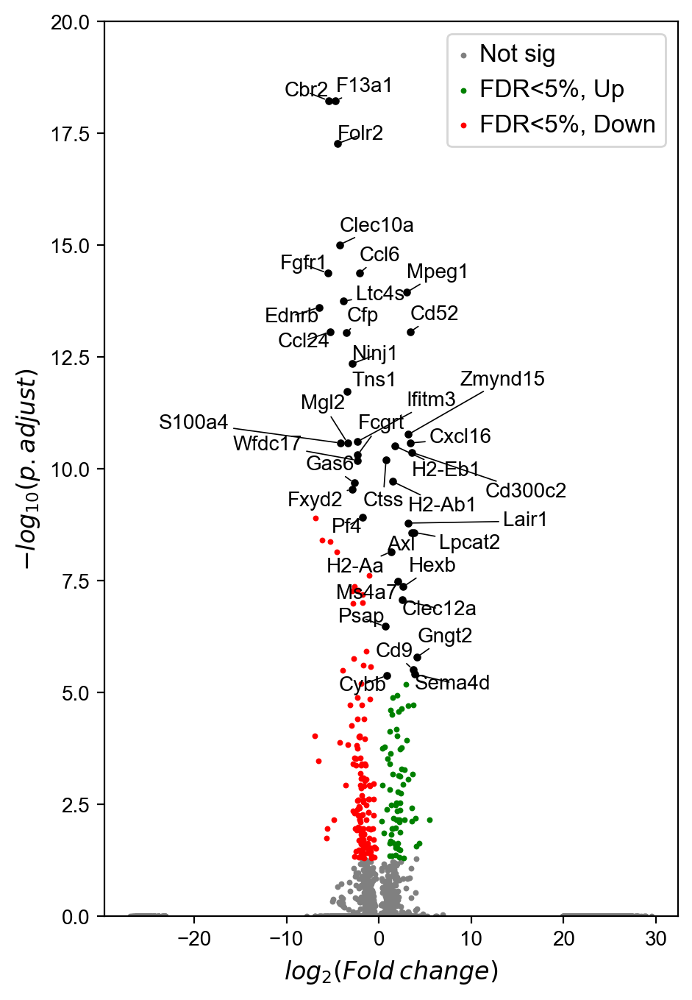

In [113]:
sig_genes_0_vs_1 = rank_and_string(adata_d21, '0', '1', 'cluster', proteins, extra_tag='', save_volcano=False, use_raw=True, 
                    work_dir=csv_dir, method='wilcoxon', n_genes=50, cutoff=0.05)

### 0vs5

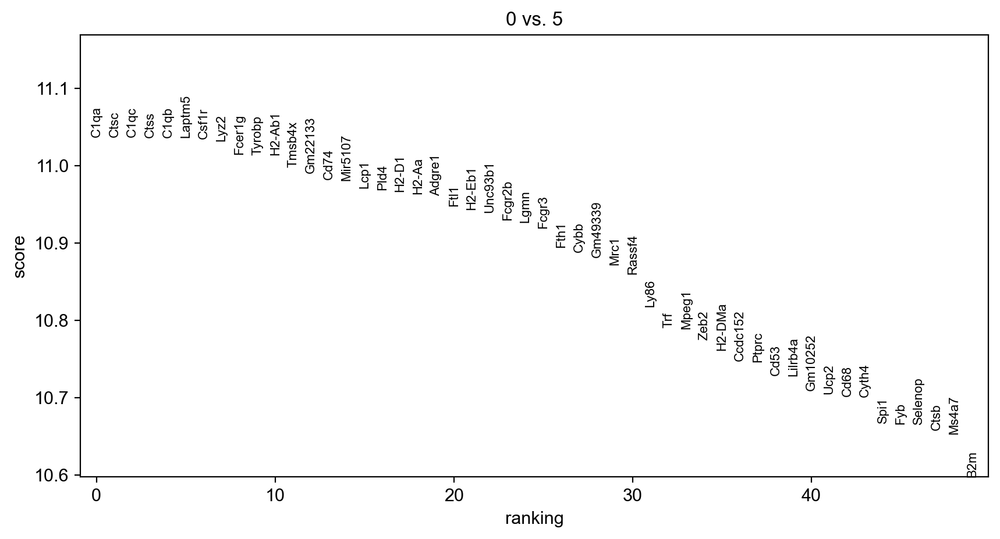

2536 sig_genes, with 1242 up and 1294 down


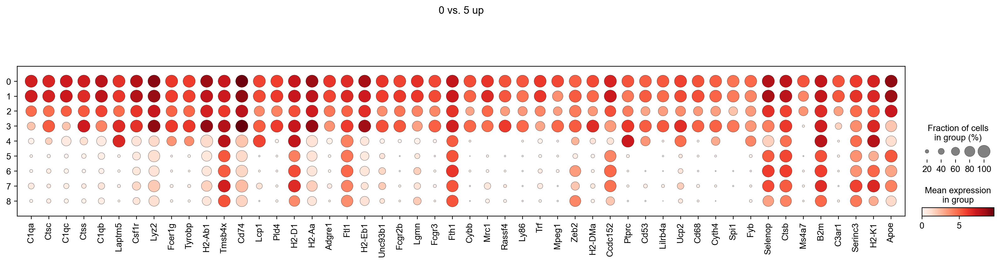

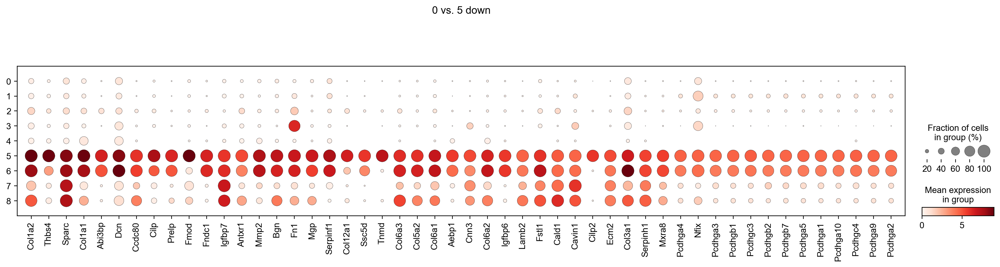

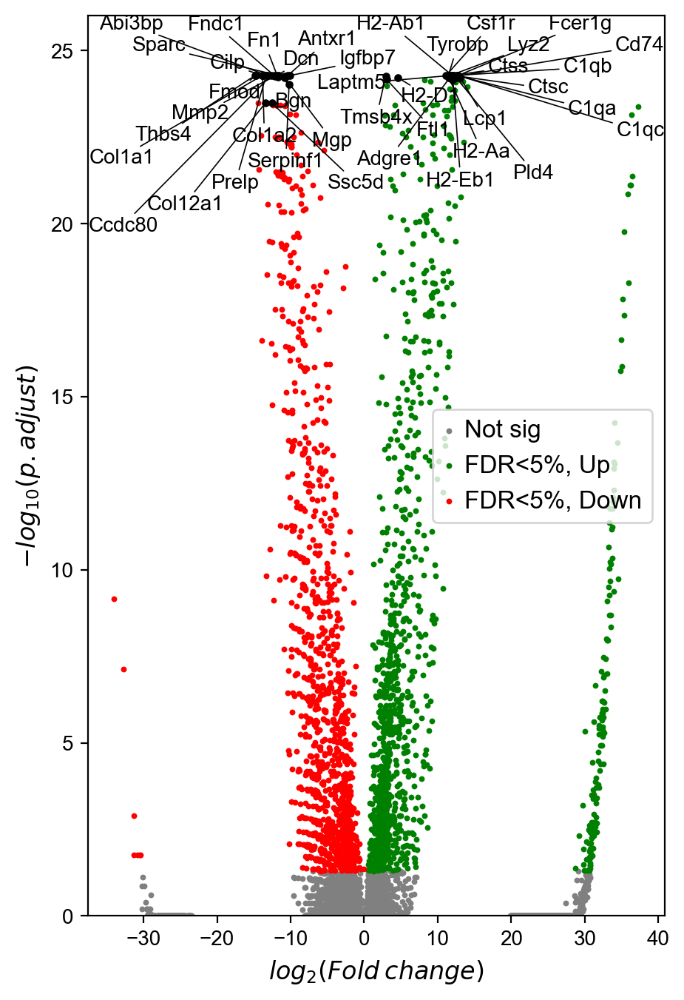

In [114]:
sig_genes_0_vs_5 = rank_and_string(adata_d21, '0', '5', 'cluster', proteins, extra_tag='', save_volcano=False, use_raw=True, 
                    work_dir=csv_dir, method='wilcoxon', n_genes=50, cutoff=0.05)

### 0vs6

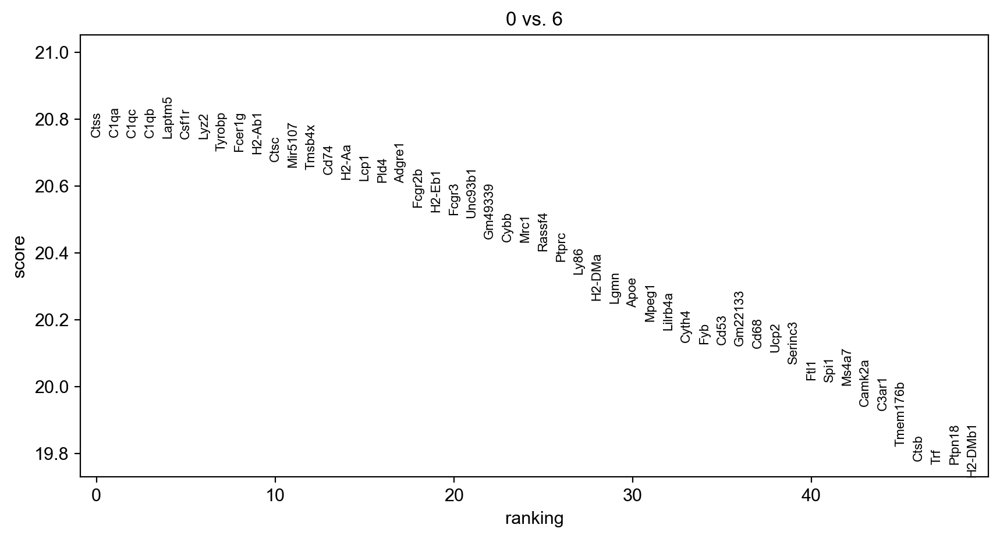

4804 sig_genes, with 1896 up and 2908 down


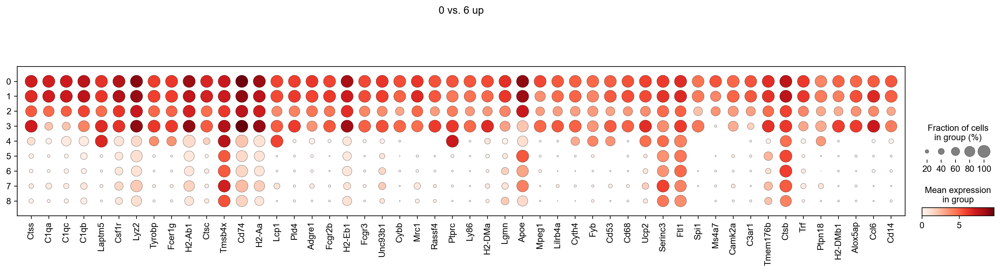

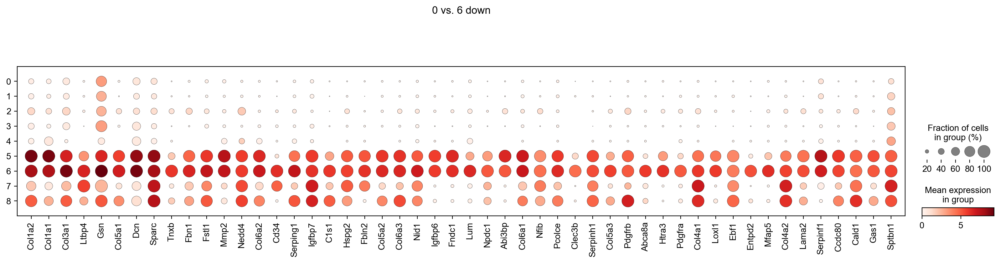

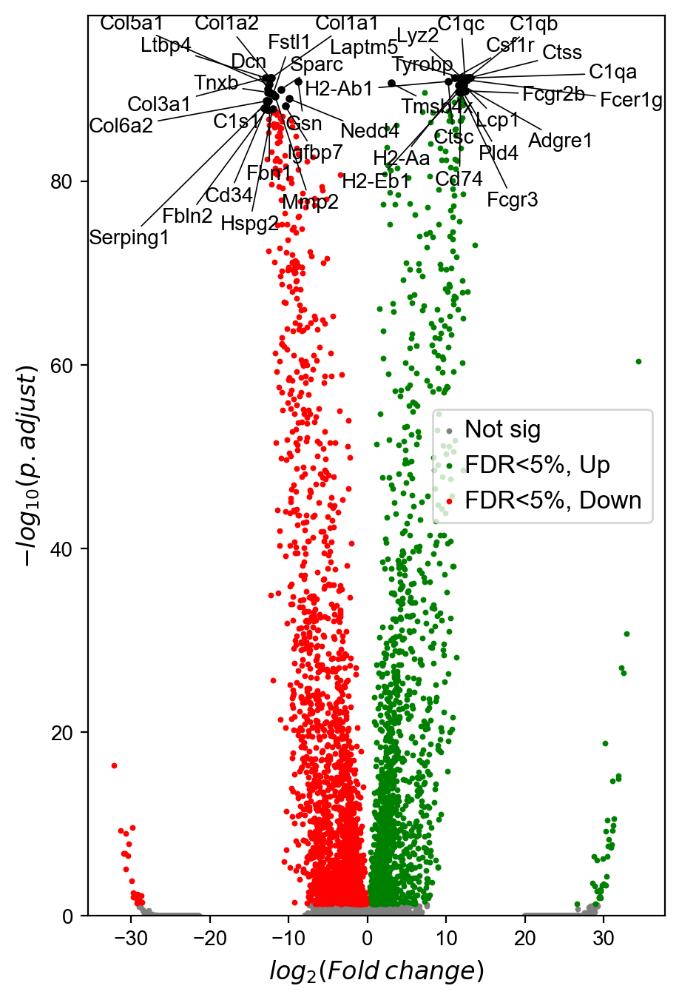

In [115]:
sig_genes_0_vs_6 = rank_and_string(adata_d21, '0', '6', 'cluster', proteins, extra_tag='', save_volcano=False, use_raw=True, 
                    work_dir=csv_dir, method='wilcoxon', n_genes=50, cutoff=0.05)

### Volcano plot

For 0vs2 comparison

In [116]:
sc.tl.rank_genes_groups(adata_d21, 'cluster', groups=['2'], 
                            reference='0', method='wilcoxon', use_raw=True) 
sig_genes = sc.get.rank_genes_groups_df(adata_d21, group='2')

In [117]:
sig_genes_sub = sig_genes[(abs(sig_genes['logfoldchanges']) <15) & (~sig_genes['names'].str.startswith('Gm'))]

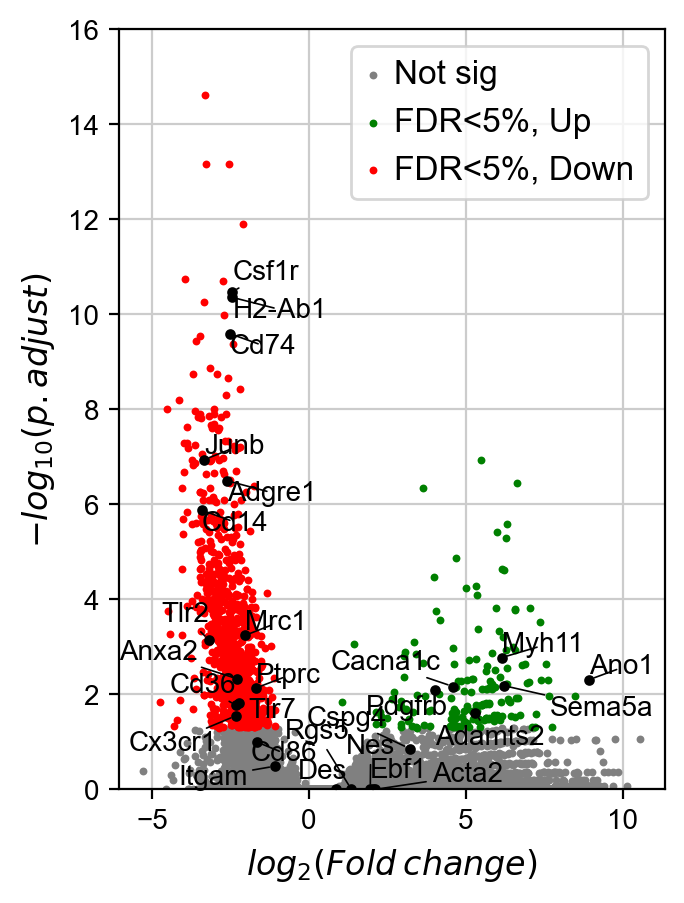

In [118]:
plot_volcano(sig_genes_sub, macrophage_genes + mural_cell_genes, adjust=True, figsize=(3.5,5))
plt.grid()
plt.savefig(fig_dir + 'volcano.pdf')

## Unspliced enrichment analysis

In [119]:
mat = adata_raw.layers['unspliced']/(adata_raw.layers['raw'] + adata_raw.layers['unspliced'] + 1e-12)
mat_df = pd.DataFrame(mat, columns=adata_raw.var_names)
mat_df['cluster'] = adata_raw.obs['cluster'].values
mat_df_mean = mat_df.groupby('cluster').mean()

0 [1.00, 0.80] 142
1 [1.00, 0.80] 187
2 [1.00, 0.80] 2700
3 [1.00, 0.80] 158
4 [1.00, 0.80] 364
5 [1.00, 0.80] 172
6 [1.00, 0.80] 167
7 [1.00, 0.80] 245
8 [1.00, 0.80] 201
9 [1.00, 0.80] 319


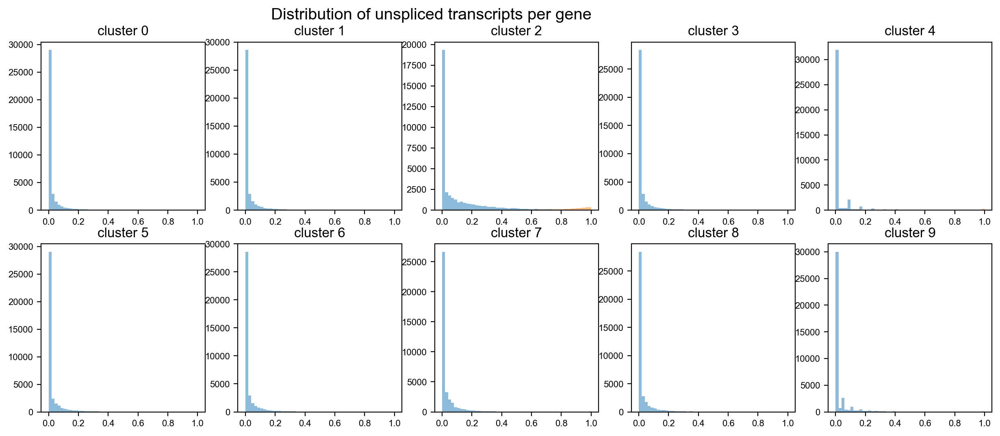

In [120]:
fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(15, 6)) 
plt.suptitle('Distribution of unspliced transcripts per gene')
for i, ax in zip(range(10), axs.ravel()):
    cluster_no = str(i)
    counts_s_per_gene = scv.utils.sum_obs(adata_raw[adata_raw.obs['cluster']==cluster_no].layers['spliced'])
    counts_s_per_gene_fc = scv.utils.sum_obs(adata_raw[adata_raw.obs['cluster']==cluster_no].X)
    counts_u_per_gene = scv.utils.sum_obs(adata_raw[adata_raw.obs['cluster']==cluster_no].layers['unspliced'])
    fractions_u_per_gene = counts_u_per_gene / (counts_s_per_gene + counts_u_per_gene)
    fractions_u_per_gene_fc = counts_u_per_gene / (counts_s_per_gene_fc + counts_u_per_gene)
    cluster_size = adata_raw[adata_raw.obs['cluster']==cluster_no].shape[0]
    percent_cells_s = scv.utils.sum_obs(adata_raw[adata_raw.obs['cluster']==cluster_no].layers['spliced']>0)/cluster_size
    percent_cells_s_fc = scv.utils.sum_obs(adata_raw[adata_raw.obs['cluster']==cluster_no].X>0)/cluster_size
    percent_cells_u = scv.utils.sum_obs(adata_raw[adata_raw.obs['cluster']==cluster_no].layers['unspliced']>0)/cluster_size

    
    # Construct data frame and do go enrichment analysis
    df = pd.DataFrame({'gene':adata_raw.var_names, 
                       'spliced':counts_s_per_gene,
                       'spliced_fc':counts_s_per_gene_fc,
                       'unspliced':counts_u_per_gene, 
                       'fraction':fractions_u_per_gene,
                       'fraction_fc':fractions_u_per_gene_fc,
                       'mean_fraction':mat_df_mean.loc[cluster_no, :], #based on featurecount
                       'percent_cells_spliced':percent_cells_s,
                       'percent_cells_spliced_fc':percent_cells_s_fc,
                       'percent_cells_unspliced':percent_cells_u})
    
    # Plot distribution before filtering
    #ax.hist(df['percent_cells_unspliced'], bins=30, alpha=0.5)
    #ax.hist(df['percent_cells_spliced'], bins=30, alpha=0.5)

    ax.hist(df['mean_fraction'], bins=50, alpha=0.5)
    ax.set_title('cluster %s' %cluster_no)
    ##ax.set_ylim(0, 1500)
    ax.tick_params(axis='both', which='major', labelsize=8)
    #plt.xlabel('Fraction of unspliced transcripts per gene')
    #plt.title('Distribution of unspliced transcripts per gene in cluster %s' %cluster_no)
    
    # Filter out genes with low total read count
    df = df.sort_values('fraction_fc', ascending=False, ignore_index=True)
    #df.to_csv('data/results/velocity/csv_rm/spliced_unsplied.cluster%s.raw.nofilter.csv' %cluster_no, index=False)
    df = df[(~df['gene'].str.match('^Gm\d+')) & (~df['gene'].str.match('.*Rik$', case=False))]
    #df = df[(df['spliced'] + df['unspliced'] >= 20) & (df['spliced']>=5) & (df['percent_cells_spliced']>=0.1)]
    df = df[df['mean_fraction'] >=0.3]
    df = df.sort_values('fraction_fc', ascending=False, ignore_index=True)
    df.to_csv(csv_dir + 'spliced_unsplied.cluster%s.raw.by_avg.csv' %cluster_no, index=False)
    
    ax.hist(df['fraction_fc'], bins=50, alpha=0.5)

    
    # Go enrichment analysis
    for max_a, min_a in [[1, 0.8]]: #, [0.8, 0]
        max_a_str = '%.2f' %(max_a)
        min_a_str = '%.2f' %(min_a)
        df_part = df[(df['fraction_fc'] >= min_a) & (df['fraction_fc'] <= max_a)]
        print('%s [%s, %s] %d' %(cluster_no, max_a_str, min_a_str, df_part.shape[0]))
        df_part.to_csv(csv_dir + '%s_vs_%s.%s.raw.by_avg.csv' %(max_a_str, min_a_str, cluster_no), index=False)
        #glist = list(df_part['gene'])
        #multi_enr_analysis(glist, work_dir='./data/results/velocity/csv_rm/', qry=max_a_str, ref=min_a_str, extra_tag=cluster_no+'.raw.by_avg.', cutoff=0.05, up_down='')
    
fig.savefig(fig_dir + 'distribution_per_cluster.by_avg.png')

### String

In [121]:
import os
for file in os.listdir(csv_dir):
    genes = pd.read_csv(csv_dir + file)
    if file.endswith('raw.by_avg.csv') and '_vs_' in file: #raw.by_avg.csv
        # unspliced genes
        print(file)
        prefix = file.split('.raw.by_avg.csv')[0]
        df = stringdb(list(genes['gene']))
        save_df(df, csv_dir, prefix, tag = '')


1.00_vs_0.80.0.raw.by_avg.csv
1.00_vs_0.80.8.raw.by_avg.csv
1.00_vs_0.80.7.raw.by_avg.csv
1.00_vs_0.80.6.raw.by_avg.csv
1.00_vs_0.80.9.raw.by_avg.csv
1.00_vs_0.80.1.raw.by_avg.csv
1.00_vs_0.80.3.raw.by_avg.csv
1.00_vs_0.80.4.raw.by_avg.csv
1.00_vs_0.80.5.raw.by_avg.csv
1.00_vs_0.80.2.raw.by_avg.csv


### Multi-dotplot

In [122]:
def prepare_df(df, comparison='', head_n=None):
    if 'gene_ratio' not in df.columns:
        df['gene_ratio'] = df['observed gene count'] / df['background gene count']
        df.rename(columns={'false discovery rate': 'pvals_adj', 
                           'term description': 'description',
                           'observed gene count': 'count'}, inplace=True)
    df = df.sort_values('pvals_adj', ascending=True)
    df['comparison'] = comparison
    if head_n:
        return(df.head(head_n))
    else:
        return(df)

In [123]:
#df_2_unspliced = pd.read_csv(string_dir + '1.00_vs_0.80.3.string.bp.csv') # Need to update
df_2_unspliced = pd.read_csv( csv_dir + '1.00_vs_0.80.2.string.bp.csv')

In [124]:
df_0_vs_1_down = pd.read_csv(csv_dir + '0_vs_1.string-down.bp.csv')
df_0_vs_2_down = pd.read_csv(csv_dir + '0_vs_2.string-down.bp.csv')
df_0_vs_5_down = pd.read_csv(csv_dir + '0_vs_5.string-down.bp.csv')
df_0_vs_6_down = pd.read_csv(csv_dir + '0_vs_6.string-down.bp.csv')
df_0_vs_8_down = pd.read_csv(csv_dir + '0_vs_8.string-down.bp.csv')

In [125]:
df_merged = pd.concat([prepare_df(df_2_unspliced, '2_unspliced'),
                       prepare_df(df_0_vs_8_down, '0_vs_8_down'),
                       prepare_df(df_0_vs_2_down, '0_vs_2_down')])
df_merged = df_merged.sort_values('pvals_adj', ascending=True)

In [126]:
df_merged = pd.concat([prepare_df(df_0_vs_1_down, '0_vs_1_down'),
                       prepare_df(df_0_vs_2_down, '0_vs_2_down'),
                       prepare_df(df_0_vs_5_down, '0_vs_5_down'),
                       prepare_df(df_0_vs_6_down, '0_vs_6_down'),
                       prepare_df(df_0_vs_8_down, '0_vs_8_down'),
                       prepare_df(df_2_unspliced, '2_unspliced')])
df_merged = df_merged.sort_values('pvals_adj', ascending=True)

In [127]:
go_to_plot = '''
Anatomical structure morphogenesis
Blood vessel development
Blood circulation
Blood vessel morphogenesis
Cell differentation
Cell Junction Organisation
Tube development
Tube Morphogenesis
Regulation of blood circulation
Aorta development
Cell communication
Calcium-mediated signaling
Cell morphogenesis involved in differentiation
Cell junction assembly
Cell-cell adhesion
'''
go_to_plot = go_to_plot.strip().split('\n')

In [128]:
# Look up terms to plot in df_merged
df_merged['description'] = df_merged['description'].str.capitalize()
df_to_plot = df_merged[df_merged['description'].isin(go_to_plot)]

In [129]:
df_to_plot['comparison'] = df_to_plot.comparison.astype('category').cat.\
    reorder_categories([ '0_vs_1_down', '0_vs_2_down', '0_vs_5_down', '0_vs_6_down', '0_vs_8_down', '2_unspliced'])

In [130]:
x = (ggplot(df_to_plot, aes(x = 'comparison', y = 'reorder(description, gene_ratio)')) 
        + geom_point(aes(size = 'gene_ratio', color = 'pvals_adj'))
        + theme_bw(base_size = 10) 
        + scale_colour_gradient(low="red") 
        + scale_size_continuous(breaks=[0.1,0.2])
        + xlab('')
        + ylab('')
        + ggtitle('')
        + scale_x_discrete(labels = ['1', '2', 'Tenocytes', 'FAPs', 'Pericytes', '2 w. unspliced'])
        + theme(axis_text_x=element_text(rotation=30, hjust=1, size=10))
        + theme(axis_text_y=element_text(size=10))
        + labs(size='Gene ratio', color='p.adjust')
        #+ coord_flip()
        + theme(legend_key_size=10,
                legend_key_width=4,
                legend_key_height=8,
                legend_text=element_text(size=10),
                legend_title=element_text(size=10)))
x.save(fig_dir + 'multi_dotplot_w_unspliced.pdf', format='pdf', width=3, height=2.8, dpi=300)

In [131]:
df_0_vs_1_up = pd.read_csv(csv_dir + '0_vs_1.string-up.bp.csv')
df_0_vs_2_up = pd.read_csv(csv_dir + '0_vs_2.string-up.bp.csv')
df_0_vs_5_up = pd.read_csv(csv_dir + '0_vs_5.string-up.bp.csv')
df_0_vs_6_up = pd.read_csv(csv_dir + '0_vs_6.string-up.bp.csv')
df_0_vs_8_up = pd.read_csv(csv_dir + '0_vs_8.string-up.bp.csv')

In [132]:
df_merged = pd.concat([prepare_df(df_0_vs_1_up, '0_vs_1_down'),
                       prepare_df(df_0_vs_2_up, '0_vs_2_down'),
                       prepare_df(df_0_vs_5_up, '0_vs_5_down'),
                       prepare_df(df_0_vs_6_up, '0_vs_6_down'),
                       prepare_df(df_0_vs_8_up, '0_vs_8_down')]) 
df_merged = df_merged.sort_values('pvals_adj', ascending=True)

In [133]:
go_to_plot2 = '''
Immune system process
Antigen processing and presentation
Immune response
Cytokine production
Cytokine secretion
Leukocyte activation
Leukocyte differentiation
Leukocyte chemotaxis
Chemotaxis
Myeloid cell activation involved in immune response
Myeloid cell differentiation
Myeloid leukocyte mediated immunity
'''
go_to_plot2 = go_to_plot2.strip().split('\n')

In [134]:
df_merged['description'] = df_merged['description'].str.capitalize()
df_to_plot2 = df_merged[df_merged['description'].isin(go_to_plot2)]

In [135]:
x = (ggplot(df_to_plot2, aes(x = 'comparison', y = 'reorder(description, gene_ratio)')) 
        + geom_point(aes(size = 'gene_ratio', color = 'pvals_adj'))
        + theme_bw(base_size = 10) 
        + scale_colour_gradient(low="red", breaks=[0.005, 0.01, 0.015])
        + scale_size_continuous(breaks=[0.2,0.5])     
        + ylab('')
        + xlab('')
        + ggtitle('')
        + scale_x_discrete(labels = ['1', '2', 'Tenocytes', 'FAPs', 'Pericytes'])
        + theme(axis_text_x=element_text(rotation=30, hjust=1, size=10))
        + theme(axis_text_y=element_text(size=10))
        + labs(size='Gene ratio', color='p.adjust')
        #+ coord_flip()
        + theme(legend_key_size=10,
                legend_key_width=4,
                legend_key_height=8,
                legend_text=element_text(size=10),
                legend_title=element_text(size=10)))
x.save(fig_dir + 'multi-dotplot-immune.pdf', format='pdf', width=3, height=2.8, dpi=300)

### Venn diagram

In [136]:
adata.uns['cluster_ct_colors']

array(['#1f77b4', '#d62728', '#aa40fc', '#ff7f0e', '#aec7e8', '#e377c2',
       '#b5bd61', '#279e68', '#8c564b', '#17becf'], dtype=object)

In [137]:
adata.uns['cluster_colors']

array(['#d62728', '#aa40fc', '#ff7f0e', '#1f77b4', '#e377c2', '#b5bd61',
       '#279e68', '#17becf', '#8c564b', '#aec7e8'], dtype=object)

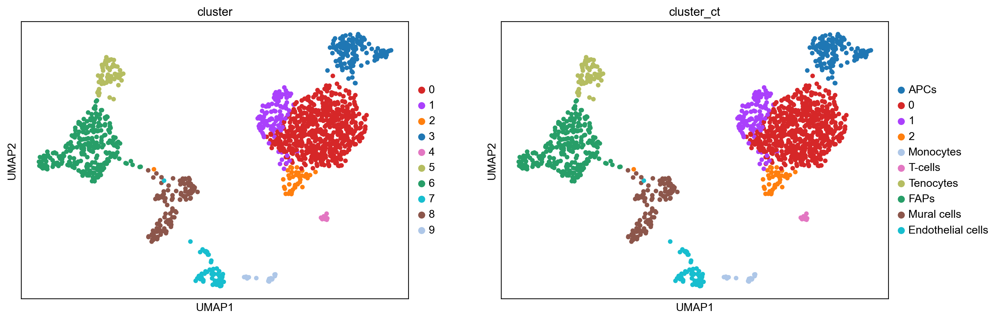

In [138]:
sc.pl.umap(adata, color=['cluster', 'cluster_ct'])

In [139]:
colors = adata.uns['cluster_colors']

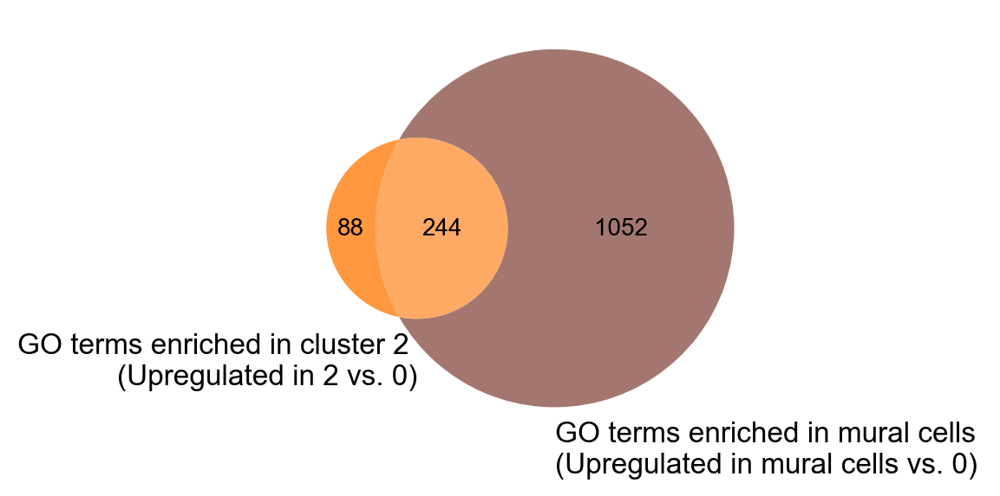

In [140]:
from matplotlib_venn import venn3, venn2
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 100, 'font.size':10, 'figure.frameon':False}):
    venn2([set(df_0_vs_2_down['#term ID']),set(df_0_vs_8_down['#term ID'])], 
          ('GO terms enriched in cluster 2 \n(Upregulated in 2 vs. 0)',
           'GO terms enriched in mural cells \n(Upregulated in mural cells vs. 0)'), 
          set_colors=(colors[2], colors[8]), alpha=0.8 )
    plt.savefig(fig_dir + 'venn_2_vs_8_down.pdf', bbox_inches='tight')

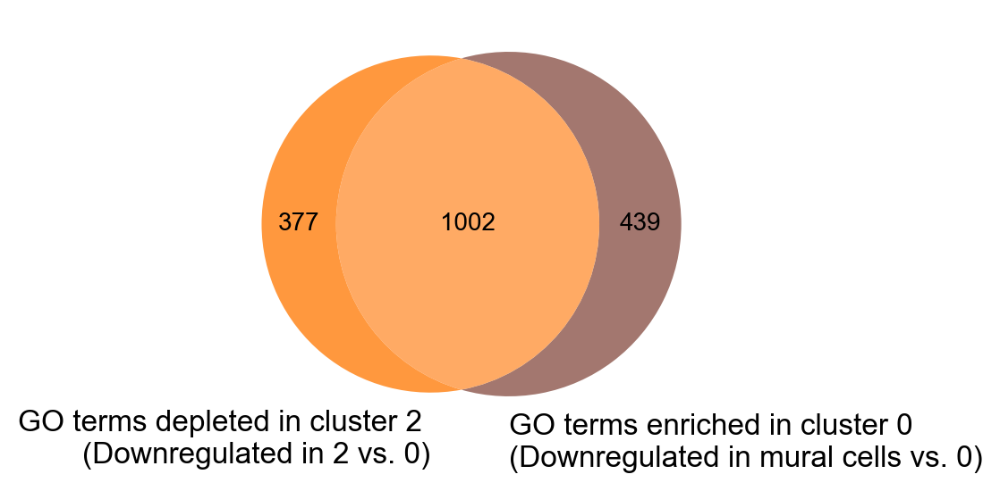

In [141]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 100, 'font.size':10, 'figure.frameon':False}):
    venn2([set(df_0_vs_2_up['#term ID']),set(df_0_vs_8_up['#term ID'])], 
          ('GO terms depleted in cluster 2 \n(Downregulated in 2 vs. 0)',
           'GO terms enriched in cluster 0 \n(Downregulated in mural cells vs. 0)'), 
          set_colors=(colors[2], colors[8]), alpha=0.8 )
    #plt.savefig(fig_dir + 'venn_2_vs_8_down.pdf', bbox_inches='tight')

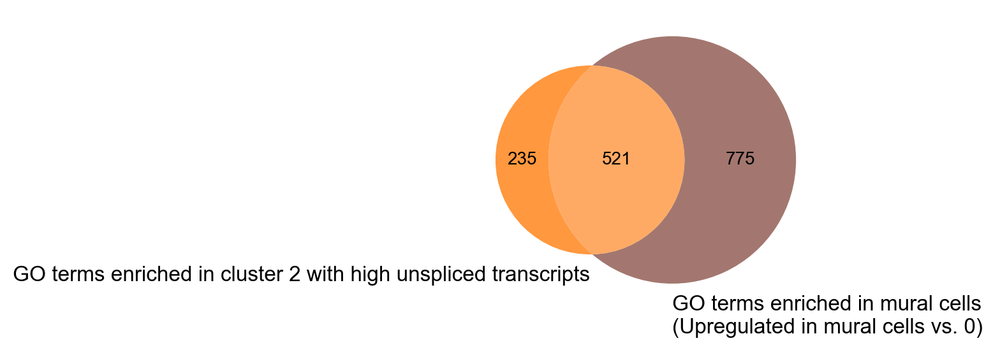

In [142]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 100, 'font.size':10, 'figure.frameon':False}):
    venn2([set(df_2_unspliced['#term ID']),set(df_0_vs_8_down['#term ID'])], 
          ('GO terms enriched in cluster 2 with high unspliced transcripts',
           'GO terms enriched in mural cells \n(Upregulated in mural cells vs. 0)'), 
          set_colors=(colors[2], colors[8]), alpha=0.8 )
    #plt.savefig(fig_dir + 'venn_2_vs_8_down.pdf', bbox_inches='tight')

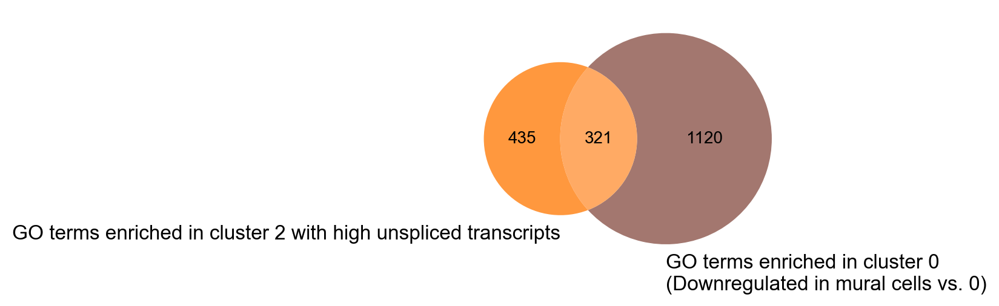

In [143]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 100, 'font.size':10, 'figure.frameon':False}):
    venn2([set(df_2_unspliced['#term ID']),set(df_0_vs_8_up['#term ID'])], 
          ('GO terms enriched in cluster 2 with high unspliced transcripts',
           'GO terms enriched in cluster 0 \n(Downregulated in mural cells vs. 0)'), 
          set_colors=(colors[2], colors[8]), alpha=0.8 )
 

In [144]:
top_n=150

In [149]:
df_0_vs_8_up

,#term ID,description,count,background gene count,p_value,pvals_adj,matching proteins in your network (IDs),matching proteins in your network (labels),gene_ratio
0,GO:0002376,immune system process,427,1703,5.230000e-83,4.510000e-79,"10090.ENSMUSP00000000137,10090.ENSMUSP00000000...","Actr2,Ccl2,Ccl12,Ifi202b,Itgb2,Pdgfb,Ccl3,Tyk2...",0.250734
1,GO:0050896,response to stimulus,925,6616,1.370000e-66,5.900000e-63,"10090.ENSMUSP00000000080,10090.ENSMUSP00000000...","Klf6,Actr2,Gna12,Ccl2,Ccl12,Ifi202b,Itgb2,Clec...",0.139813
2,GO:0065007,biological regulation,1230,10168,6.410000e-65,1.840000e-61,"10090.ENSMUSP00000000080,10090.ENSMUSP00000000...","Klf6,Actr2,Gna12,Ccl2,Ccl12,Ifi202b,Scpep1,Itg...",0.120968
3,GO:0050789,regulation of biological process,1168,9594,4.660000e-60,1.000000e-56,"10090.ENSMUSP00000000080,10090.ENSMUSP00000000...","Klf6,Actr2,Gna12,Ccl2,Ccl12,Ifi202b,Itgb2,Daza...",0.121743
4,GO:0002682,regulation of immune system process,293,1165,2.070000e-55,3.570000e-52,"10090.ENSMUSP00000000193,10090.ENSMUSP00000000...","Ccl2,Ccl12,Ifi202b,Itgb2,Ccl3,Cfp,Spi1,Tgfb1,A...",0.251502
...,...,...,...,...,...,...,...,...,...
1436,GO:1904754,positive regulation of vascular associated smo...,6,18,8.500000e-03,4.850000e-02,"10090.ENSMUSP00000000500,10090.ENSMUSP00000033...","Pdgfb,Pak1,Dock4,Atp7a,Myo5a,Iqgap1",0.333333
1437,GO:0032869,cellular response to insulin stimulus,22,143,8.600000e-03,4.870000e-02,"10090.ENSMUSP00000000193,10090.ENSMUSP00000003...","Ccl2,Rab8a,Inpp5k,Ndel1,Grb2,Got1,Baiap2,Parp1...",0.153846
1438,GO:0010811,positive regulation of cell-substrate adhesion,19,117,8.600000e-03,4.900000e-02,"10090.ENSMUSP00000001592,10090.ENSMUSP00000006...","Jup,Arpc2,Sdc4,Itga5,Nrp1,Itga6,Hsd17b12,Ninj1...",0.162393
1439,GO:0007163,establishment or maintenance of cell polarity,25,170,8.700000e-03,4.950000e-02,"10090.ENSMUSP00000000137,10090.ENSMUSP00000017...","Actr2,Cyth1,Ndel1,Parvb,Lrch4,Pak1,Ophn1,Nckap...",0.147059


In [150]:
union_8_up_down = set(df_0_vs_8_up['description'].head(top_n)) & set(df_0_vs_8_down['description'].head(top_n))
set1 = set(df_0_vs_8_up['description'].head(top_n)) - union_8_up_down
set2 = set(df_2_unspliced['description'].head(top_n)) - union_8_up_down
set3 = set(df_0_vs_8_down['description'].head(top_n)) - union_8_up_down

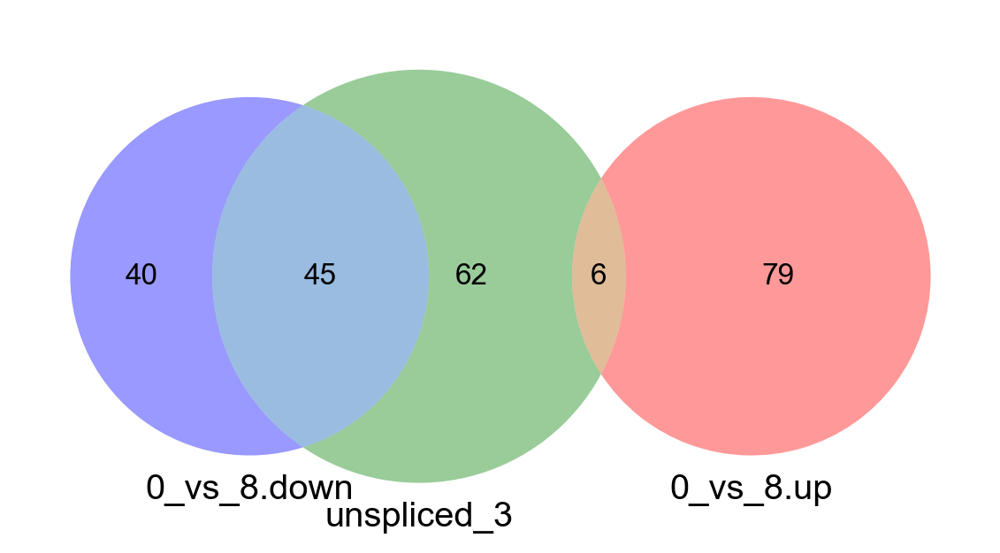

In [151]:
venn3([set1, set2, set3], 
      ('0_vs_8.up','unspliced_3', '0_vs_8.down'))

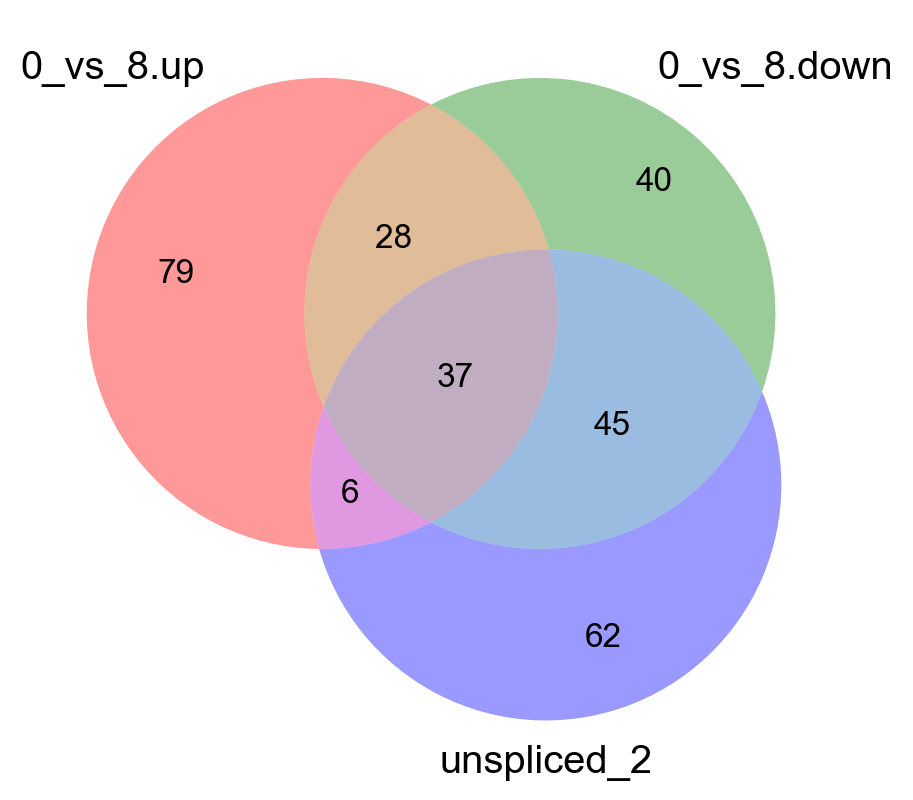

In [152]:
venn3([set(df_0_vs_8_up['description'].head(top_n)),
       set(df_0_vs_8_down['description'].head(top_n)),
       set(df_2_unspliced['description'].head(top_n))],
      ('0_vs_8.up', '0_vs_8.down', 'unspliced_2'))

In [153]:
colors

array(['#d62728', '#aa40fc', '#ff7f0e', '#1f77b4', '#e377c2', '#b5bd61',
       '#279e68', '#17becf', '#8c564b', '#aec7e8'], dtype=object)

In [154]:
colors_alpha = [c+'90' for c in colors]

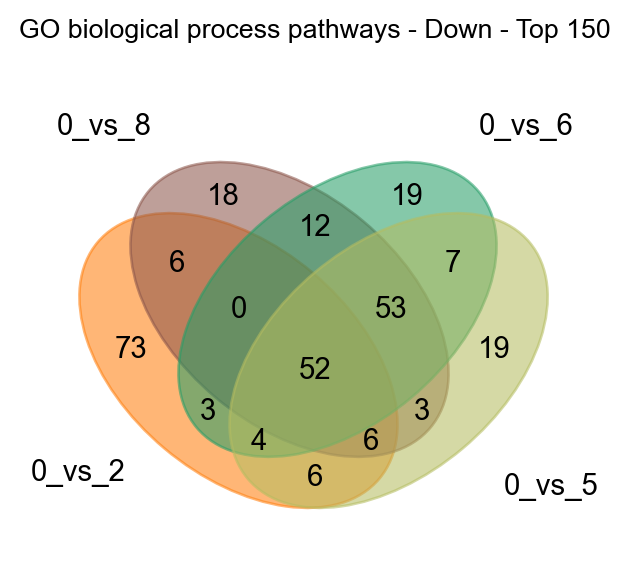

In [155]:
labels = venn.get_labels([
            df_0_vs_2_down.head(top_n)['#term ID'], 
            df_0_vs_8_down.head(top_n)['#term ID'], 
            df_0_vs_6_down.head(top_n)['#term ID'], 
            df_0_vs_5_down.head(top_n)['#term ID']], 
    fill=['number'])
fig, ax = venn.venn4(labels, names=['0_vs_2', '0_vs_8', '0_vs_6', '0_vs_5'], 
                     colors=[colors_alpha[2], colors_alpha[8], colors_alpha[6], colors_alpha[5]],
                     figsize=[3.5, 3.5], fontsize=11)
plt.title('GO biological process pathways - Down - Top 150', fontdict={'fontsize':10})
fig.savefig(fig_dir + 'venn4.pdf', dpi=300)

In [156]:
df_0_vs_8_down_old = pd.read_csv('data/results/string/0_vs_8.d21.string-down.tsv', delimiter='\t')
df_0_vs_2_down_old = pd.read_csv('data/results/string/0_vs_3.d21.string-down.tsv', delimiter='\t')
df_0_vs_6_down_old = pd.read_csv('data/results/string/0_vs_6.d21.string-down.tsv', delimiter='\t')
df_0_vs_5_down_old = pd.read_csv('data/results/string/0_vs_5.d21.string-down.tsv', delimiter='\t')

Text(0.5, 1.0, 'GO biological process pathways - Down - Top 150')

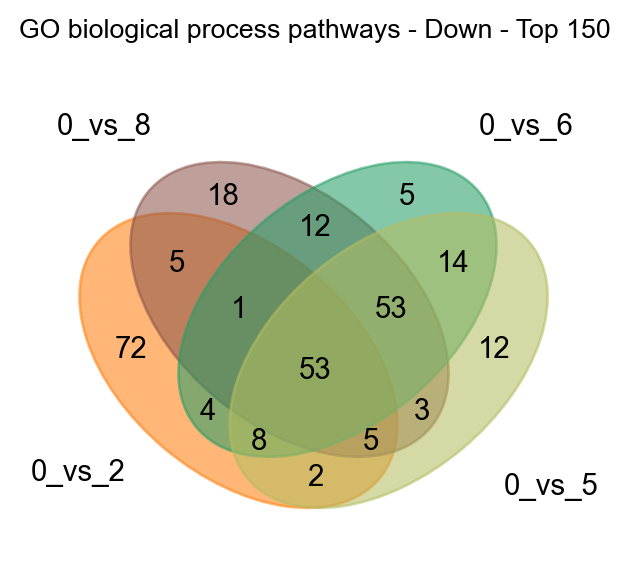

In [157]:
labels = venn.get_labels([
            df_0_vs_2_down_old.head(top_n)['#term ID'], 
            df_0_vs_8_down_old.head(top_n)['#term ID'], 
            df_0_vs_6_down_old.head(top_n)['#term ID'], 
            df_0_vs_5_down_old.head(top_n)['#term ID']], 
    fill=['number'])
fig, ax = venn.venn4(labels, names=['0_vs_2', '0_vs_8', '0_vs_6', '0_vs_5'], 
                     colors=[colors_alpha[2], colors_alpha[8], colors_alpha[6], colors_alpha[5]],
                     figsize=[3.5, 3.5], fontsize=11)
plt.title('GO biological process pathways - Down - Top 150', fontdict={'fontsize':10})

In [158]:
print(df_0_vs_8_down_old.shape, df_0_vs_8_down.shape)
print(df_0_vs_2_down_old.shape, df_0_vs_2_down.shape)
print(df_0_vs_6_down_old.shape, df_0_vs_6_down.shape)
print(df_0_vs_5_down_old.shape, df_0_vs_5_down.shape)

(1296, 8) (1296, 9)
(332, 8) (332, 9)
(1236, 8) (1186, 9)
(1066, 8) (1066, 9)


0_vs_6 gene list are the same, but string results are not. Running it manually revealved that its down list contain 2906 genes, and it was most likely reduced to 2000 for running the analysis, and the new string were sent via api and there is no size limit. Hence the difference. 

In [159]:
set(df_0_vs_8_down.head(top_n)['description']) & \
set(df_0_vs_6_down.head(top_n)['description']) & \
set(df_0_vs_5_down.head(top_n)['description']) & \
set(df_0_vs_2_down.head(top_n)['description'])

{'anatomical structure development',
 'anatomical structure formation involved in morphogenesis',
 'anatomical structure morphogenesis',
 'animal organ development',
 'animal organ morphogenesis',
 'biological regulation',
 'blood vessel development',
 'blood vessel morphogenesis',
 'cell adhesion',
 'cell communication',
 'cell development',
 'cell differentiation',
 'cell migration',
 'cellular component organization',
 'cellular process',
 'cellular response to stimulus',
 'circulatory system development',
 'developmental process',
 'embryo development',
 'generation of neurons',
 'heart development',
 'localization',
 'locomotion',
 'movement of cell or subcellular component',
 'multicellular organism development',
 'multicellular organismal process',
 'nervous system development',
 'plasma membrane bounded cell projection organization',
 'positive regulation of cellular process',
 'regulation of biological quality',
 'regulation of cell communication',
 'regulation of cell develop

In [160]:
set(df_0_vs_8_down.head(top_n)['description']) - \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_2_down.head(top_n)['description'])

{'head development',
 'muscle cell differentiation',
 'positive regulation of catalytic activity',
 'positive regulation of cell population proliferation',
 'positive regulation of intracellular signal transduction',
 'positive regulation of molecular function',
 'positive regulation of phosphate metabolic process',
 'positive regulation of phosphorylation',
 'positive regulation of protein phosphorylation',
 'regulation of RNA biosynthetic process',
 'regulation of RNA metabolic process',
 'regulation of actin filament-based process',
 'regulation of anatomical structure size',
 'regulation of nucleic acid-templated transcription',
 'regulation of nucleobase-containing compound metabolic process',
 'regulation of system process',
 'regulation of transport',
 'response to growth factor'}

In [161]:
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_8_down.head(top_n)['description']) - \
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_2_down.head(top_n)['description'])

{'cellular macromolecule metabolic process',
 'cellular metabolic process',
 'cellular protein metabolic process',
 'cellular protein modification process',
 'establishment of localization',
 'establishment of localization in cell',
 'extracellular structure organization',
 'macromolecule metabolic process',
 'metabolic process',
 'nitrogen compound metabolic process',
 'organic substance metabolic process',
 'organonitrogen compound metabolic process',
 'primary metabolic process',
 'protein metabolic process',
 'regulation of cellular biosynthetic process',
 'regulation of epithelial cell proliferation',
 'regulation of macromolecule biosynthetic process',
 'transport',
 'vesicle-mediated transport'}

In [162]:
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_8_down.head(top_n)['description']) - \
set(df_0_vs_2_down.head(top_n)['description'])

{'bone development',
 'cartilage development',
 'cellular response to endogenous stimulus',
 'collagen fibril organization',
 'connective tissue development',
 'embryonic organ development',
 'embryonic organ morphogenesis',
 'enzyme linked receptor protein signaling pathway',
 'kidney development',
 'negative regulation of cell population proliferation',
 'negative regulation of cellular component movement',
 'negative regulation of cellular metabolic process',
 'negative regulation of cellular response to growth factor stimulus',
 'negative regulation of metabolic process',
 'negative regulation of nitrogen compound metabolic process',
 'regulation of cell-substrate adhesion',
 'regulation of ossification',
 'response to wounding',
 'skeletal system morphogenesis'}

In [163]:
set(df_0_vs_2_down.head(top_n)['description']) - \
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_8_down.head(top_n)['description'])

{'action potential',
 'axon guidance',
 'axoneme assembly',
 'axonogenesis',
 'brain development',
 'calcium-mediated signaling',
 'camera-type eye development',
 'cell junction assembly',
 'cell junction organization',
 'cell morphogenesis involved in neuron differentiation',
 'cell-cell adhesion',
 'cell-matrix adhesion',
 'cell-substrate adhesion',
 'cell-substrate junction assembly',
 'cellular component assembly',
 'central nervous system development',
 'cerebral cortex tangential migration',
 'chemorepulsion involved in postnatal olfactory bulb interneuron migration',
 'chemotaxis',
 'chordate embryonic development',
 'cilium movement',
 'circulatory system process',
 'coronary vasculature development',
 'detection of abiotic stimulus',
 'detection of external stimulus',
 'detection of mechanical stimulus',
 'detection of mechanical stimulus involved in sensory perception',
 'detection of mechanical stimulus involved in sensory perception of sound',
 'developmental growth',
 'end

In [164]:
set(df_0_vs_2_down.head(top_n)['description']) & \
set(df_0_vs_8_down.head(top_n)['description']) - \
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_6_down.head(top_n)['description']) 

{'actin cytoskeleton organization',
 'actin filament-based process',
 'angiogenesis',
 'cytoskeleton organization',
 'intracellular signal transduction',
 'response to abiotic stimulus'}

In [165]:
set(df_0_vs_2_down.head(top_n)['description']) & \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_8_down.head(top_n)['description']) - \
set(df_0_vs_5_down.head(top_n)['description'])


{'cellular protein localization',
 'macromolecule localization',
 'protein localization'}

In [166]:
set(df_0_vs_2_down.head(top_n)['description']) & \
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_8_down.head(top_n)['description'])

{'cell morphogenesis',
 'cell morphogenesis involved in differentiation',
 'neuron development',
 'neuron projection development',
 'neuron projection morphogenesis',
 'sensory organ development'}

In [167]:
set(df_0_vs_8_down.head(top_n)['description']) & \
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_2_down.head(top_n)['description'])

{'muscle structure development',
 'regulation of cell adhesion',
 'response to endogenous stimulus'}

In [168]:
set(df_0_vs_5_down.head(top_n)['description']) & \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_2_down.head(top_n)['description']) - \
set(df_0_vs_8_down.head(top_n)['description'])

{'cellular response to organic substance',
 'extracellular matrix organization',
 'ossification',
 'positive regulation of cell differentiation',
 'positive regulation of cellular component organization',
 'renal system development',
 'urogenital system development'}

In [169]:
set(df_0_vs_8_down.head(top_n)['description']) & \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_2_down.head(top_n)['description']) - \
set(df_0_vs_5_down.head(top_n)['description']) 

{'positive regulation of cellular protein metabolic process',
 'positive regulation of protein metabolic process',
 'positive regulation of protein modification process',
 'regulation of biosynthetic process',
 'regulation of catalytic activity',
 'regulation of cellular protein metabolic process',
 'regulation of gene expression',
 'regulation of phosphate metabolic process',
 'regulation of phosphorylation',
 'regulation of protein metabolic process',
 'regulation of protein modification process',
 'regulation of protein phosphorylation'}

In [170]:
set(df_0_vs_8_down.head(top_n)['description']) & \
set(df_0_vs_2_down.head(top_n)['description']) & \
set(df_0_vs_5_down.head(top_n)['description']) - \
set(df_0_vs_6_down.head(top_n)['description'])

{'cell motility',
 'cellular component morphogenesis',
 'neuron differentiation',
 'regulation of cell morphogenesis',
 'supramolecular fiber organization',
 'tissue morphogenesis'}

In [171]:
set(df_0_vs_8_down.head(top_n)['description']) & \
set(df_0_vs_5_down.head(top_n)['description']) & \
set(df_0_vs_6_down.head(top_n)['description']) - \
set(df_0_vs_2_down.head(top_n)['description']) 

{'cardiovascular system development',
 'cell projection organization',
 'cell surface receptor signaling pathway',
 'cellular component organization or biogenesis',
 'cellular developmental process',
 'cellular response to chemical stimulus',
 'negative regulation of biological process',
 'negative regulation of cell communication',
 'negative regulation of cell differentiation',
 'negative regulation of cellular process',
 'negative regulation of developmental process',
 'negative regulation of multicellular organismal process',
 'negative regulation of response to stimulus',
 'negative regulation of signal transduction',
 'negative regulation of signaling',
 'neurogenesis',
 'positive regulation of biological process',
 'positive regulation of cell communication',
 'positive regulation of cell migration',
 'positive regulation of cell motility',
 'positive regulation of cellular component movement',
 'positive regulation of cellular metabolic process',
 'positive regulation of develo

## Origin

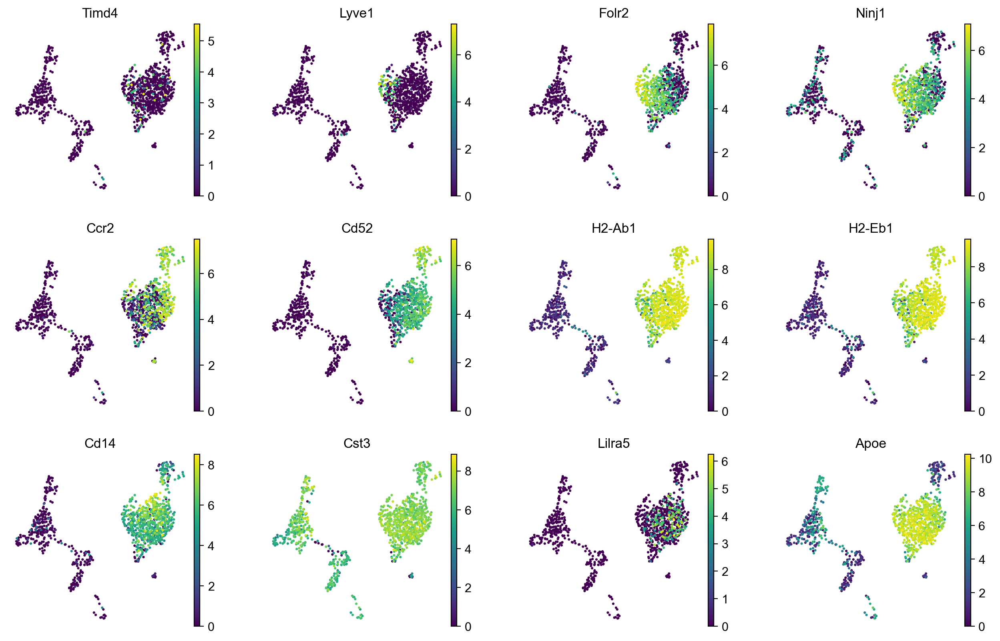

In [172]:
with plt.rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata_d21, color=['Timd4', 'Lyve1', 'Folr2', 'Ninj1', 
                             'Ccr2', 'Cd52', 'H2-Ab1', 'H2-Eb1', 
                             'Cd14', 'Cst3', 'Lilra5', 'Apoe'], 
            ncols=4, cmap='viridis', frameon=False, alpha=alpha, size=dotsize, save='_orgin_markers.d21')

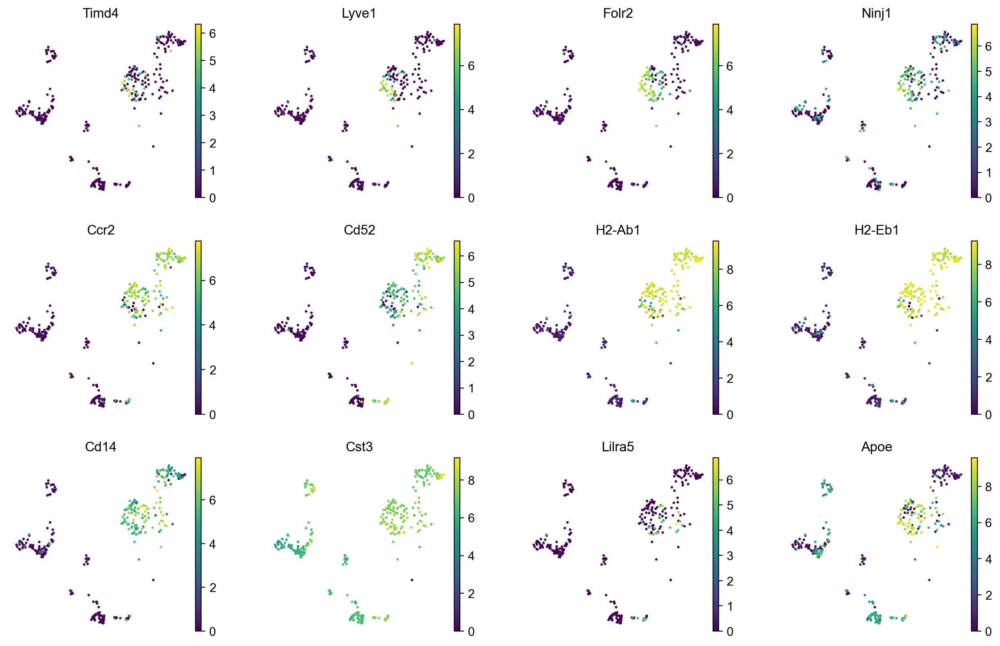

In [173]:
with plt.rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata_healthy, color=['Timd4', 'Lyve1', 'Folr2', 'Ninj1', 
                             'Ccr2', 'Cd52', 'H2-Ab1', 'H2-Eb1', 
                             'Cd14', 'Cst3', 'Lilra5', 'Apoe'], 
            ncols=4, cmap='viridis', frameon=False, alpha=alpha, size=dotsize, save='_orgin_markers.healthy')

In [174]:
origin_markers = {'$TLF^+$': ['Timd4', 'Lyve1', 'Folr2', 'Ninj1'], 
                  '$MHC-II^{hi}$': ['Cd14', 'Cst3', 'Lilra5', 'Apoe'],
                  '$CCR2^+$': ['Ccr2', 'Cd52', 'H2-Ab1', 'H2-Eb1'], 
                  }

In [175]:
adata_d21_macs = adata_d21[adata_d21.obs['cluster_ct'].isin(['0', '1', '2'])]

In [176]:
dp_d21_macs = sc.pl.dotplot(adata_d21_macs, origin_markers, groupby='cluster_ct', var_group_rotation=0, 
                        return_fig=True)

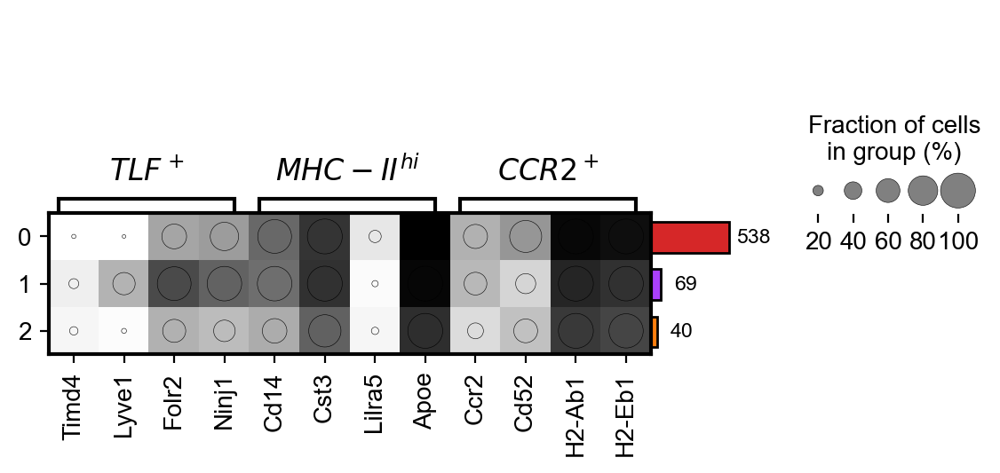

In [177]:
dp_d21_macs.add_totals(color=adata.uns['cluster_ct_colors'][1:4]).\
    style(color_on='square', cmap='binary').legend(show_colorbar=False).\
    savefig('./figures/macs_d21_dotplot.pdf')

In [178]:
adata_healthy_macs = adata_healthy[adata_healthy.obs['cluster_ct'].isin(['0', '1'])]

In [179]:
dp_healthy_macs = sc.pl.dotplot(adata_healthy_macs, origin_markers, groupby='cluster_ct', var_group_rotation=0, 
                        return_fig=True)

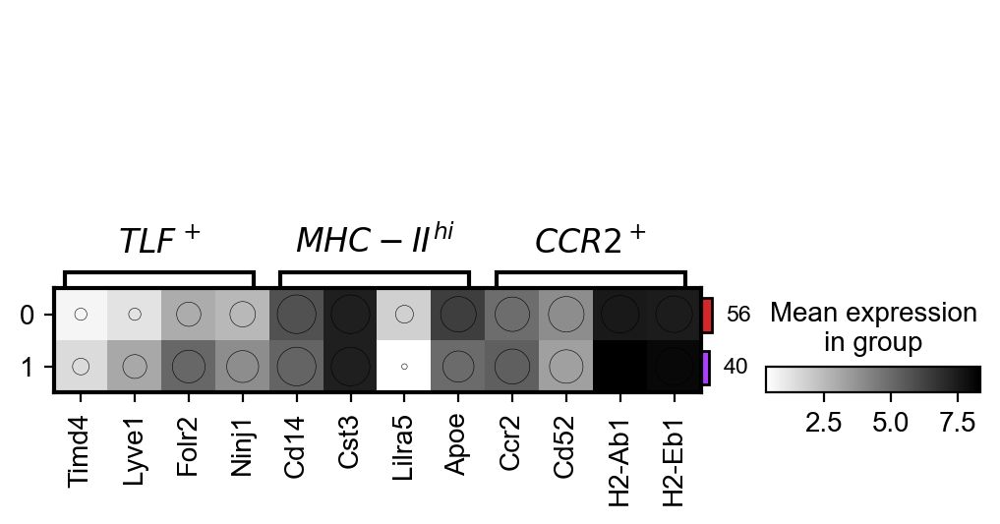

In [180]:
dp_healthy_macs.add_totals(color=adata.uns['cluster_ct_colors'][1:3], size=0.1).\
    style(color_on='square', cmap='binary').legend(show_size_legend=False).\
    savefig('./figures/macs_healthy_dotplot.pdf')

In [181]:
adata_macs = adata[adata.obs['cluster_ct'].isin(['0', '1', '2'])]

In [182]:
dp_macs = sc.pl.dotplot(adata_macs, origin_markers, groupby='cluster_ct', var_group_rotation=0, 
                        return_fig=True, figsize=(7,1.5))

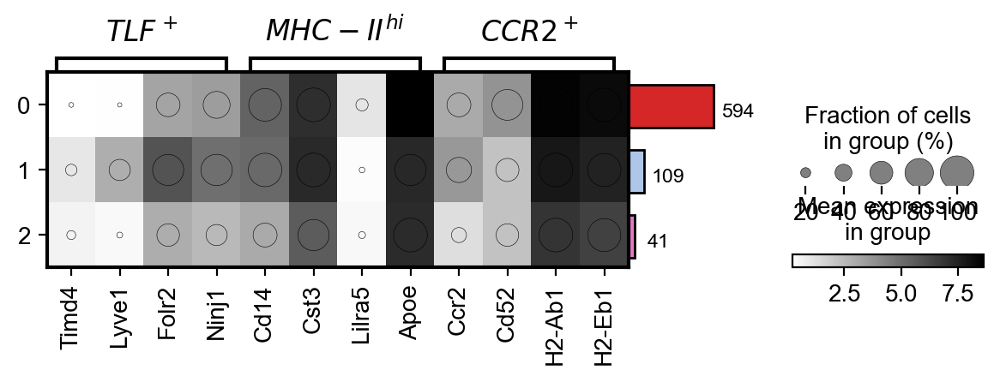

In [183]:
dp_macs.add_totals(color=adata.uns['cell_type_colors'][1:4]).style(color_on='square', cmap='binary').show()

## Cellxgene

In [185]:
adata

AnnData object with n_obs × n_vars = 1425 × 7421
    obs: 'year', 'plate', 'well', 'n_reads', 'n_mapped_reads', 'p_mapped_reads', 'n_reads_in_features', 'p_reads_in_features', 'n_multi_mapped_reads', 'p_multi_mapped_reads', 'n_short_unmapped_reads', 'p_short_unmapped_reads', 'p_other', 'sortdate', 'cell_identity', 'ischemia', 'marker', 'sex', 'sorting_batch', 'PDGFRB_MFI', 'GFP', 'tdtomato', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'percent_chrY', 'XIST-counts', 'contamination', 'n_counts', 'S_score', 'G2M_score', 'phase', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'leiden_1.0', 'leiden_0.6', 'leiden_0.4', 'leiden_1.4', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4', 'leiden_0.4_6_sub', 'leiden_0.4_6_0_sub', 'cluster', 'cluster_ct', 'cell_type'
    var: 'Chromosome', 'Source', 'gene_id', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', '

In [186]:
adata_raw

AnnData object with n_obs × n_vars = 1425 × 38178
    obs: 'total_counts', 'n_genes', 'sortdate', 'plate', 'well', 'cell_identity', 'ischemia', 'sex', 'tdtomato', 'pct_counts_mt', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'phase', 'doublet_scores', 'cell_type', 'cluster', 'cluster_ct', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'counts_spliced', 'counts_unspliced', 'counts_spliced_unspliced', 'fractions_unspliced'
    var: 'Chromosome', 'Source', 'gene_id', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'Accession', 'End', 'Start', 'Strand'
    uns: 'cell_type_colors', 'cluster_colors', 'cluster_ct_colors', 'ischemia_colors', 'tdtomato_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'ambiguous', 'matrix', 'raw', 'spanning', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

In [188]:
# normalized X
adata_cellxgene = sc.AnnData(X=adata.raw.X, 
                             obs=adata_raw.obs.drop(['initial_size_spliced', 'initial_size_unspliced', 'initial_size'], axis=1),
                             var = adata_raw.var[['Chromosome', 'gene_id', 'total_counts', 'n_cells']],
                             uns = adata_raw.uns,
                             obsm = adata_raw.obsm,
                             layers = {x:adata_raw.layers[x] for x in ['spliced', 'unspliced']}
                             )

In [189]:
adata_cellxgene

AnnData object with n_obs × n_vars = 1425 × 38178
    obs: 'total_counts', 'n_genes', 'sortdate', 'plate', 'well', 'cell_identity', 'ischemia', 'sex', 'tdtomato', 'pct_counts_mt', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'phase', 'doublet_scores', 'cell_type', 'cluster', 'cluster_ct', 'counts_spliced', 'counts_unspliced', 'counts_spliced_unspliced', 'fractions_unspliced'
    var: 'Chromosome', 'gene_id', 'total_counts', 'n_cells'
    uns: 'cell_type_colors', 'cluster_colors', 'cluster_ct_colors', 'ischemia_colors', 'tdtomato_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced'

In [190]:
adata_cellxgene.write_h5ad(h5ad_dir + 'adata.cellxgene.h5ad')

## Prepare GEO sumbmission 

In [191]:
adata_raw.obs

,total_counts,n_genes,sortdate,plate,well,cell_identity,ischemia,sex,tdtomato,pct_counts_mt,...,cell_type,cluster,cluster_ct,initial_size_spliced,initial_size_unspliced,initial_size,counts_spliced,counts_unspliced,counts_spliced_unspliced,fractions_unspliced
prefix,,,,,,,,,,,,,,,,,,,,,
SS2_19_276_A10,369363.0,3669,2019_09_18,276,A10,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,1.143320,...,Macrophages,0,0,258598,111961,258598.0,258597,111899,370496,0.302025
SS2_19_276_A11,317828.0,4739,2019_09_18,276,A11,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,1.805064,...,Macrophages,0,0,215376,117532,215376.0,215252,117422,332674,0.352964
SS2_19_276_A12,320419.0,4363,2019_09_18,276,A12,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,2.720188,...,APCs,3,APCs,211080,112077,211080.0,211074,111930,323004,0.346528
SS2_19_276_A13,188874.0,2777,2019_09_18,276,A13,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,2.945350,...,T-cells,4,T-cells,116651,90999,116651.0,116612,90764,207376,0.437678
SS2_19_276_A14,357038.0,4027,2019_09_18,276,A14,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,2.099216,...,Macrophages,0,0,241982,123827,241982.0,241980,123609,365589,0.338109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS2_20_033_O8,420127.0,4450,2020_06_24,33,O8,D21_tdtomato_plus_GFP_plus,D21,female,plus,3.825272,...,Macrophages,0,0,289273,79064,289273.0,289273,79008,368281,0.214532
SS2_20_033_O9,423589.0,4076,2020_06_24,33,O9,D21_tdtomato_plus_GFP_plus,D21,female,plus,3.811950,...,Macrophages,0,0,298292,73514,298292.0,298292,73416,371708,0.197510
SS2_20_033_P20,517963.0,4200,2020_06_24,33,P20,D21_tdtomato_plus_GFP_plus,D21,female,plus,4.205320,...,Macrophages,0,0,354643,106722,354643.0,354643,106646,461289,0.231191


In [192]:
adata_raw.X

array([[  0.,   0.,   0., ...,   0.,   0.,   3.],
       [  0.,   0.,   0., ...,   0.,   0.,  79.],
       [  0.,   0.,   0., ...,   0.,   0.,  13.],
       ...,
       [  0.,   0.,   0., ...,   0.,   0., 120.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   4.]], dtype=float32)

In [193]:
adata

AnnData object with n_obs × n_vars = 1425 × 7421
    obs: 'year', 'plate', 'well', 'n_reads', 'n_mapped_reads', 'p_mapped_reads', 'n_reads_in_features', 'p_reads_in_features', 'n_multi_mapped_reads', 'p_multi_mapped_reads', 'n_short_unmapped_reads', 'p_short_unmapped_reads', 'p_other', 'sortdate', 'cell_identity', 'ischemia', 'marker', 'sex', 'sorting_batch', 'PDGFRB_MFI', 'GFP', 'tdtomato', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'percent_chrY', 'XIST-counts', 'contamination', 'n_counts', 'S_score', 'G2M_score', 'phase', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'leiden_1.0', 'leiden_0.6', 'leiden_0.4', 'leiden_1.4', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4', 'leiden_0.4_6_sub', 'leiden_0.4_6_0_sub', 'cluster', 'cluster_ct', 'cell_type'
    var: 'Chromosome', 'Source', 'gene_id', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', '

In [194]:
# Raw counts
counts_file = data_dir + 'counts.txt'
counts_df = pd.read_csv(counts_file, sep=' ', skiprows=1, index_col=0).dropna(axis=1)

In [195]:
counts_df.shape

(55487, 1536)

In [196]:
counts_df = counts_df.rename(columns=lambda x: x.split('.sorted.bam')[0]).transpose()

In [197]:
sample_info_file = data_dir + 'sampleinfo.csv'
sample_info = pd.read_csv(sample_info_file, sep=',', header=0, index_col=False)
sample_info.head()

,rownames,sortdate,cell_identity,ischemia,marker,sex,sorting_batch,plate_id,PDGFRB_MFI
0,A1,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,1375.668366
1,A2,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,1653.849069
2,A3,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,924.568909
3,A4,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,443.811235
4,A5,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,445.761094


In [198]:
tdtomato = []
for x in sample_info['cell_identity']:
    arr = x.split('_')
    if len(arr) >1:
        tdtomato.append(arr[2])
    else:
        tdtomato.append('blank')

sample_info['tdtomato'] = tdtomato

In [199]:
sample_info

,rownames,sortdate,cell_identity,ischemia,marker,sex,sorting_batch,plate_id,PDGFRB_MFI,tdtomato
0,A1,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,1375.668366,plus
1,A2,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,1653.849069,plus
2,A3,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,924.568909,plus
3,A4,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,443.811235,plus
4,A5,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,445.761094,plus
...,...,...,...,...,...,...,...,...,...,...
1531,P20,2020_06_24,Healthy_tdtomato_plus_GFP_plusminus,healthy,tdtomato_plus_GFP_plusminus,female,2,31,120.879804,plus
1532,P21,2020_06_24,Healthy_tdtomato_plus_GFP_plusminus,healthy,tdtomato_plus_GFP_plusminus,female,2,31,348.825375,plus
1533,P22,2020_06_24,Healthy_tdtomato_plus_GFP_plusminus,healthy,tdtomato_plus_GFP_plusminus,female,2,31,-850.127300,plus
1534,P23,2020_06_24,blank,blank,blank,blank,2,31,NaN,blank


In [200]:
sample_info['index'] = ['SS2_%s_%03d_%s' %(y[2:4], z, x) for x, y, z in zip(sample_info['rownames'], sample_info['sortdate'], sample_info['plate_id'])]
sample_info = sample_info.set_index('index')
sample_info

,rownames,sortdate,cell_identity,ischemia,marker,sex,sorting_batch,plate_id,PDGFRB_MFI,tdtomato
index,,,,,,,,,,
SS2_19_276_A1,A1,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,1375.668366,plus
SS2_19_276_A2,A2,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,1653.849069,plus
SS2_19_276_A3,A3,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,924.568909,plus
SS2_19_276_A4,A4,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,443.811235,plus
SS2_19_276_A5,A5,2019_09_18,D21_tdtomato_plus_GFP_plusminus,D21,tdtomato_plus_GFP_plusminus,male,1,276,445.761094,plus
...,...,...,...,...,...,...,...,...,...,...
SS2_20_031_P20,P20,2020_06_24,Healthy_tdtomato_plus_GFP_plusminus,healthy,tdtomato_plus_GFP_plusminus,female,2,31,120.879804,plus
SS2_20_031_P21,P21,2020_06_24,Healthy_tdtomato_plus_GFP_plusminus,healthy,tdtomato_plus_GFP_plusminus,female,2,31,348.825375,plus
SS2_20_031_P22,P22,2020_06_24,Healthy_tdtomato_plus_GFP_plusminus,healthy,tdtomato_plus_GFP_plusminus,female,2,31,-850.127300,plus


In [201]:
sample_info = sample_info.rename(columns={'rownames':'well', 'plate_id':'plate'})

In [202]:
sample_info = sample_info.drop(['marker', 'sorting_batch', 'PDGFRB_MFI'], axis=1)

In [203]:
cols = sample_info.columns.tolist()
cols

['well', 'sortdate', 'cell_identity', 'ischemia', 'sex', 'plate', 'tdtomato']

In [204]:
cols = [cols[1]] + [cols[5]] + [cols[0]] + cols[2:5] + [cols[6]] 
cols

['sortdate', 'plate', 'well', 'cell_identity', 'ischemia', 'sex', 'tdtomato']

In [205]:
sample_info = sample_info[cols]
sample_info.head()

,sortdate,plate,well,cell_identity,ischemia,sex,tdtomato
index,,,,,,,
SS2_19_276_A1,2019_09_18,276,A1,D21_tdtomato_plus_GFP_plusminus,D21,male,plus
SS2_19_276_A2,2019_09_18,276,A2,D21_tdtomato_plus_GFP_plusminus,D21,male,plus
SS2_19_276_A3,2019_09_18,276,A3,D21_tdtomato_plus_GFP_plusminus,D21,male,plus
SS2_19_276_A4,2019_09_18,276,A4,D21_tdtomato_plus_GFP_plusminus,D21,male,plus
SS2_19_276_A5,2019_09_18,276,A5,D21_tdtomato_plus_GFP_plusminus,D21,male,plus


In [206]:
counts_df.head()

Geneid,ENSMUSG00000102693.1,ENSMUSG00000064842.1,ENSMUSG00000051951.5,ENSMUSG00000102851.1,ENSMUSG00000103377.1,ENSMUSG00000104017.1,ENSMUSG00000103025.1,ENSMUSG00000089699.1,ENSMUSG00000103201.1,ENSMUSG00000103147.1,...,ENSMUSG00000096550.1,ENSMUSG00000094172.1,ENSMUSG00000094887.1,ENSMUSG00000091585.2,ENSMUSG00000095763.1,ENSMUSG00000095523.1,ENSMUSG00000095475.1,ENSMUSG00000094855.1,ENSMUSG00000095019.1,ENSMUSG00000095041.7
SS2_19_276_A10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
SS2_19_276_A11,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,79
SS2_19_276_A12,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
SS2_19_276_A13,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,12
SS2_19_276_A14,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [207]:
counts_df = counts_df.reindex(index=sample_info.index)

In [209]:
adata_initial = sc.AnnData(counts_df, obs=sample_info)

In [211]:
adata_initial = adata_initial[adata_initial.obs['cell_identity'] != 'blank']
adata_initial.shape

(1509, 55487)

In [212]:
gtf_file = data_dir + 'gencode.vM25.primary_assembly.annotation.gtf'
genes = pr.read_gtf(gtf_file, as_df = True)
#genes = genes.df
genes.head()

,Chromosome,Source,Feature,Start,End,Score,Strand,Frame,gene_id,gene_type,...,transcript_type,transcript_name,transcript_support_level,tag,havana_transcript,exon_number,exon_id,protein_id,ccdsid,ont
0,chr1,HAVANA,gene,3073252,3074322,.,+,.,ENSMUSG00000102693.1,TEC,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,chr1,HAVANA,transcript,3073252,3074322,.,+,.,ENSMUSG00000102693.1,TEC,...,TEC,4933401J01Rik-201,NA,basic,OTTMUST00000127109.1,NaN,NaN,NaN,NaN,NaN
2,chr1,HAVANA,exon,3073252,3074322,.,+,.,ENSMUSG00000102693.1,TEC,...,TEC,4933401J01Rik-201,NA,basic,OTTMUST00000127109.1,1,ENSMUSE00001343744.1,NaN,NaN,NaN
3,chr1,ENSEMBL,gene,3102015,3102125,.,+,.,ENSMUSG00000064842.1,snRNA,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,chr1,ENSEMBL,transcript,3102015,3102125,.,+,.,ENSMUSG00000064842.1,snRNA,...,snRNA,Gm26206-201,NA,basic,NaN,NaN,NaN,NaN,NaN,NaN


In [213]:
genes = genes[genes['Feature'] == 'gene']

In [214]:
adata_initial.var

""
Geneid
ENSMUSG00000102693.1
ENSMUSG00000064842.1
ENSMUSG00000051951.5
ENSMUSG00000102851.1
ENSMUSG00000103377.1
...
ENSMUSG00000095523.1
ENSMUSG00000095475.1
ENSMUSG00000094855.1


In [215]:
genes = genes[['Chromosome', 'Source', 'gene_id', 'gene_name', 'gene_type']].set_index('gene_name')

In [216]:
adata_initial.var = genes

In [217]:
adata_initial.var

,Chromosome,Source,gene_id,gene_type
gene_name,,,,
4933401J01Rik,chr1,HAVANA,ENSMUSG00000102693.1,TEC
Gm26206,chr1,ENSEMBL,ENSMUSG00000064842.1,snRNA
Xkr4,chr1,HAVANA,ENSMUSG00000051951.5,protein_coding
Gm18956,chr1,HAVANA,ENSMUSG00000102851.1,processed_pseudogene
Gm37180,chr1,HAVANA,ENSMUSG00000103377.1,TEC
...,...,...,...,...
AC124606.1,JH584299.1,ENSEMBL,ENSMUSG00000095523.1,protein_coding
AC133095.2,JH584299.1,ENSEMBL,ENSMUSG00000095475.1,protein_coding
AC133095.1,JH584299.1,ENSEMBL,ENSMUSG00000094855.1,protein_coding


In [218]:
adata_initial.T.to_df().to_csv(submission_dir + 'matrix.csv')

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


In [219]:
cols_y = []
cols_x_d = {}
for col in cols:
    cols_y.append(col + '_y')
    cols_x_d.update({col + '_x' : col}) 

In [220]:
meta_df = pd.merge(adata_initial.obs, adata_raw.obs.drop(['initial_size_spliced', 'initial_size_unspliced', 'initial_size'], axis=1), 
                   how='left', left_index=True, right_index=True)
meta_df = meta_df.drop(cols_y, axis=1)
meta_df = meta_df.rename(columns=cols_x_d)
meta_df = meta_df.replace({'healthy':'Healthy'})
meta_df

,sortdate,plate,well,cell_identity,ischemia,sex,tdtomato,total_counts,n_genes,pct_counts_mt,...,G2M_score,phase,doublet_scores,cell_type,cluster,cluster_ct,counts_spliced,counts_unspliced,counts_spliced_unspliced,fractions_unspliced
index,,,,,,,,,,,,,,,,,,,,,
SS2_19_276_A1,2019_09_18,276,A1,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,312758.0,3579.0,1.398206,...,39.729229,G2M,0.112329,Macrophages,0,0,210873.0,121986.0,332859.0,0.366480
SS2_19_276_A2,2019_09_18,276,A2,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,489310.0,4470.0,1.073757,...,4.228100,G2M,0.213974,Macrophages,0,0,356467.0,41232.0,397699.0,0.103676
SS2_19_276_A3,2019_09_18,276,A3,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,149451.0,3882.0,2.190685,...,31.474674,G2M,0.054348,Macrophages,2,2,93086.0,113903.0,206989.0,0.550285
SS2_19_276_A4,2019_09_18,276,A4,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,297838.0,3704.0,2.070253,...,15.122105,S,0.085450,Macrophages,0,0,204723.0,129298.0,334021.0,0.387095
SS2_19_276_A5,2019_09_18,276,A5,D21_tdtomato_plus_GFP_plusminus,D21,male,plus,411664.0,4831.0,1.536447,...,24.842567,G2M,0.140127,APCs,3,APCs,288247.0,100646.0,388893.0,0.258801
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS2_20_031_P18,2020_06_24,31,P18,Healthy_tdtomato_plus_GFP_plusminus,Healthy,female,plus,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SS2_20_031_P19,2020_06_24,31,P19,Healthy_tdtomato_plus_GFP_plusminus,Healthy,female,plus,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SS2_20_031_P20,2020_06_24,31,P20,Healthy_tdtomato_plus_GFP_plusminus,Healthy,female,plus,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [221]:
meta_df.to_csv(submission_dir + 'meta.csv')

### Samples table

A GEO Sample record will be created from each row in this section. Tissue, cell line, cell type is required... In priciple the meta file.

In [222]:
title = 'mouse %s'
organism = 'Mus musculus'
tissue = 'gastrocnemous muscle'
genotype = 'Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP'
age = ''
treatments = ['Hindlimb ischemia induction', 'Healthy']
molecule = 'total RNA'
single_or = 'single'
instrument_model = 'Illumina HiSeq 2000'
description = 'Smartseq2'
#processed_data_file = ['matrix.csv', 'meta.csv', 'matrix.filtered.csv', 'meta.filterd.csv']


In [223]:
cells = []
for idx, row in meta_df.iterrows():
    if row['ischemia'] == 'D21':
        title = 'mouse muscle ischemia d21 %s' %idx
        treatment = treatments[0]
    else:
        title = 'mouse muscle healthy %s' %idx
        treatment = treatments[1]
    raw_file = '%s.fastq.gz'%idx
    raw_file_path = data_dir + '/rawdata/' + raw_file
    
    md5 = str(subprocess.check_output(['md5', raw_file_path])).split('=')[1].strip().split('\\')[0]
    cells.append([idx, title, organism, tissue, row['sex'], genotype, treatment, molecule, single_or, instrument_model, description, raw_file, md5])
        

In [224]:
cells_df = pd.DataFrame(cells, columns=['name', 'title', 'organism', 'tissue', 'sex', 'genotype', 'treatment', 
                                        'molecule', 'single or paired', 'instrument model', 'description', 'raw file', 'md5'])
cells_df

,name,title,organism,tissue,sex,genotype,treatment,molecule,single or paired,instrument model,description,raw file,md5
0,SS2_19_276_A1,mouse muscle ischemia d21 SS2_19_276_A1,Mus musculus,gastrocnemous muscle,male,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Hindlimb ischemia induction,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_19_276_A1.fastq.gz,3f55311bca8dbea69d3ba572190c284a
1,SS2_19_276_A2,mouse muscle ischemia d21 SS2_19_276_A2,Mus musculus,gastrocnemous muscle,male,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Hindlimb ischemia induction,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_19_276_A2.fastq.gz,66d3f5627d699134de7339db2aeca72d
2,SS2_19_276_A3,mouse muscle ischemia d21 SS2_19_276_A3,Mus musculus,gastrocnemous muscle,male,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Hindlimb ischemia induction,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_19_276_A3.fastq.gz,f9a979ab69e0a59a478f570ca5fd66f2
3,SS2_19_276_A4,mouse muscle ischemia d21 SS2_19_276_A4,Mus musculus,gastrocnemous muscle,male,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Hindlimb ischemia induction,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_19_276_A4.fastq.gz,567d485cc0db7fc4791a1babf78e6a61
4,SS2_19_276_A5,mouse muscle ischemia d21 SS2_19_276_A5,Mus musculus,gastrocnemous muscle,male,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Hindlimb ischemia induction,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_19_276_A5.fastq.gz,5afe39605e606fda6fe5f832eb5d8039
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1504,SS2_20_031_P18,mouse muscle healthy SS2_20_031_P18,Mus musculus,gastrocnemous muscle,female,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Healthy,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_20_031_P18.fastq.gz,419869e88db2e83f5a6541ef6dc27a85
1505,SS2_20_031_P19,mouse muscle healthy SS2_20_031_P19,Mus musculus,gastrocnemous muscle,female,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Healthy,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_20_031_P19.fastq.gz,4a7babc680ca5e55420c75d37cb69fb2
1506,SS2_20_031_P20,mouse muscle healthy SS2_20_031_P20,Mus musculus,gastrocnemous muscle,female,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Healthy,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_20_031_P20.fastq.gz,9aee338f539908064d85413cb9cbc005
1507,SS2_20_031_P21,mouse muscle healthy SS2_20_031_P21,Mus musculus,gastrocnemous muscle,female,Cx3Cr1-CRE;Rosa26-flxTomato;pdgf-eGFP,Healthy,total RNA,single,Illumina HiSeq 2000,Smartseq2,SS2_20_031_P21.fastq.gz,fdc9bc4c5d48ccaa57af24b907136426


In [225]:
cells_df.to_csv(submission_dir + 'samples.csv')

## Address reviewer

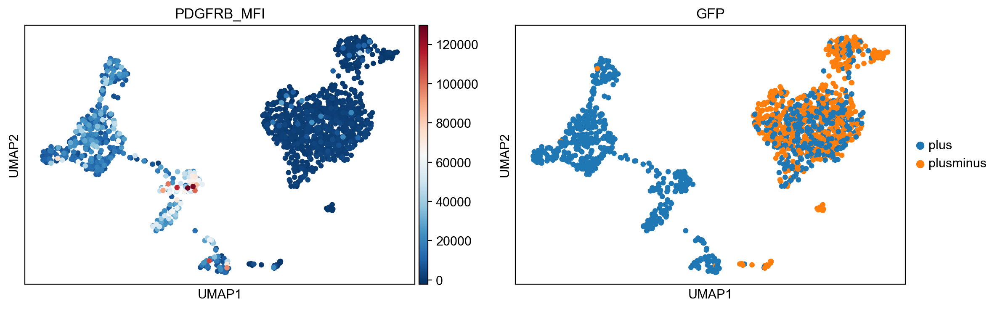

In [54]:
sc.pl.umap(adata, color=['PDGFRB_MFI', 'GFP'])

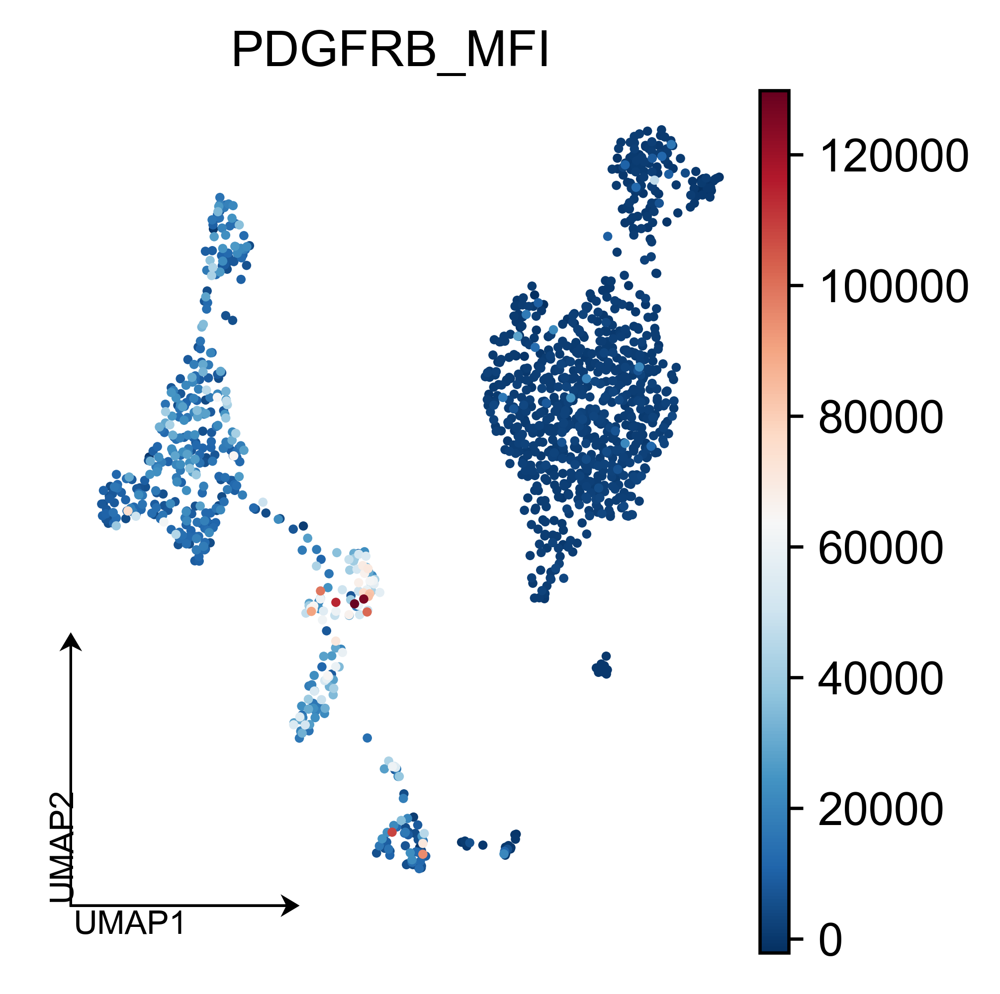

In [136]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata, 'PDGFRB_MFI', size=dotsize, alpha=alpha, fontsize=fontsize, fig_dir=fig_dir, legend_loc='upper_right')

In [140]:
adata.uns['GFP_colors'] = ['#64BF73', '#D81B60']

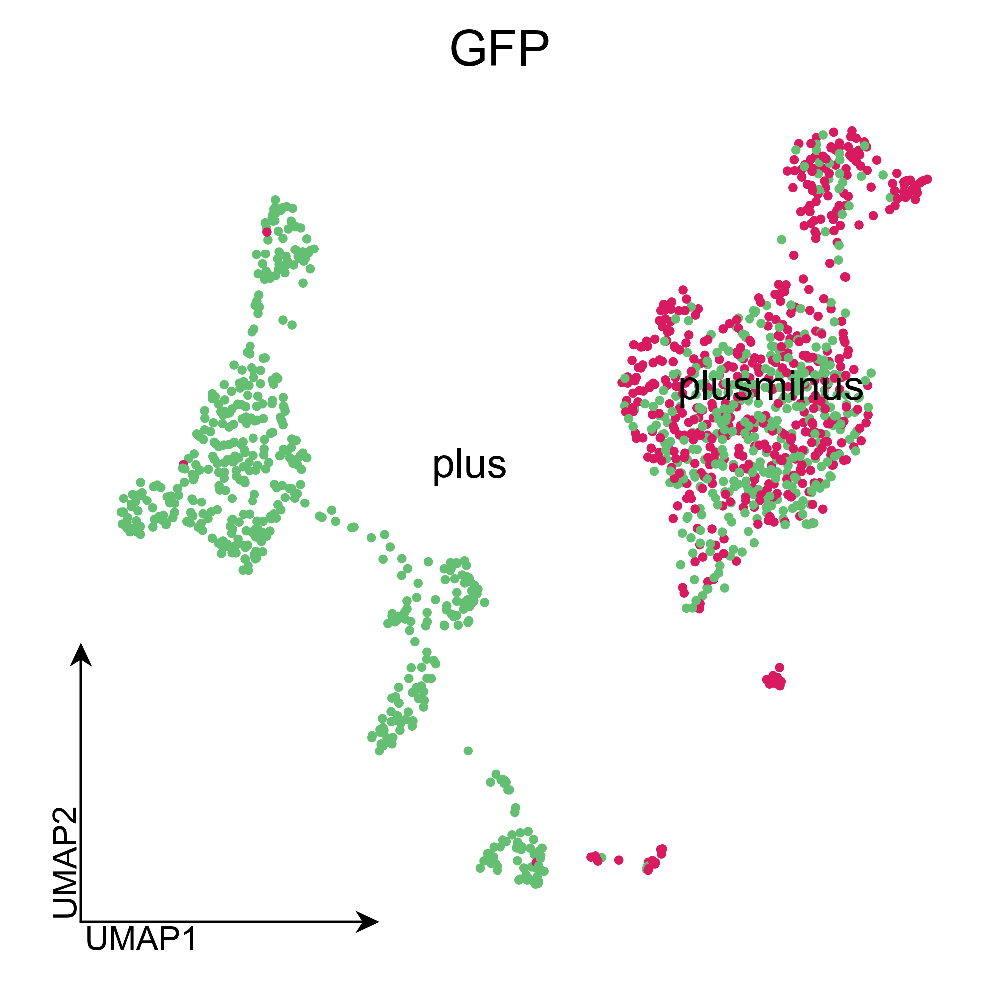

In [142]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata, 'GFP', size=dotsize, alpha=alpha, fontsize=fontsize, fig_dir=fig_dir, legend_loc='upper_right')

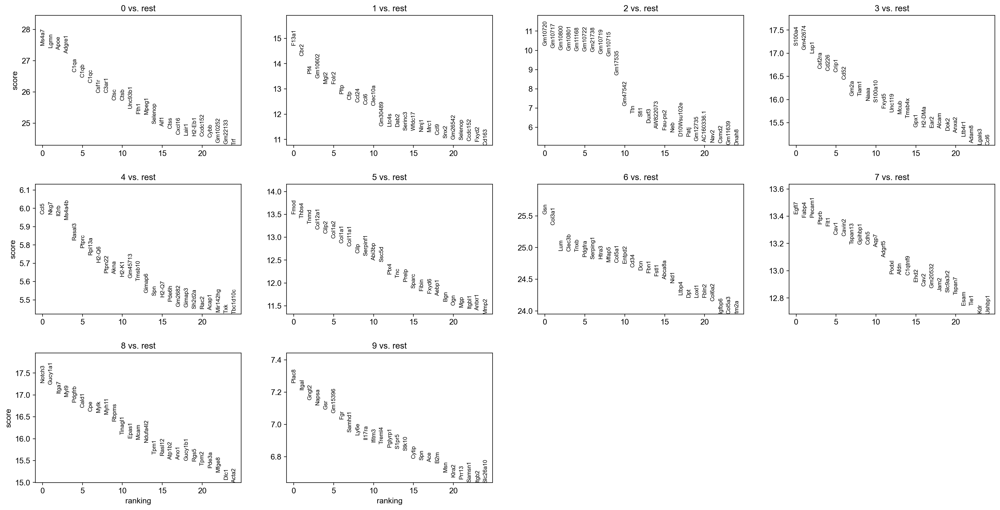

In [55]:
sc.tl.rank_genes_groups(adata, 'cluster', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key="wilcoxon")

In [56]:
import anndata as ad
adata_nongm = adata[:, ~adata.var_names.str.startswith('Gm')]
adata_nongm.raw = ad.AnnData(X=adata_nongm.raw[:, ~adata_nongm.raw.var_names.str.startswith('Gm')].X, var=adata_nongm.raw[:, ~adata_nongm.raw.var_names.str.startswith('Gm')].var)

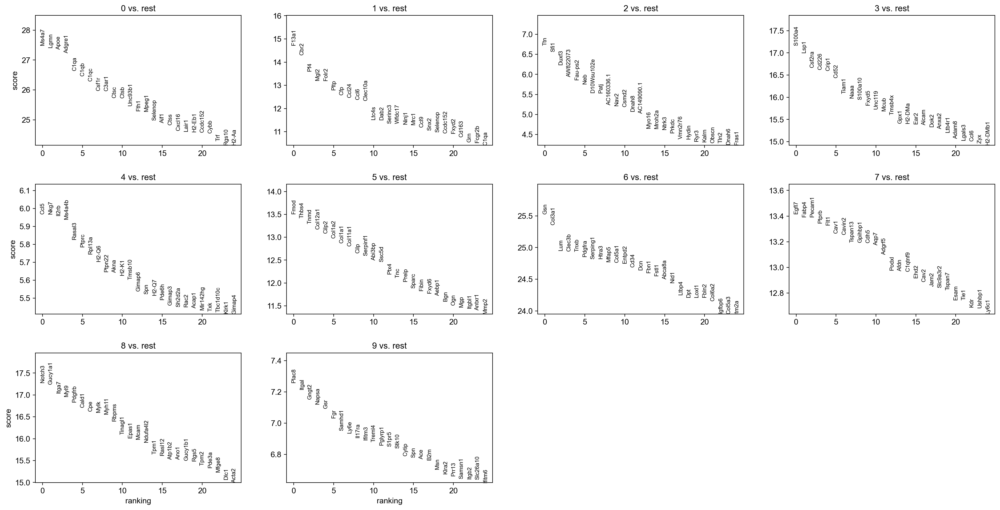

In [57]:
sc.tl.rank_genes_groups(adata_nongm, 'cluster', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata_nongm, n_genes=25, sharey=False, key="wilcoxon")

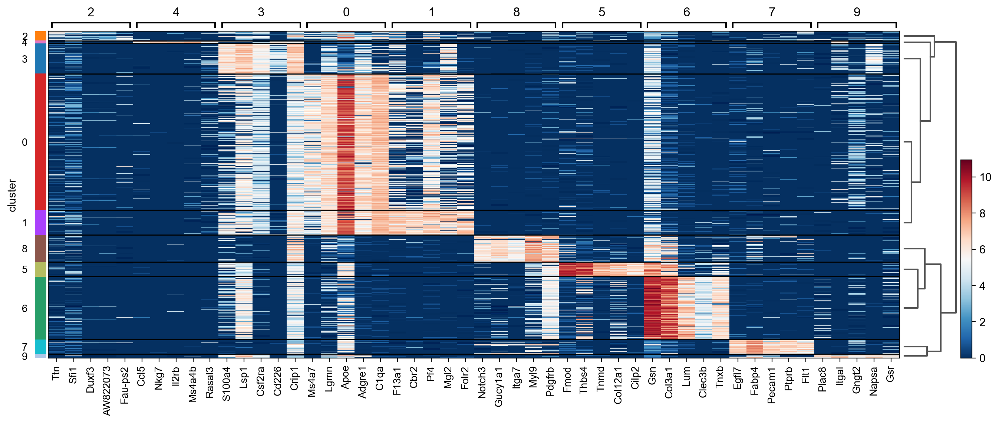

In [80]:
heatmap = sc.pl.rank_genes_groups_heatmap(adata_nongm, n_genes=5, key="wilcoxon", groupby="cluster", show_gene_labels=True, save=True)

In [79]:
heatmap

{'heatmap_ax': <AxesSubplot:>,
 'groupby_ax': <AxesSubplot:ylabel='cluster'>,
 'dendrogram_ax': <AxesSubplot:>,
 'gene_groups_ax': <AxesSubplot:>}

In [65]:
adata.raw.shape

(1425, 38178)

In [72]:
sc.tl.rank_genes_groups(adata, groupby="cluster", use_raw=True, method='wilcoxon')

In [73]:
for cl in adata.obs['cluster'].cat.categories:
    df = sc.get.rank_genes_groups_df(adata, group=cl, pval_cutoff=1e-05)
    df.to_csv(csv_dir + '%s_vs_rest.with_gm.sig_genes.csv' %cl, index=False)

In [75]:
sc.tl.rank_genes_groups(adata_nongm, groupby="cluster", use_raw=True, method='wilcoxon')

In [76]:
for cl in adata_nongm.obs['cluster'].cat.categories:
    df = sc.get.rank_genes_groups_df(adata_nongm, group=cl, pval_cutoff=1e-05)
    df.to_csv(csv_dir + '%s_vs_rest.sig_genes.csv' %cl, index=False)

In [127]:
adata_d21_subset = adata_d21[adata_d21.obs['cluster'].isin(['0', '1', '2', '8'])]

In [128]:
sc.tl.draw_graph(adata_d21_subset)

Trying to set attribute `.uns` of view, copying.


In [129]:
sc.tl.paga(adata_d21_subset, groups='cluster')

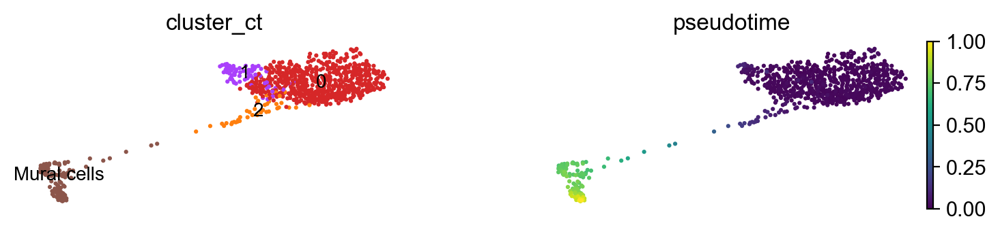

In [132]:
adata_d21_subset.uns['iroot'] = np.flatnonzero(adata_d21_subset.obs['cluster_ct'] == '0')[0]
sc.tl.diffmap(adata_d21_subset)
sc.tl.dpt(adata_d21_subset)
adata_d21_subset.obs['pseudotime'] = adata_d21_subset.obs['dpt_pseudotime']
with plt.rc_context({"figure.figsize": (3.5, 1.6), 'figure.frameon':False}):
    graph_fa = sc.pl.draw_graph(adata_d21_subset, color=['cluster_ct', 'pseudotime'], legend_loc='on data', color_map='viridis',
                 frameon=False, size=20, legend_fontsize='small', legend_fontweight='light', layout='fa', return_fig=True)
    graph_fa.savefig(fig_dir + 'draw_graph_fa.subset.pdf', bbox_inches='tight')

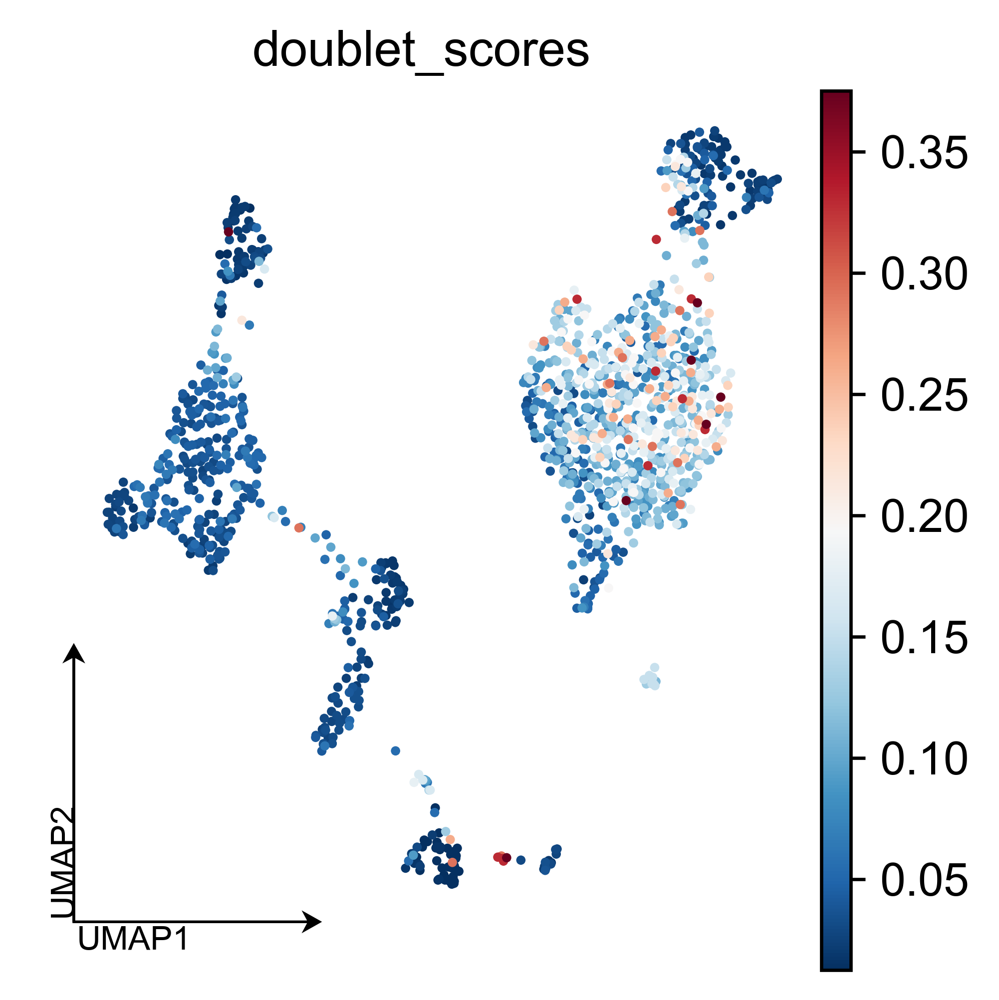

In [135]:
with plt.rc_context({"figure.figsize": (3.5, 3.5), "figure.dpi": 300, "figure.frameon": False}):
    plot_umap(adata, 'doublet_scores', size=dotsize, alpha=alpha, fontsize=fontsize, fig_dir=fig_dir, legend_loc='upper_right')